---
# Trabajo Practico N°1 - Mineria de Datos
### Tecnicatura Universitaria en Inteligencia Artificial 
#### FCEIA-UNR
### AÑO 2025, 1er cuatrimestre
### Integrantes:
- **Frattini, Gianfranco**
- **Gallardo, Jonatan**

---


---

# LIBRERIAS UTILIZADAS

---

In [3]:
#############
# LIBRERIAS #
#############

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import Isomap
from sklearn.manifold import TSNE
import time
import os
from matplotlib.colors import Normalize


---
# Ejercicio 1
Descargar un conjunto de datos, dxCrop_Soil.csv1, para realizar el trabajo práctico.
Realizar un análisis exploratorio de datos: visualizar distribuciones, valores faltantes, 
correlaciones, etc. Limpiar el conjunto de datos (manejar valores faltantes, eliminar 
outliers) si es necesario. Codificar variables categóricas (si es necesario). Normalizar o 
estandarizar las características. La variable tipoCultivo es nuestro objetivo.

---

## CARGAR CSV

In [4]:
#########################
# CARGA DEL ARCHIVO CSV #
#########################

# Leer el archivo CSV
file_path = r"./dxCrop_Soil.csv"

# Leer el archivo CSV
df_crude = pd.read_csv(file_path)

# Mostrar las primeras 5 filas del dataset
print("Primeras 5 filas del dataset:")
print(df_crude.head())

# Mostrar información general del dataset
print("\nInformacion del dataset:")
print(f"Numero de filas: {df_crude.shape[0]}")
print(f"Numero de columnas: {df_crude.shape[1]}")
print("\nNombres de las columnas:")
print(df_crude.columns.tolist())

# Mostrar estadísticas básicas
print("\nEstadisticas basicas:")
print(df_crude.describe())

Primeras 5 filas del dataset:
   temperatura  humedad  aguaEnSuelo  tipoSuelo tipoCultivo  nitrogeno  \
0         26.0     52.0         38.0    Arenoso        Maiz         37   
1         29.0     52.0         45.0     Franco  CañaAzucar         12   
2         34.0     65.0         62.0      Negro     Algodon          7   
3         32.0     62.0         34.0       Rojo      Tabaco         22   
4         28.0     54.0         46.0  Arcilloso     Arrozal         35   

   potasio  fosforo nombreFertilizante  
0        0        0               Urea  
1        0       36                DAP  
2        9       30           14-35-14  
3        0       20              28-28  
4        0        0               Urea  

Informacion del dataset:
Numero de filas: 8000
Numero de columnas: 9

Nombres de las columnas:
['temperatura', 'humedad', 'aguaEnSuelo', 'tipoSuelo', 'tipoCultivo', 'nitrogeno', 'potasio', 'fosforo', 'nombreFertilizante']

Estadisticas basicas:
       temperatura      humedad  

---
**Tenemos 9 columnas en nuestro dataset, de las cuales 8 son variables a analizar y 1 es la variable a predecir (tipoCultivo).**

**La cantidad de datos del dataframe es de 8000**

**El tipo de dato de las columnas es:**
- temperatura: cuantitativa continua
- humedad: cuantitativa continua
- aguaEnSuelo: cuantitativa continua
- tipoSuelo: cualitativa nominal
- tipoCultivo: cualitativa nominal
- nitrogeno: cuantitativa continua
- potasio: cuantitativa continua
- fosforo: cuantitativa continua
- nombreFertilizante: cualitativa nominal
---



## NULLS DATAFRAME

temperatura           0
humedad               0
aguaEnSuelo           0
tipoSuelo             0
tipoCultivo           0
nitrogeno             0
potasio               0
fosforo               0
nombreFertilizante    0
dtype: int64
Porcentaje de valores NaN por columna:
temperatura           0.0
humedad               0.0
aguaEnSuelo           0.0
tipoSuelo             0.0
tipoCultivo           0.0
nitrogeno             0.0
potasio               0.0
fosforo               0.0
nombreFertilizante    0.0
dtype: float64


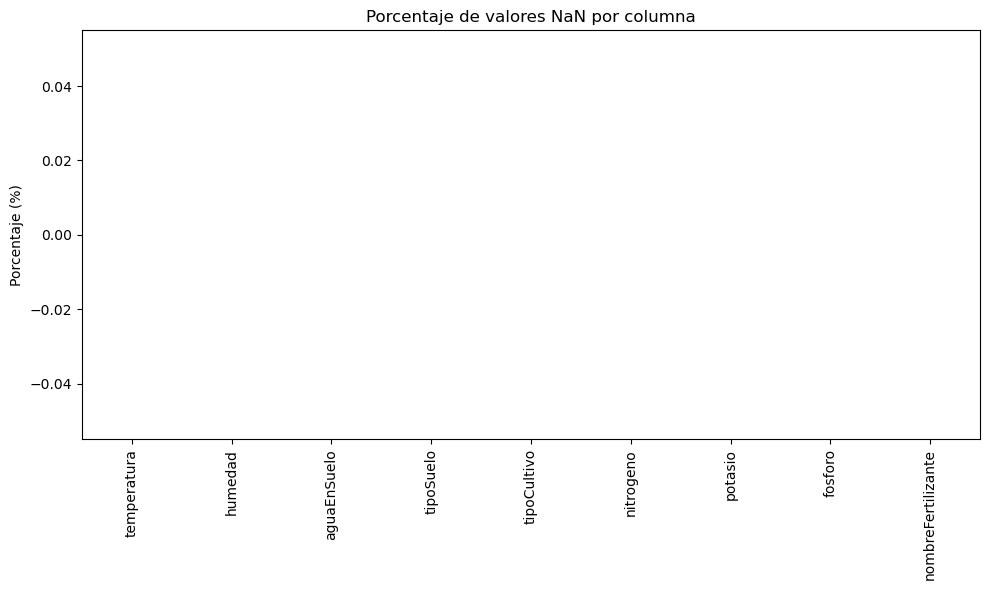

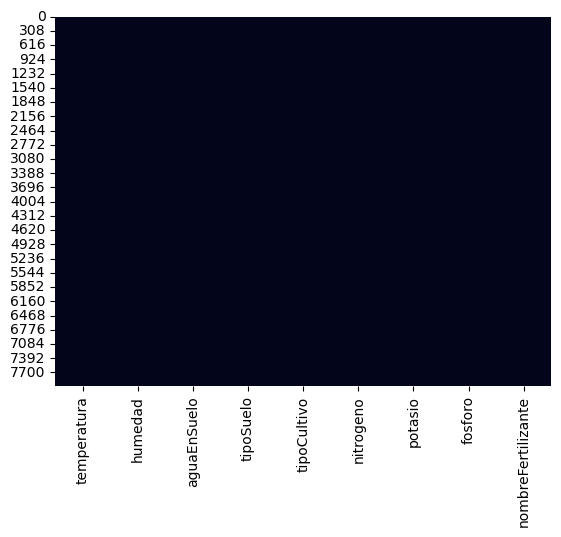

In [5]:
############################
# INTEGRIDAD DEL DATAFRAME #
############################

# Cantidad total de nulos
print(df_crude.isnull().sum())

# Calcular y mostrar el porcentaje de valores NaN por columna
missing_percentage = df_crude.isnull().mean() * 100
print("Porcentaje de valores NaN por columna:")
print(missing_percentage.sort_values(ascending=False))

# Visualizar el porcentaje de valores NaN por columna
plt.figure(figsize=(10, 6))
missing_percentage.sort_values().plot(kind='bar')
plt.title('Porcentaje de valores NaN por columna')
plt.ylabel('Porcentaje (%)')
plt.tight_layout()
plt.show()

# Realizar un heatmap de los NaN del dataset
sns.heatmap(df_crude.isnull(), cbar=False)
plt.show()

---

**El dataset que se esta utilizando no posee ningun valor nulo.**

---

## ANALISIS DE VARIABLES

In [6]:
def analyze_variable(df, column_name, figsize=(15, 12), save_path=None):
    """
    Analizar una variable (columna) de un DataFrame y generar las graficas para entender la distribucion
    
    Argumentos:
    -----------
    df : dataframe utilizado
    column_name : Nombre de la columna a analizar
    figsize : Tamaño de la figura para agregar las graficas
    save_path : Ruta donde guardar la figura (opcional)
    """
    
    # Analizar si la columna existe en el DataFrame
    if column_name not in df.columns:
        print(f"La columna '{column_name}' no se encuentra en el dataframe")
        return
    
    # Crear la figura con 5 subplots (4 graficos + 1 tabla)
    fig, axes = plt.subplots(3, 2, figsize=figsize, gridspec_kw={'height_ratios': [1, 1, 0.5]})
    fig.suptitle(f'Analisis de {column_name}', fontsize=16)
    
    # Obtener informacion de la columna
    data = df[column_name]
    
    # Analizar si la columna es numerica o categorica
    is_numeric = pd.api.types.is_numeric_dtype(data)
    
    # Estadisticas basicas
    print(f"Estadisticas de la columna: {column_name}:")
    if is_numeric:
        stats_data = data.describe()
        print(stats_data)
    else:
        print(f"Cantidad: {data.count()}")
        print(f"Valores unicos: {data.nunique()}")
        print(f"Valor mas repetido: {data.value_counts().index[0]} (aparece {data.value_counts().iloc[0]} veces)")
        print(f"Valores faltantes: {data.isna().sum()} ({data.isna().mean()*100:.2f}%)") #Esperamos que sean 0, ya que el dataframe esta limpio
    
    # Plot 1: Grafica de distribucion para datos numericos con KDE o barras para categoricas
    if is_numeric:
        sns.histplot(data, kde=True, ax=axes[0, 0])
        axes[0, 0].set_title(f'Distribucion de {column_name}')
        axes[0, 0].set_xlabel(column_name)
        axes[0, 0].set_ylabel('Frecuencia')
    else:
        # Para datos categoricos, mostrar solo los primeros 10 valores
        value_counts = data.value_counts().head(10)
        sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0, 0])
        axes[0, 0].set_title(f'Top 10 categorias en {column_name}')
        axes[0, 0].set_xlabel(column_name)
        axes[0, 0].set_ylabel('Cantidad')
        axes[0, 0].tick_params(axis='x', rotation=45)
    
    # Plot 2: Box plot para datos numericos o torta para categoricas con 5 categorias top y "Otros" para el resto de las categoricas
    if is_numeric:
        sns.boxplot(y=data, ax=axes[0, 1])
        axes[0, 1].set_title(f'Boxplot de {column_name}')
        axes[0, 1].set_ylabel(column_name)
    else:
        # Grafico de torta para top 5 categorias
        top_5 = data.value_counts().head(5)
        others = data.value_counts().sum() - top_5.sum()
        if others > 0:
            top_5['Otros'] = others
        axes[0, 1].pie(top_5, labels=top_5.index, autopct='%1.1f%%')
        axes[0, 1].set_title(f'Top 5 categorias en {column_name}')
    
    # Plot 3: Visualiazcion de valores faltantes en el dataset
    missing = data.isna()
    axes[1, 0].bar(['Presentes', 'Faltantes'], [len(data) - missing.sum(), missing.sum()])
    axes[1, 0].set_title(f'Valores faltantes en {column_name}')
    axes[1, 0].set_ylabel('Cantidad')
    
    # Plot 4: Informacion adicional para datos numericos o acumulativa para categoricas
    if is_numeric:
        # QQ plot para datos numericos
        from scipy import stats
        stats.probplot(data.dropna(), plot=axes[1, 1])
        axes[1, 1].set_title(f'QQ Plot de {column_name}')
    else:
        # Porcentaje acumulativo de categorias
        cum_pct = data.value_counts().sort_values(ascending=False).cumsum() / data.count() * 100
        cum_pct = cum_pct.reset_index()
        cum_pct.columns = [column_name, 'Porcentaje Acumulado']
        
        # Plot de todas las categorias
        sns.lineplot(x=range(len(cum_pct)), y=cum_pct['Porcentaje Acumulado'], ax=axes[1, 1], marker='o')
        axes[1, 1].set_xticks(range(len(cum_pct)))
        axes[1, 1].set_xticklabels(cum_pct[column_name], rotation=90)
        axes[1, 1].set_title('Porcentaje acumulado de categorias')
        axes[1, 1].set_ylabel('Porcentaje acumulado')
        axes[1, 1].set_xlabel(column_name)
    
    # Añadir tabla con estadísticas
    axes[2, 0].axis('off')
    axes[2, 1].axis('off')
    
    # Crear tabla de estadísticas
    if is_numeric:
        stats_dict = {
            'Estadística': ['Media', 'Mediana', 'Desv. Estándar', 'Mínimo', 'Máximo', 'Valores faltantes', '% faltantes'],
            'Valor': [
                f"{data.mean():.4f}",
                f"{data.median():.4f}",
                f"{data.std():.4f}",
                f"{data.min():.4f}",
                f"{data.max():.4f}",
                f"{data.isna().sum()}",
                f"{data.isna().mean()*100:.2f}%"
            ]
        }
    else:
        stats_dict = {
            'Estadística': ['Total valores', 'Valores únicos', 'Valor más común', 'Frecuencia más común', 'Valores faltantes', '% faltantes'],
            'Valor': [
                f"{data.count()}",
                f"{data.nunique()}",
                f"{data.value_counts().index[0]}",
                f"{data.value_counts().iloc[0]}",
                f"{data.isna().sum()}",
                f"{data.isna().mean()*100:.2f}%"
            ]
        }
    
    # Crear tabla
    table = axes[2, 0].table(
        cellText=[[stats_dict['Valor'][i]] for i in range(len(stats_dict['Valor']))],
        rowLabels=stats_dict['Estadística'],
        colLabels=['Valor'],
        loc='center',
        cellLoc='center'
    )
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1, 1.5)
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  
    
    # Guardar la figura si se proporciona una ruta
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Figura guardada en: {save_path}")
    
    plt.show()
    
    # Devuelve data numerica calculada y categorica calculada de ser necesaria
    if is_numeric:
        return {
            'mean': data.mean(),
            'median': data.median(),
            'std': data.std(),
            'min': data.min(),
            'max': data.max(),
            'missing': data.isna().sum(),
            'missing_pct': data.isna().mean() * 100
        }
    else:
        return {
            'unique_count': data.nunique(),
            'most_common': data.value_counts().index[0],
            'most_common_count': data.value_counts().iloc[0],
            'missing': data.isna().sum(),
            'missing_pct': data.isna().mean() * 100
        }

Estadisticas de la columna: temperatura:
count    8000.000000
mean       30.338895
std         4.478262
min        20.000000
25%        27.050000
50%        30.240000
75%        33.460000
max        40.000000
Name: temperatura, dtype: float64
Figura guardada en: ./temperatura.png


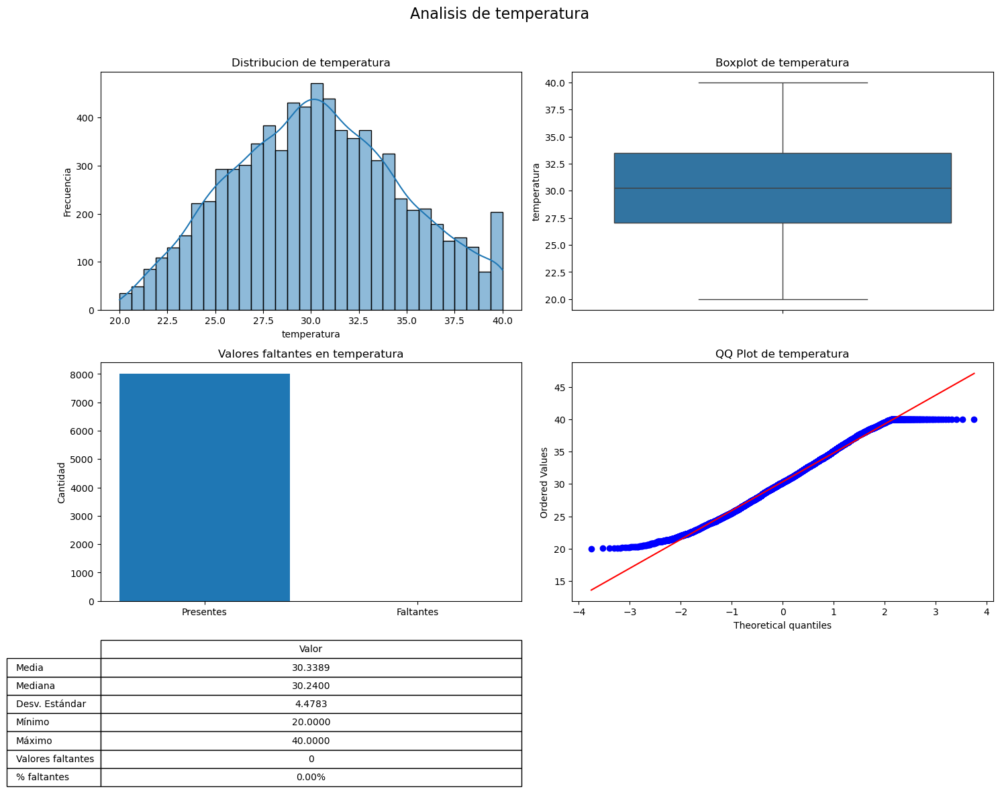

Estadisticas de la columna: humedad:
count    8000.000000
mean       59.210731
std         8.177366
min        40.020000
25%        53.277500
50%        59.110000
75%        65.082500
max        80.000000
Name: humedad, dtype: float64
Figura guardada en: ./humedad.png


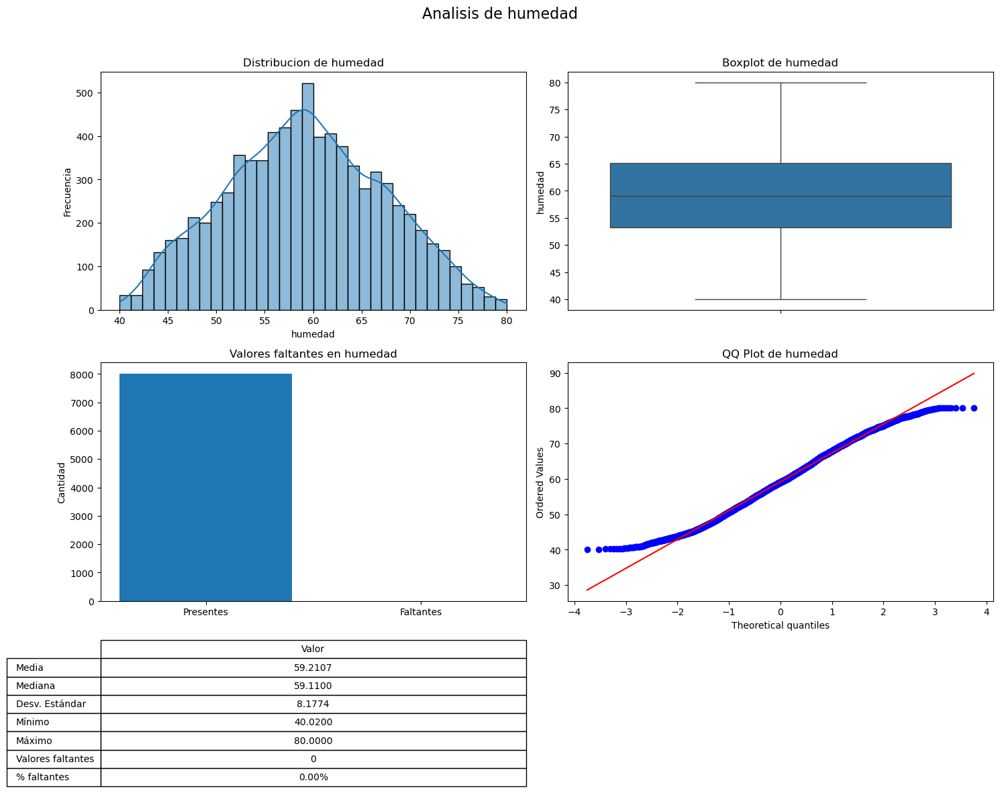

Estadisticas de la columna: aguaEnSuelo:
count    8000.000000
mean       43.580862
std        12.596156
min        20.000000
25%        33.967500
50%        42.250000
75%        52.950000
max        70.000000
Name: aguaEnSuelo, dtype: float64
Figura guardada en: ./aguaEnSuelo.png


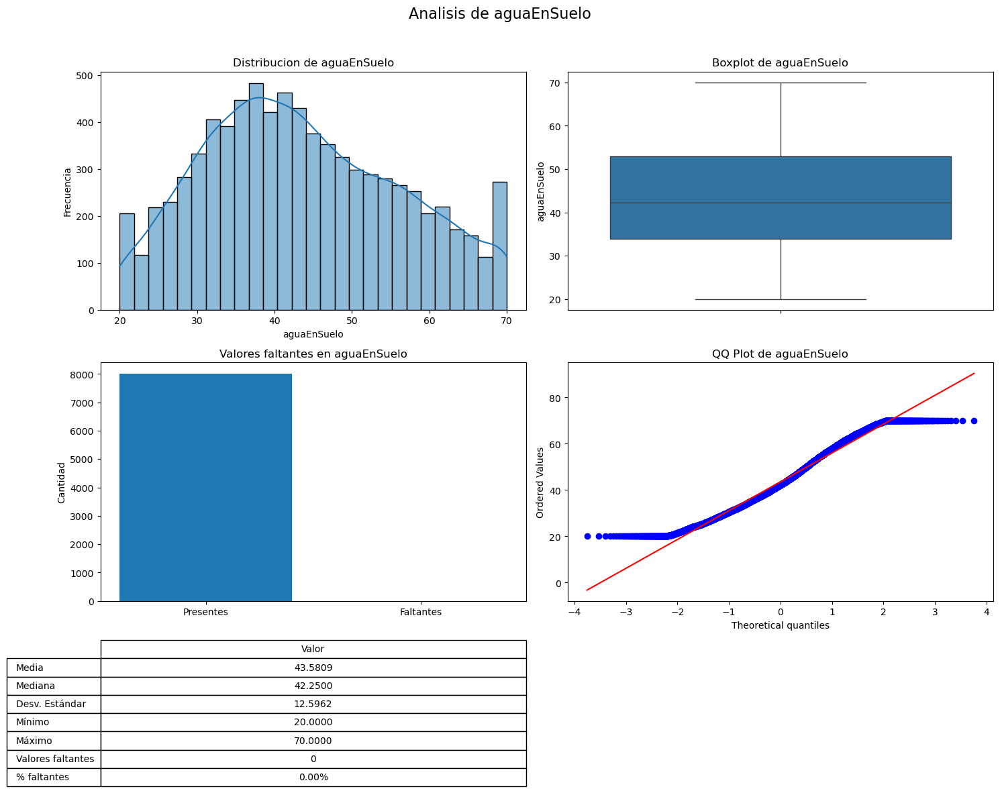

Estadisticas de la columna: tipoSuelo:
Cantidad: 8000
Valores unicos: 5
Valor mas repetido: Arcilloso (aparece 1623 veces)
Valores faltantes: 0 (0.00%)
Figura guardada en: ./tipoSuelo.png


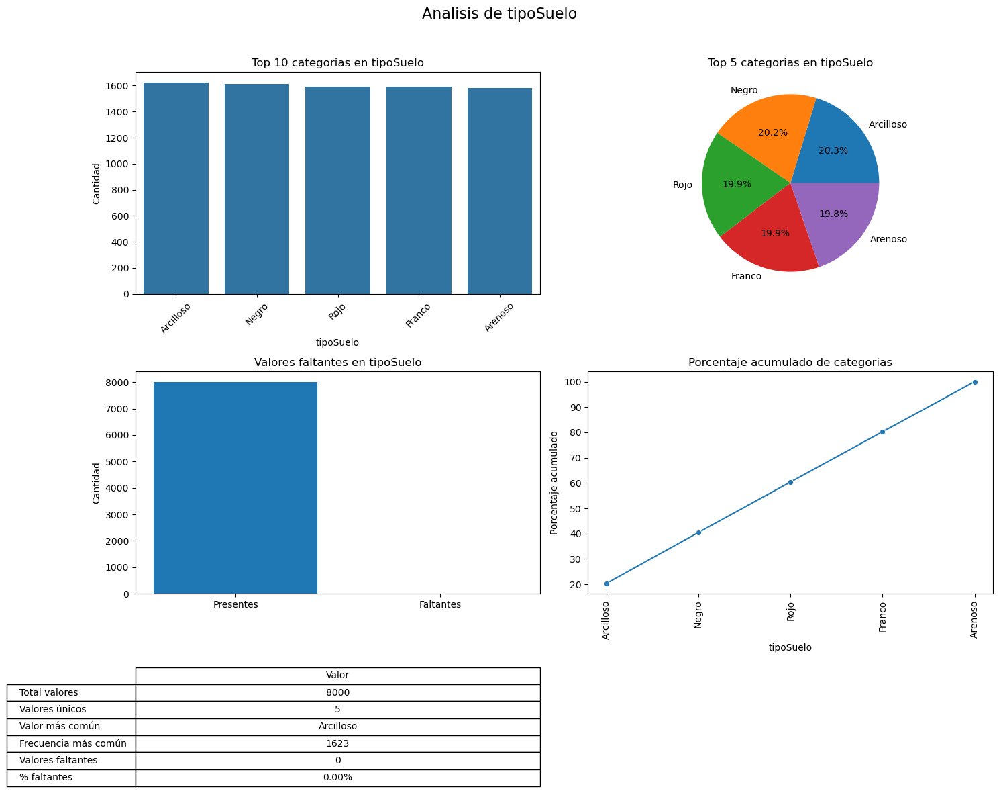

Estadisticas de la columna: tipoCultivo:
Cantidad: 8000
Valores unicos: 11
Valor mas repetido: CañaAzucar (aparece 763 veces)
Valores faltantes: 0 (0.00%)
Figura guardada en: ./tipoCultivo.png


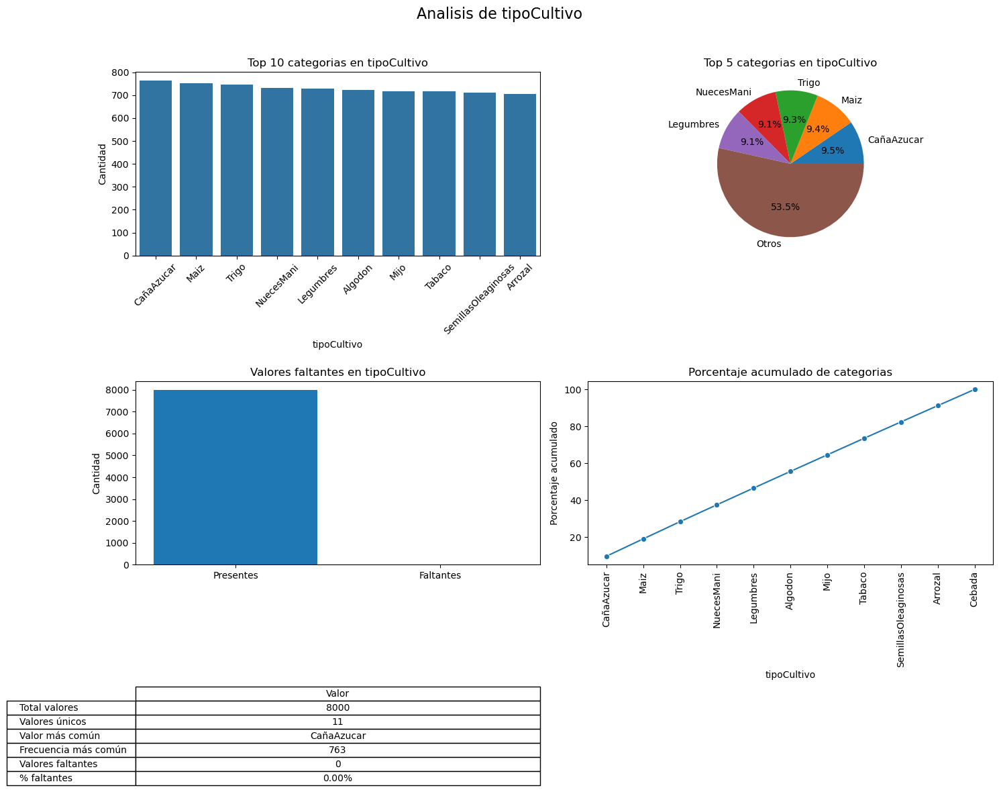

Estadisticas de la columna: nitrogeno:
count    8000.000000
mean       18.429125
std        11.852406
min         0.000000
25%         9.000000
50%        14.000000
75%        26.000000
max        46.000000
Name: nitrogeno, dtype: float64
Figura guardada en: ./nitrogeno.png


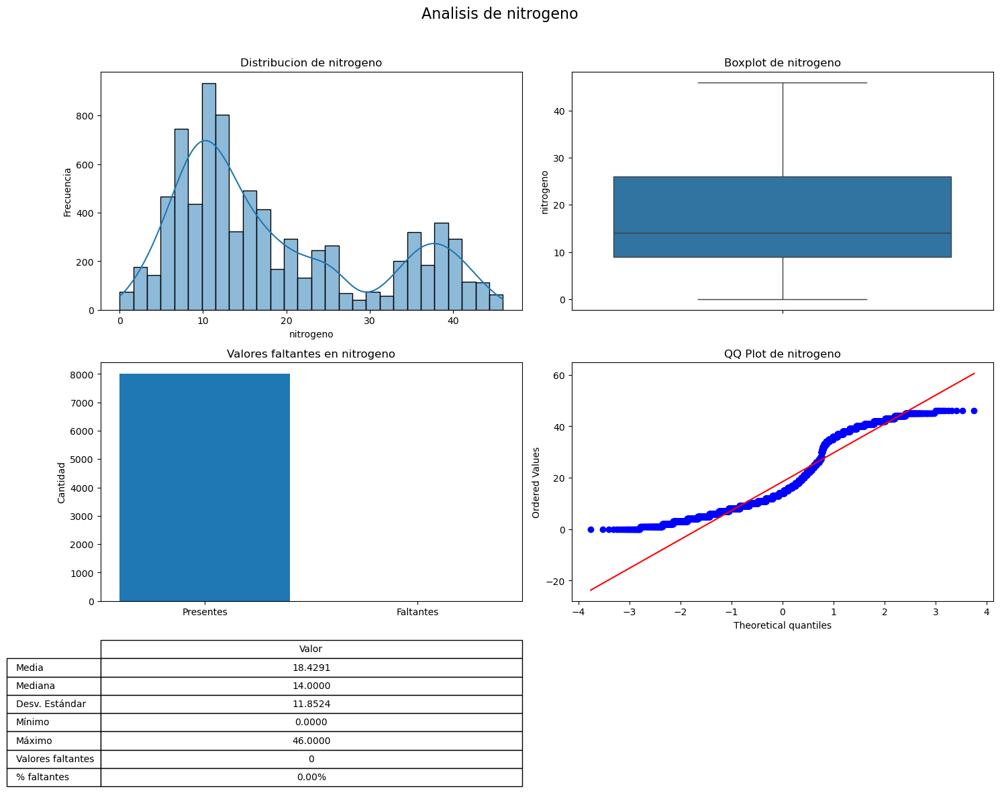

Estadisticas de la columna: potasio:
count    8000.000000
mean        3.916375
std         5.494807
min         0.000000
25%         0.000000
50%         1.000000
75%         5.000000
max        23.000000
Name: potasio, dtype: float64
Figura guardada en: ./potasio.png


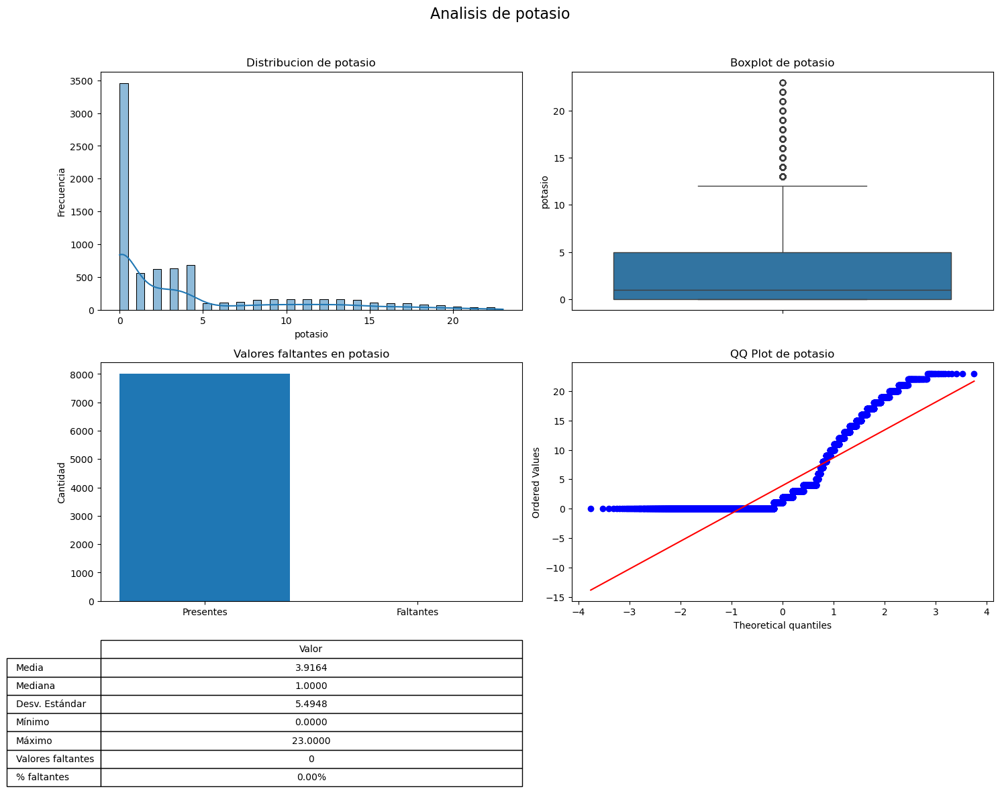

Estadisticas de la columna: fosforo:
count    8000.000000
mean       18.512500
std        13.244113
min         0.000000
25%         8.000000
50%        18.000000
75%        30.000000
max        46.000000
Name: fosforo, dtype: float64
Figura guardada en: ./fosforo.png


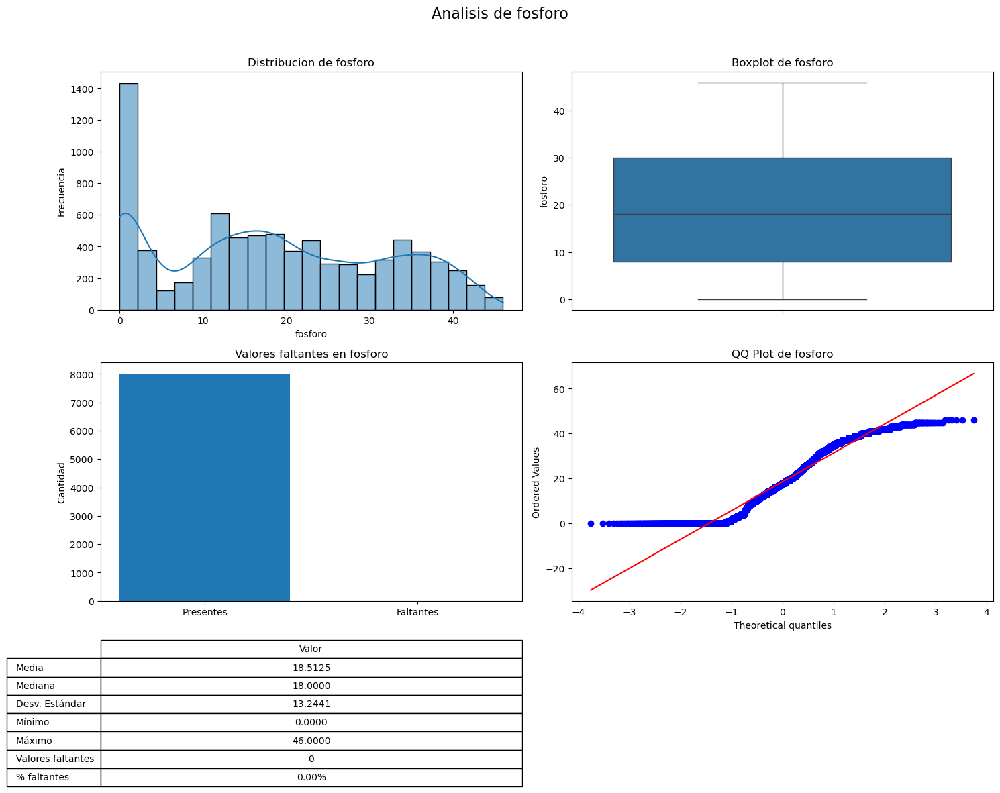

Estadisticas de la columna: nombreFertilizante:
Cantidad: 8000
Valores unicos: 7
Valor mas repetido: 14-35-14 (aparece 1188 veces)
Valores faltantes: 0 (0.00%)
Figura guardada en: ./nombreFertilizante.png


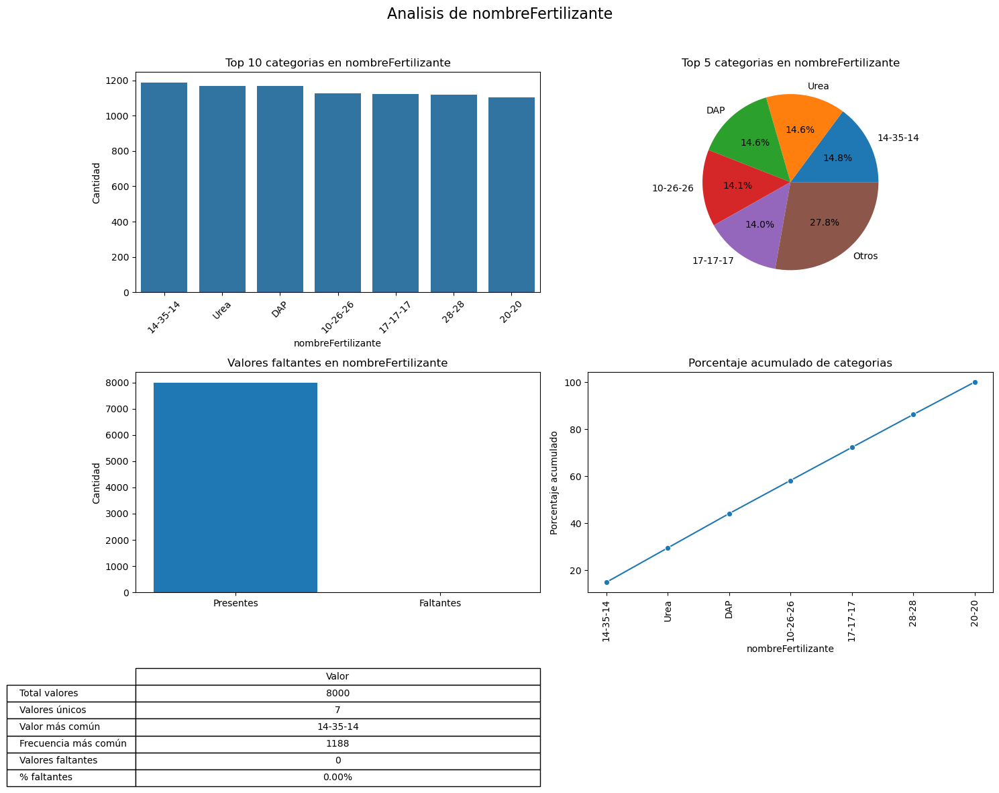

In [7]:
for i in df_crude.columns:
    path=f"./{i}.png"
    analyze_variable(df_crude, i, save_path=path)

---
**TEMPERATURA:**
- Tiene distribucion normal, grafica de distribucion de temperatura y de acuerdo al QQ-plot, con media de 30.34 y desviacion estandar de 4.48
- Satura en el valor maximo de 40 grados, lo cual se ve en la distribucion y en el QQ-plot, lo cual podria implicar que temperaturas mayores a 40 grados fueron imputadas como 40 grados. Esto explicaria el aumento de la cantidad de datos en el valor maximo de 40 grados.
- El valor minimo de temperatura es de 20 grados, sin embargo este mantiene la distribucion normal, lo que implica que los valores menores a 20 grados no fueron imputados.
- A partir del grafico de boxplot, y la distribucion de datos, podemos considerar que no hay presencia de outliers.

**HUMEDAD:**
- Tiene distribucion normal, grafica de distribucion de humedad y de acuerdo al QQ-plot, con media de 59.21 y desviacion estandar de 8.18
- No es una grafica que en el QQ-Plot se vea que sature, y la distribucion normal se conserva sin anomalias.
- El valor minimo es de 40.02 y el maximo es de 80
- A partir del grafico de boxplot, y la distribucion de datos, podemos considerar que no hay presencia de outliers.

**AGUA EN SUELO:**
- Tiene distribucion normal, grafica de distribucion de agua en suelo y de acuerdo al QQ-plot, con media de 43.58 y desviacion estandar de 12.60
- Es una grafica que en el QQ-Plot se ve que satura en el extremo inferior (minimo: 20) y en el superior (maximo: 70), esto nos indicaria que valores menores de 20 y mayores a 70 fueron imputados, fueron imputados como 20 y 70 respectivamente.
- A partir del grafico de boxplot, y la distribucion de datos, podemos considerar que no hay presencia de outliers.

**TIPO DE SUELO:**
- Tenemos 5 tipos de suelos: Arcilloso,Negro,Rojo,Franco,Arenoso
- La distribucion de estos datos es practicamente uniforme, dando a entender que la variable esta balanceada.
- Todos tienen un porcentaje de aparicion de aproximadamente 20%, siendo el de mayor aparicion el de suelo arcilloso con 20.3%

**TIPO DE CULTIVO: (Target)**
- Tenemos 11 tipos de cultivos, donde destacamos: Trigo, Maiz, Cebada (Que son los utilizados para el subconjunto posterior) y Caña de Azucar por ser el valor mas frecuente.
- La variable esta balanceada, lo que implica que todos los tipos de cultivos tienen un porcentaje de aparicion de aproximadamente 9% y el mas frecuente es el de Caña de Azucar con 9.5%

**NITROGENO:**
- Tiene una distribucion bimodal, es decir que tiene dos maximos locales (Modas). Una en Aproximadamente 10 y la otra en aprox. 37.
- El valor minimo es de 0 y el maximo es de 40.
- El grafico de boxplot nos indica que no hay presencia de outliers.

**POTASIO:**
- Tiene una distribucion asimetrica, con muchos valores en el extremo inferior (minimo: 0) y pocos en el extremo superior (maximo: 23).
- Se puede ver en el grafico de boxplot que hay posible presencia de outliers.

**FOSFORO:**
- No posee distribucion normal
- Su valor minimo es de 0 y el maximo de 46.
- Se puede ver en el grafico de boxplot que no hay presencia de outliers.

**NOMBRE DE FERTILIZANTE:**
- Tenemos 7 tipos de fertilizantes, donde el mas frecuente es el de 14-35-14 con una aparicion de 14.8%.
- La variable esta balanceada, lo que implica que todos los tipos de cultivos tienen un porcentaje de aparicion de aproximadamente 14%.
---

## ANALISIS DE CORRELACION

In [8]:
def analyze_correlations(df, save_path='./Correlacion.png', 
                         graph_path='./Correlacion_grafo.png',
                         threshold=0.3):
    """
    Analiza la correlación entre variables numéricas y genera visualizaciones
    
    Argumentos:
    -----------
    df : DataFrame a analizar
    save_path : Ruta donde guardar la matriz de correlación
    graph_path : Ruta donde guardar el grafo de correlación
    threshold : Umbral de correlación para mostrar en el grafo (valor absoluto)
    """
    
    # Seleccionar solo columnas numéricas
    numeric_df = df.select_dtypes(include=['number'])
    
    # Verificar si hay suficientes columnas numéricas
    if numeric_df.shape[1] < 2:
        print("Se necesitan al menos 2 columnas numéricas para calcular correlaciones.")
        return None
    
    # Calcular la matriz de correlación
    corr_matrix = numeric_df.corr()
    
    # Crear figura para la matriz de correlación (NxN completa)
    plt.figure(figsize=(14, 12))
    
    # Crear un mapa de calor de la matriz de correlación completa (sin máscara triangular)
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    
    sns.heatmap(corr_matrix, cmap=cmap, vmax=1, vmin=-1, center=0,
                square=True, linewidths=.5, annot=True, fmt=".2f", cbar_kws={"shrink": .5})
    
    plt.title('Matriz de Correlación entre Variables Numéricas', fontsize=16)
    plt.tight_layout()
    
    # Guardar la matriz de correlación
    try:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Matriz de correlación guardada en: {save_path}")
    except Exception as e:
        print(f"Error al guardar la matriz de correlación: {e}")
    
    plt.show()
    
    try:
        # Crear un grafo usando NetworkX
        G = nx.Graph()
        
        # Obtener nombres de variables
        variables = corr_matrix.columns
        
        # Añadir nodos al grafo (variables)
        for var in variables:
            G.add_node(var)
        
        # Añadir aristas con pesos basados en la correlación (solo si supera el umbral)
        for i, var1 in enumerate(variables):
            for j, var2 in enumerate(variables):
                if i < j:  # Para evitar duplicados
                    corr_value = abs(corr_matrix.loc[var1, var2])
                    if corr_value >= threshold:
                        G.add_edge(var1, var2, weight=corr_value)
        
        # Verificar si hay aristas en el grafo
        if len(G.edges()) == 0:
            print(f"No se encontraron correlaciones que superen el umbral de {threshold}.")
            print("Intente reducir el valor del umbral.")
            return corr_matrix
        
        # Crear una nueva figura para el grafo
        fig, ax = plt.subplots(figsize=(14, 12))
        
        # Posicionar los nodos
        pos = nx.spring_layout(G, seed=42, k=0.8)  # k controla la distancia entre nodos
        
        # Dibujar nodos
        nx.draw_networkx_nodes(G, pos, node_size=800, node_color='skyblue', alpha=0.8, ax=ax)
        
        # Dibujar etiquetas
        nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold', ax=ax)
        
        # Dibujar aristas con grosor proporcional a la correlación
        edges = G.edges(data=True)
        weights = [data['weight'] * 5 for _, _, data in edges]  # Multiplicar por 5 para hacer más visibles las líneas
        
        # Crear un mapa de colores para las aristas basado en la fuerza de correlación
        norm = Normalize(vmin=threshold, vmax=1)
        edge_colors = [plt.cm.plasma(norm(data['weight'])) for _, _, data in edges]
        
        nx.draw_networkx_edges(G, pos, width=weights, edge_color=edge_colors, alpha=0.7, ax=ax)
        
        # Añadir valores de correlación como etiquetas en las aristas
        edge_labels = {(u, v): f"{d['weight']:.2f}" for u, v, d in edges}
        nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, ax=ax)
        
        ax.set_title('Grafo de Correlaciones entre Variables Numéricas', fontsize=16)
        ax.axis('off')
        
        # Añadir una barra de color para interpretar los valores
        sm = plt.cm.ScalarMappable(cmap=plt.cm.plasma, norm=norm)
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax, shrink=0.8, pad=0.05)  # Especificar el eje para la barra de color
        cbar.set_label('Fuerza de Correlación (valor absoluto)')
        
        plt.tight_layout()
        
        # Guardar el grafo
        plt.savefig(graph_path, dpi=300, bbox_inches='tight')
        print(f"Grafo de correlación guardado en: {graph_path}")
        
    except Exception as e:
        print(f"Error al crear o guardar el grafo de correlación: {e}")
        import traceback
        traceback.print_exc()
    
    plt.show()
    
    return corr_matrix



Matriz de correlación guardada en: ./Correlacion.png


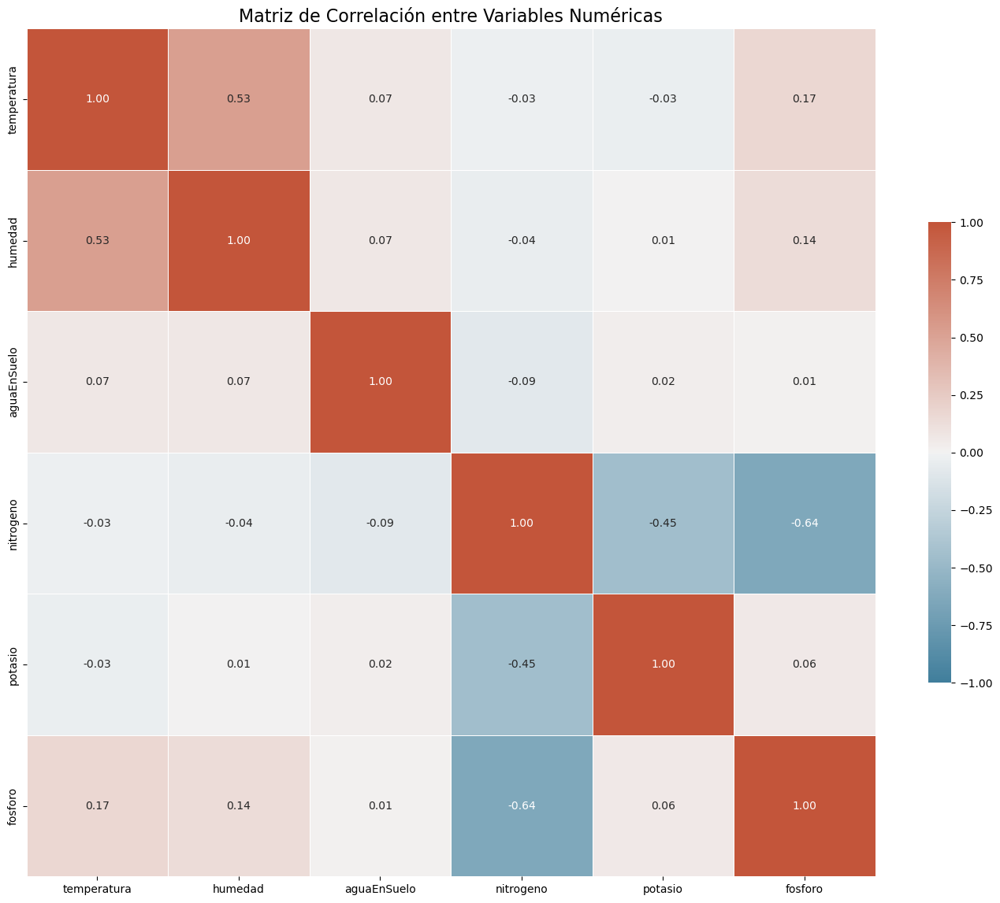

Grafo de correlación guardado en: ./Correlacion_grafo.png


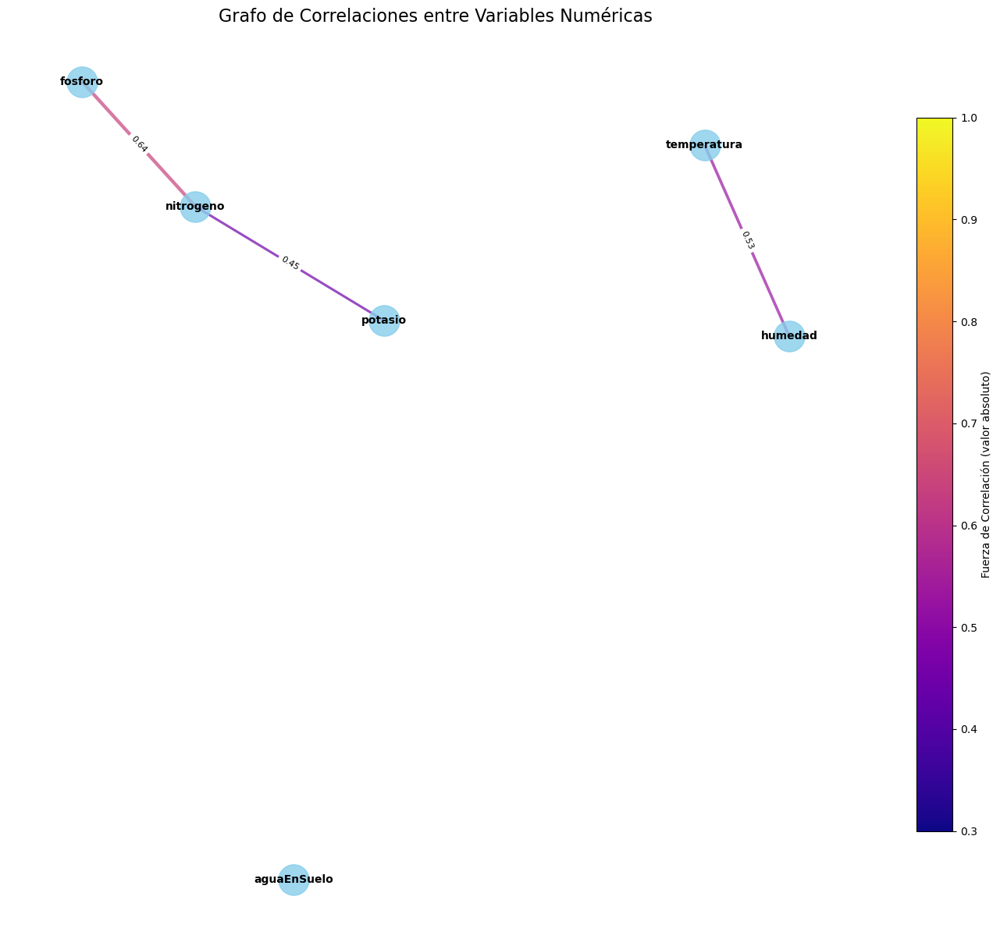

In [9]:
corr_matrix = analyze_correlations(df_crude)

---
**DE ACUERDO AL HEATMAP y AL GRAFO DE CORRELACIONES:** 
- Nitrogeno esta correlacionado con fosforo y potasio, sin embargo potasio y fosforo no tienen correlacion entre si. 
**(Ambas correlaciones negativas)**
- La temperatura y la humedad estan correlacionadas. **(Correlacion positiva)**
- Agua en suelo no esta correlacionada con ninguna otra variable
---

## SEPARAR VARIABLE TARGET

Columnas en el dataset de características:
Index(['temperatura', 'humedad', 'aguaEnSuelo', 'tipoSuelo', 'nitrogeno',
       'potasio', 'fosforo', 'nombreFertilizante'],
      dtype='object')

Información sobre la variable objetivo (tipoCultivo):
Número de clases: 11

Distribución de clases:
tipoCultivo
CañaAzucar             763
Maiz                   753
Trigo                  747
NuecesMani             732
Legumbres              728
Algodon                722
Mijo                   718
Tabaco                 717
SemillasOleaginosas    711
Arrozal                706
Cebada                 703
Name: count, dtype: int64

Distribución porcentual:
tipoCultivo
CañaAzucar             9.5375
Maiz                   9.4125
Trigo                  9.3375
NuecesMani             9.1500
Legumbres              9.1000
Algodon                9.0250
Mijo                   8.9750
Tabaco                 8.9625
SemillasOleaginosas    8.8875
Arrozal                8.8250
Cebada                 8.7875
Name:

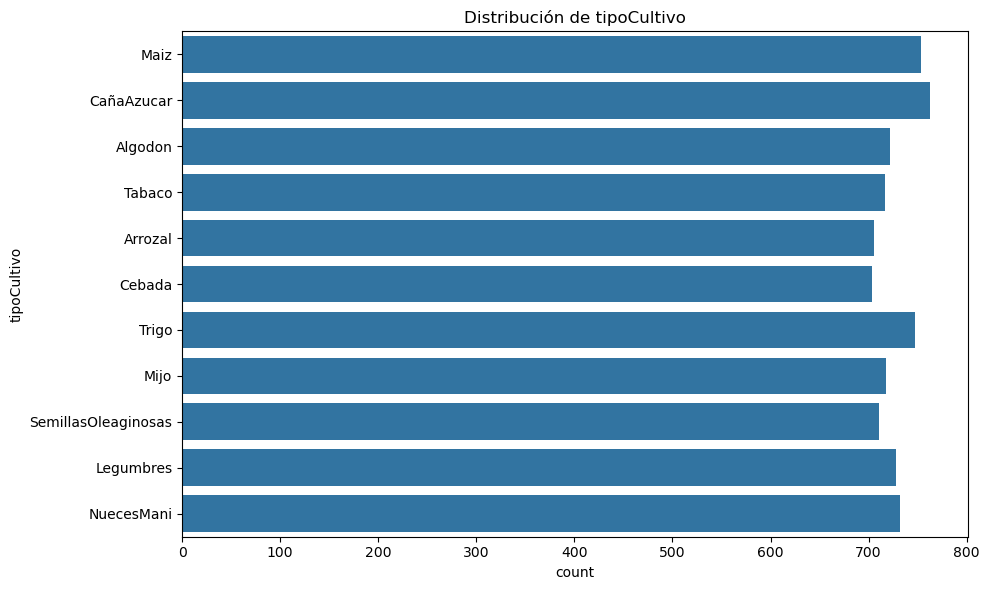

In [10]:
# Separar la variable objetivo (tipoCultivo) del resto del dataset
X = df_crude.drop('tipoCultivo', axis=1)  # Dataset sin la variable a predecir
y = df_crude['tipoCultivo']  # Variable objetivo

# Verificar las columnas restantes en X
print("Columnas en el dataset de características:")
print(X.columns)

# Información básica sobre la variable objetivo
print("\nInformación sobre la variable objetivo (tipoCultivo):")
print(f"Número de clases: {y.nunique()}")
print("\nDistribución de clases:")
print(y.value_counts())
print("\nDistribución porcentual:")
print(y.value_counts(normalize=True) * 100)

# Visualizar la distribución de la variable objetivo
plt.figure(figsize=(10, 6))
sns.countplot(y=y)
plt.title('Distribución de tipoCultivo')
plt.tight_layout()
plt.show()

C:\Users\gfrat\AppData\Local\Temp\ipykernel_23744\1111284964.py:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45)
C:\Users\gfrat\AppData\Local\Temp\ipykernel_23744\1111284964.py:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45)
C:\Users\gfrat\AppData\Local\Temp\ipykernel_23744\1111284964.py:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45)
C:\Users\gfrat\AppData\Local\Temp\ipykernel_23744\1111284964.py:54: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i].set_xtic

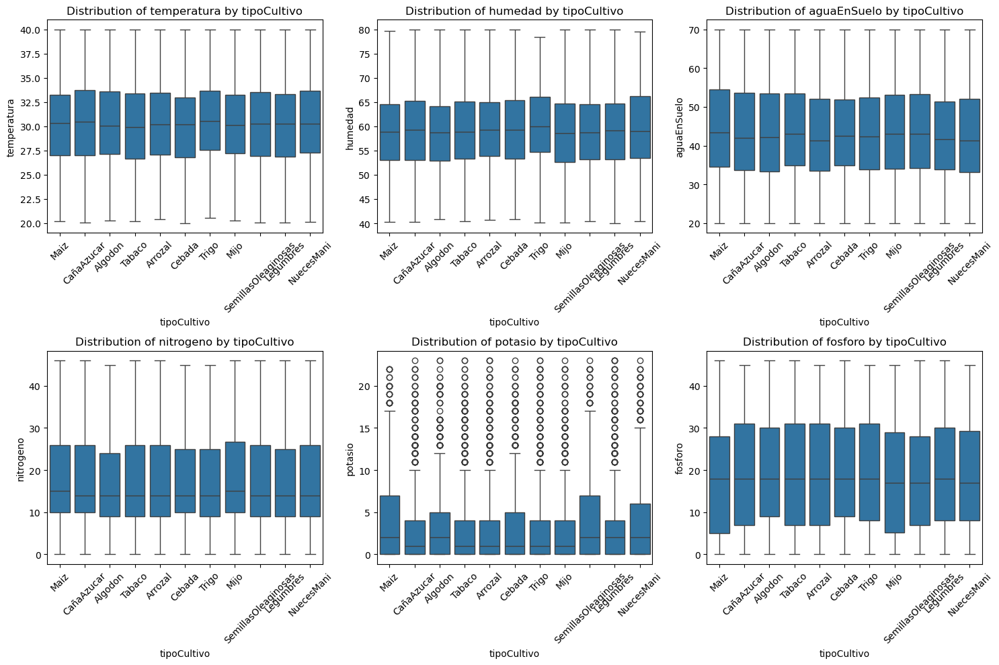


Creating individual boxplots for better visibility:


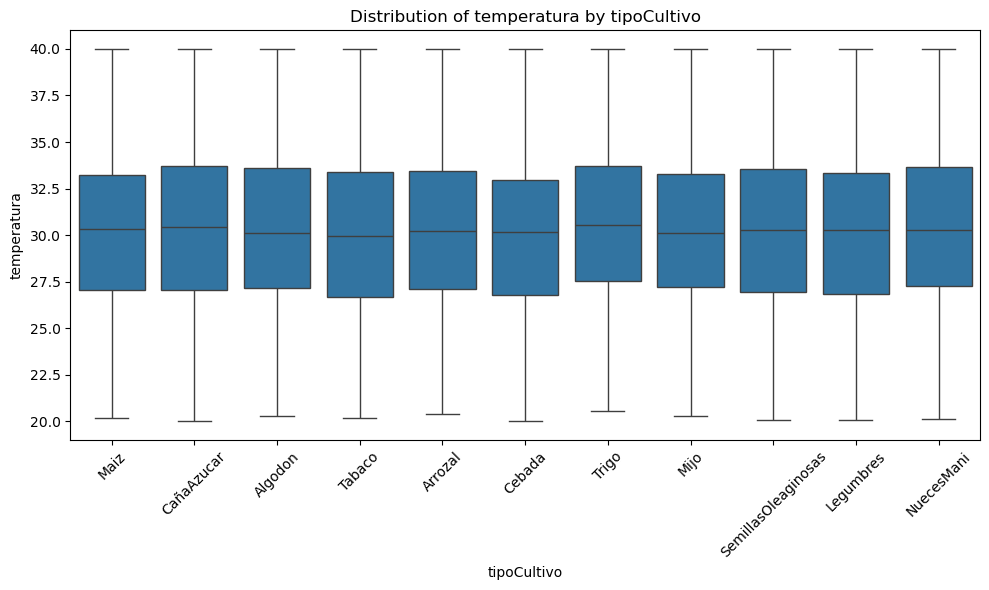


Statistics for temperatura by tipoCultivo:
                     count       mean       std    min      25%     50%  \
tipoCultivo                                                               
Algodon              722.0  30.348906  4.599281  20.27  27.1325  30.090   
Arrozal              706.0  30.328924  4.543571  20.41  27.1025  30.230   
CañaAzucar           763.0  30.485033  4.509073  20.03  27.0250  30.440   
Cebada               703.0  30.198009  4.379935  20.00  26.7950  30.180   
Legumbres            728.0  30.198104  4.535249  20.09  26.8575  30.280   
Maiz                 753.0  30.324157  4.448308  20.18  27.0300  30.310   
Mijo                 718.0  30.287716  4.410623  20.26  27.2100  30.110   
NuecesMani           732.0  30.471189  4.476588  20.14  27.2800  30.295   
SemillasOleaginosas  711.0  30.334107  4.475693  20.05  26.9150  30.280   
Tabaco               717.0  30.138661  4.531899  20.18  26.6800  29.940   
Trigo                747.0  30.590335  4.356556  20.55  

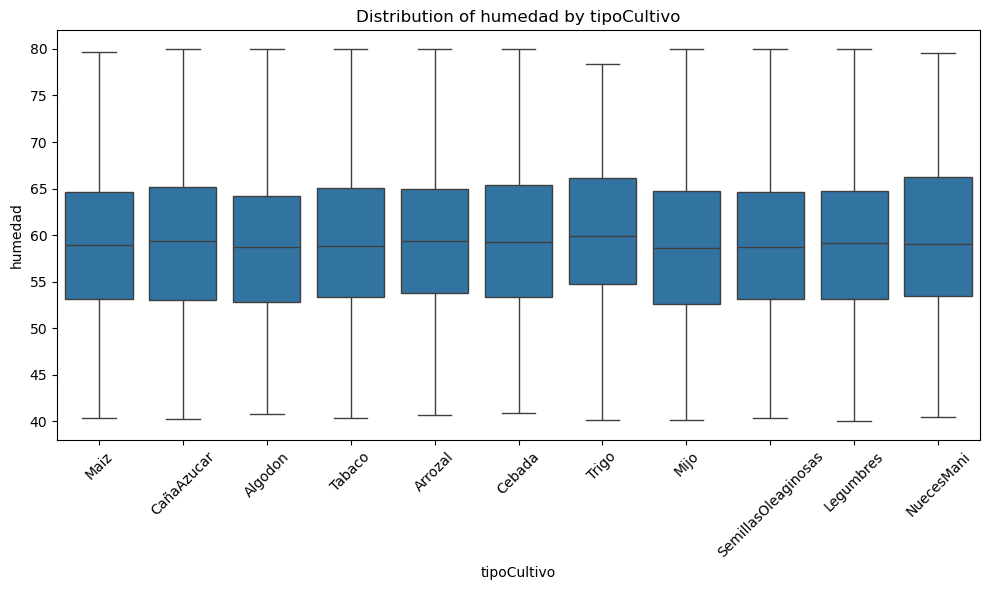


Statistics for humedad by tipoCultivo:
                     count       mean       std    min      25%     50%  \
tipoCultivo                                                               
Algodon              722.0  58.667729  8.055912  40.79  52.8700  58.685   
Arrozal              706.0  59.356572  7.943920  40.70  53.8250  59.330   
CañaAzucar           763.0  59.360105  8.319623  40.23  53.0600  59.340   
Cebada               703.0  59.230939  8.141439  40.88  53.3100  59.280   
Legumbres            728.0  59.093310  7.972969  40.02  53.1775  59.105   
Maiz                 753.0  59.005950  8.104950  40.33  53.1000  58.910   
Mijo                 718.0  58.766393  8.182250  40.17  52.6100  58.645   
NuecesMani           732.0  59.429536  8.681613  40.44  53.4450  59.005   
SemillasOleaginosas  711.0  58.972925  8.163891  40.36  53.1300  58.750   
Tabaco               717.0  59.266709  8.347851  40.37  53.3400  58.870   
Trigo                747.0  60.132289  7.959758  40.17  54.7

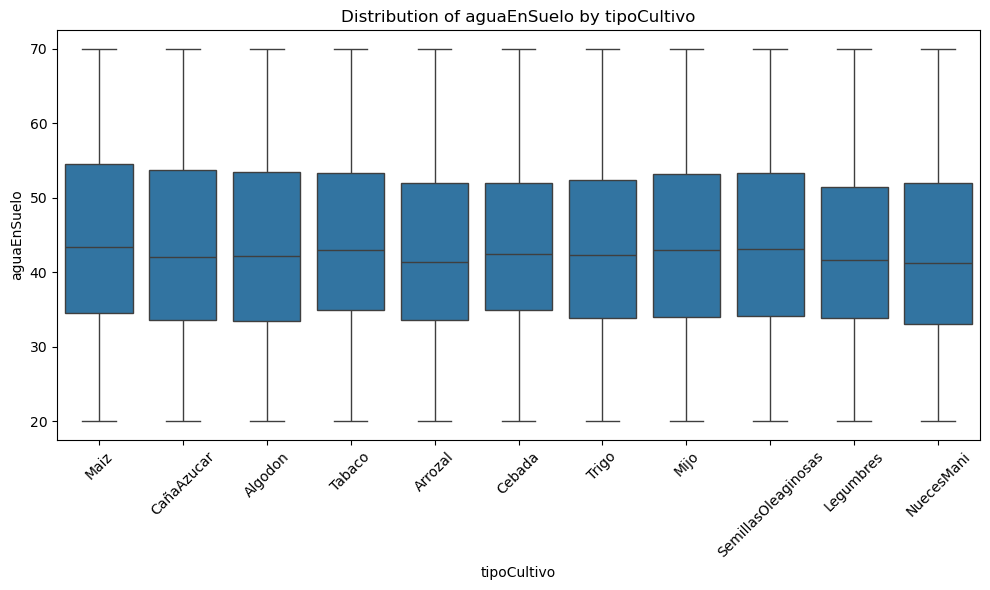


Statistics for aguaEnSuelo by tipoCultivo:
                     count       mean        std   min      25%     50%  \
tipoCultivo                                                               
Algodon              722.0  43.648989  12.758185  20.0  33.4150  42.145   
Arrozal              706.0  42.951686  12.560823  20.0  33.5400  41.350   
CañaAzucar           763.0  43.548938  12.953454  20.0  33.6100  42.030   
Cebada               703.0  43.483514  12.043758  20.0  34.9750  42.470   
Legumbres            728.0  43.016113  12.279928  20.0  33.8100  41.675   
Maiz                 753.0  44.526348  12.929468  20.0  34.5600  43.390   
Mijo                 718.0  43.792813  12.710698  20.0  33.9700  43.020   
NuecesMani           732.0  42.852254  12.581665  20.0  33.1125  41.295   
SemillasOleaginosas  711.0  43.859761  12.688233  20.0  34.1800  43.070   
Tabaco               717.0  44.259582  12.462228  20.0  34.9600  43.020   
Trigo                747.0  43.424525  12.494059  20.0  

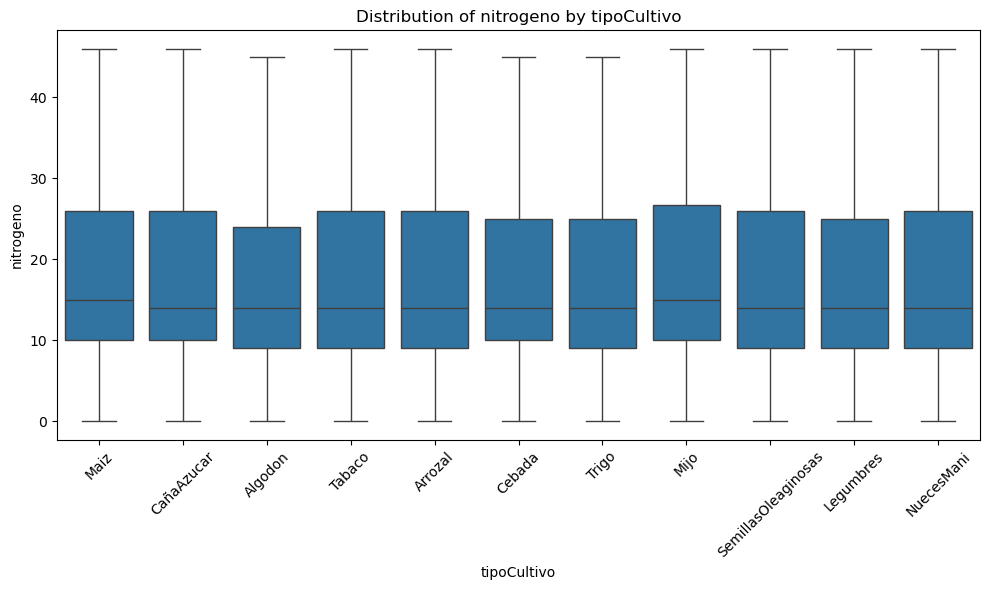


Statistics for nitrogeno by tipoCultivo:
                     count       mean        std  min   25%   50%    75%   max
tipoCultivo                                                                   
Algodon              722.0  17.984765  11.403021  0.0   9.0  14.0  24.00  45.0
Arrozal              706.0  18.518414  12.040373  0.0   9.0  14.0  26.00  46.0
CañaAzucar           763.0  18.764089  12.045165  0.0  10.0  14.0  26.00  46.0
Cebada               703.0  17.870555  11.524730  0.0  10.0  14.0  25.00  45.0
Legumbres            728.0  18.086538  11.642872  0.0   9.0  14.0  25.00  46.0
Maiz                 753.0  18.903054  11.708785  0.0  10.0  15.0  26.00  46.0
Mijo                 718.0  19.171309  12.122683  0.0  10.0  15.0  26.75  46.0
NuecesMani           732.0  18.314208  12.056282  0.0   9.0  14.0  26.00  46.0
SemillasOleaginosas  711.0  18.412096  12.052599  0.0   9.0  14.0  26.00  46.0
Tabaco               717.0  18.605300  11.961373  0.0   9.0  14.0  26.00  46.0
Trigo     

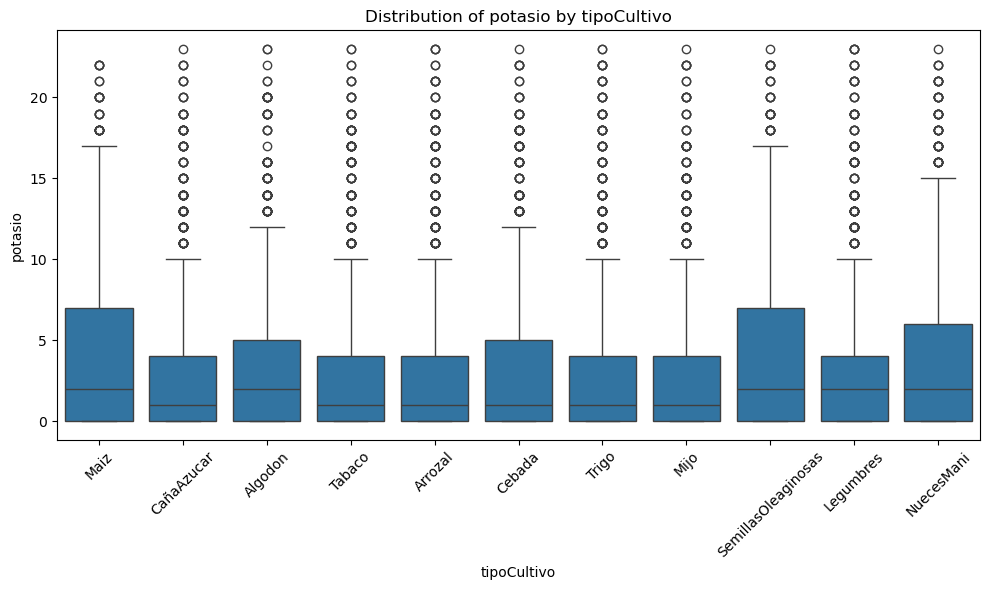


Statistics for potasio by tipoCultivo:
                     count      mean       std  min  25%  50%  75%   max
tipoCultivo                                                             
Algodon              722.0  3.878116  5.259068  0.0  0.0  2.0  5.0  23.0
Arrozal              706.0  3.862606  5.635711  0.0  0.0  1.0  4.0  23.0
CañaAzucar           763.0  3.657929  5.314977  0.0  0.0  1.0  4.0  23.0
Cebada               703.0  3.960171  5.558660  0.0  0.0  1.0  5.0  23.0
Legumbres            728.0  3.927198  5.584063  0.0  0.0  2.0  4.0  23.0
Maiz                 753.0  4.138114  5.516132  0.0  0.0  2.0  7.0  22.0
Mijo                 718.0  3.479109  5.171425  0.0  0.0  1.0  4.0  23.0
NuecesMani           732.0  4.248634  5.688295  0.0  0.0  2.0  6.0  23.0
SemillasOleaginosas  711.0  4.272855  5.665943  0.0  0.0  2.0  7.0  23.0
Tabaco               717.0  3.835425  5.478574  0.0  0.0  1.0  4.0  23.0
Trigo                747.0  3.825971  5.539207  0.0  0.0  1.0  4.0  23.0




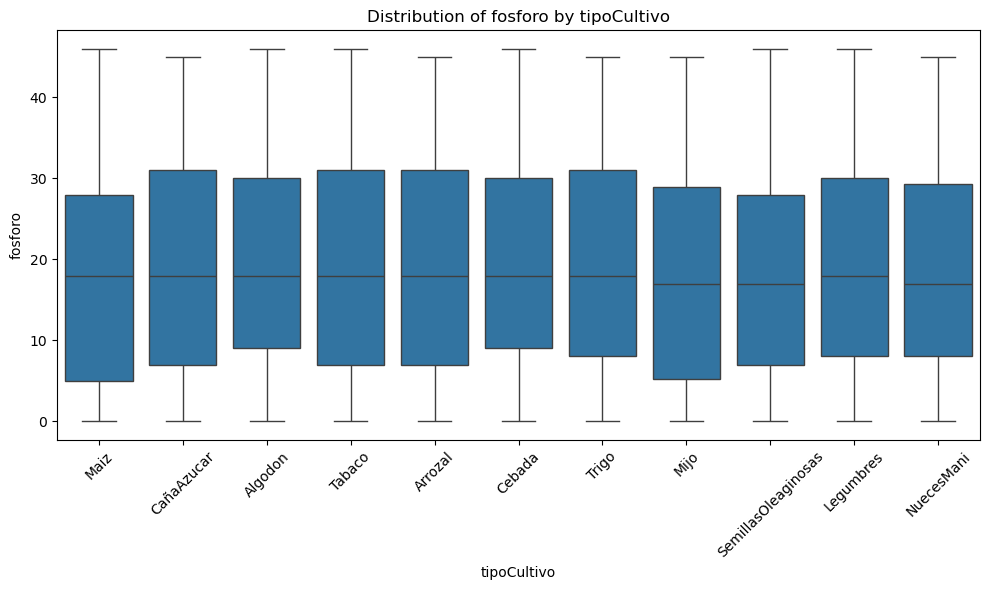


Statistics for fosforo by tipoCultivo:
                     count       mean        std  min   25%   50%    75%   max
tipoCultivo                                                                   
Algodon              722.0  19.000000  13.019456  0.0  9.00  18.0  30.00  46.0
Arrozal              706.0  18.745042  13.484328  0.0  7.00  18.0  31.00  45.0
CañaAzucar           763.0  18.466579  13.491997  0.0  7.00  18.0  31.00  45.0
Cebada               703.0  19.028450  13.257446  0.0  9.00  18.0  30.00  46.0
Legumbres            728.0  18.906593  13.333705  0.0  8.00  18.0  30.00  46.0
Maiz                 753.0  17.784861  12.891381  0.0  5.00  18.0  28.00  46.0
Mijo                 718.0  17.834262  13.225186  0.0  5.25  17.0  29.00  45.0
NuecesMani           732.0  18.467213  13.233472  0.0  8.00  17.0  29.25  45.0
SemillasOleaginosas  711.0  17.749648  12.978391  0.0  7.00  17.0  28.00  46.0
Tabaco               717.0  18.708508  13.448540  0.0  7.00  18.0  31.00  46.0
Trigo       

In [11]:
def plot_boxplots_by_target(df, target_column, figsize=(15, 10), max_cols=3):
    """
    Creates boxplots for all numeric variables in the dataframe, grouped by the target variable.
    
    Parameters:
    -----------
    df : pandas DataFrame
        The dataframe containing the data
    target_column : str
        The name of the target column
    figsize : tuple
        Base figure size (will be adjusted based on number of variables)
    max_cols : int
        Maximum number of columns in the subplot grid
    """

    # Get numeric columns
    numeric_cols = df.select_dtypes(include=np.number).columns.tolist()
    
    # Remove target if it's in numeric columns
    if target_column in numeric_cols:
        numeric_cols.remove(target_column)
    
    if len(numeric_cols) == 0:
        print("No numeric columns found in the dataset.")
        return
    
    # Calculate grid dimensions
    n_cols = min(max_cols, len(numeric_cols))
    n_rows = int(np.ceil(len(numeric_cols) / n_cols))
    
    # Adjust figure size based on number of subplots
    adjusted_figsize = (figsize[0], figsize[1] * (n_rows / 2))
    
    # Create figure
    fig, axes = plt.subplots(n_rows, n_cols, figsize=adjusted_figsize)
    
    # Flatten axes array for easier indexing
    if n_rows > 1 or n_cols > 1:
        axes = axes.flatten()
    else:
        axes = [axes]
    
    # Create boxplots
    for i, col in enumerate(numeric_cols):
        if i < len(axes):
            sns.boxplot(x=target_column, y=col, data=df, ax=axes[i])
            axes[i].set_title(f'Distribution of {col} by {target_column}')
            axes[i].set_xlabel(target_column)
            axes[i].set_ylabel(col)
            
            # Rotate x-axis labels if there are many categories
            if df[target_column].nunique() > 3:
                axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45)
    
    # Hide unused subplots
    for i in range(len(numeric_cols), len(axes)):
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.show()
    
    # Create a separate figure for each variable to see more details
    print("\nCreating individual boxplots for better visibility:")
    
    for col in numeric_cols:
        plt.figure(figsize=(10, 6))
        sns.boxplot(x=target_column, y=col, data=df)
        plt.title(f'Distribution of {col} by {target_column}')
        plt.xlabel(target_column)
        plt.ylabel(col)
        
        # Rotate x-axis labels if there are many categories
        if df[target_column].nunique() > 3:
            plt.xticks(rotation=45)
            
        plt.tight_layout()
        plt.show()
        
        # Print some statistics
        print(f"\nStatistics for {col} by {target_column}:")
        print(df.groupby(target_column)[col].describe())
        print("\n" + "="*80 + "\n")

# Use the function with your dataframe and target column
plot_boxplots_by_target(df_crude, 'tipoCultivo')

---
**BOXPLOT con hue tipo de cultivo**

- En los boxplot analizamos si la distribucion de los datos variaba segun la variable categorica, el unico que tuvo un cambio en la distribucion fue potasio, y esto nos indica que no es lo mas factible quitarle los posibles outliers ya que podrian representar un cambio entre los cultivos.
---

## ANALISIS DE RELACION ENTRE CATEGORICAS

In [12]:
def analyze_categorical_relationships(df, target_col, categorical_cols=None, figsize=(12, 16)):
    """
    Analyze relationships between categorical variables and target variable
    
    Parameters:
    -----------
    df : pandas DataFrame
        The dataset containing the data
    target_col : str
        The name of the target column
    categorical_cols : list or None
        List of categorical columns to analyze. If None, all object and category columns will be used
    figsize : tuple
        Figure size for the plots
    """
    
    # If categorical columns not specified, find all object and category columns
    if categorical_cols is None:
        categorical_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
        # Remove target column from the list if it's there
        if target_col in categorical_cols:
            categorical_cols.remove(target_col)
    
    # Check if we have categorical columns to analyze
    if len(categorical_cols) == 0:
        print("No categorical columns found in the dataset.")
        return
    
    print(f"Analyzing relationships between {len(categorical_cols)} categorical variables and {target_col}")
    
    # For each categorical column, create a plot showing its relationship with the target
    for col in categorical_cols:
        # Create a figure with 2 rows and 1 column (vertical layout)
        fig, axes = plt.subplots(2, 1, figsize=figsize)
        
        # Create a crosstab to see the relationship
        cross_tab = pd.crosstab(df[col], df[target_col], normalize='index')
        
        # Plot heatmap of the relationship on the top subplot
        sns.heatmap(cross_tab, annot=True, cmap='YlGnBu', fmt='.2%', ax=axes[0])
        axes[0].set_title(f'Relationship between {col} and {target_col} (Normalized)')
        axes[0].set_xlabel(target_col)
        axes[0].set_ylabel(col)
        
        # Plot count plot to see distribution on the bottom subplot
        sns.countplot(x=col, hue=target_col, data=df, ax=axes[1])
        axes[1].set_title(f'Distribution of {target_col} by {col}')
        axes[1].set_xlabel(col)
        axes[1].set_ylabel('Count')
        axes[1].tick_params(axis='x', rotation=45)
        
        # Adjust layout to prevent overlap
        plt.tight_layout()
        plt.show()
        
        # Print some statistics
        print(f"\nContingency table for {col} and {target_col}:")
        print(pd.crosstab(df[col], df[target_col]))
        
        # Chi-square test for independence
        from scipy.stats import chi2_contingency
        contingency_table = pd.crosstab(df[col], df[target_col])
        chi2, p, dof, expected = chi2_contingency(contingency_table)
        print(f"\nChi-square test for independence:")
        print(f"Chi2 value: {chi2:.4f}")
        print(f"p-value: {p:.4f}")
        print(f"Degrees of freedom: {dof}")
        if p < 0.05:
            print(f"Result: There is a significant relationship between {col} and {target_col} (p < 0.05)")
        else:
            print(f"Result: No significant relationship detected between {col} and {target_col} (p >= 0.05)")
        
        print("\n" + "="*80 + "\n")

Analyzing relationships between 2 categorical variables and tipoCultivo


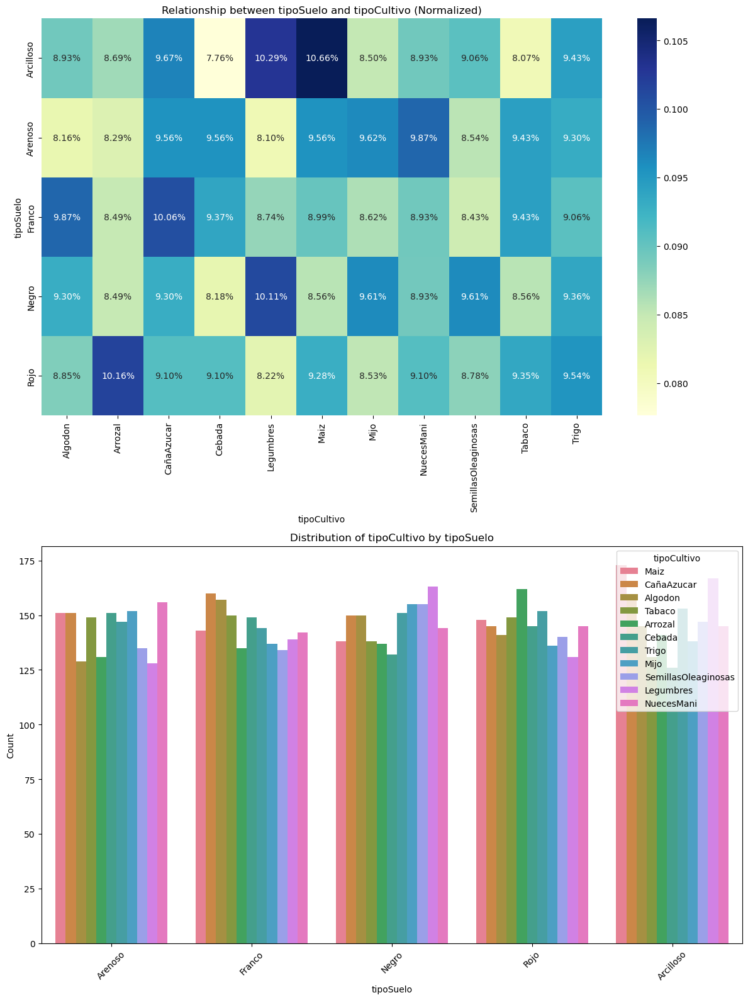


Contingency table for tipoSuelo and tipoCultivo:
tipoCultivo  Algodon  Arrozal  CañaAzucar  Cebada  Legumbres  Maiz  Mijo  \
tipoSuelo                                                                  
Arcilloso        145      141         157     126        167   173   138   
Arenoso          129      131         151     151        128   151   152   
Franco           157      135         160     149        139   143   137   
Negro            150      137         150     132        163   138   155   
Rojo             141      162         145     145        131   148   136   

tipoCultivo  NuecesMani  SemillasOleaginosas  Tabaco  Trigo  
tipoSuelo                                                    
Arcilloso           145                  147     131    153  
Arenoso             156                  135     149    147  
Franco              142                  134     150    144  
Negro               144                  155     138    151  
Rojo                145                  140 

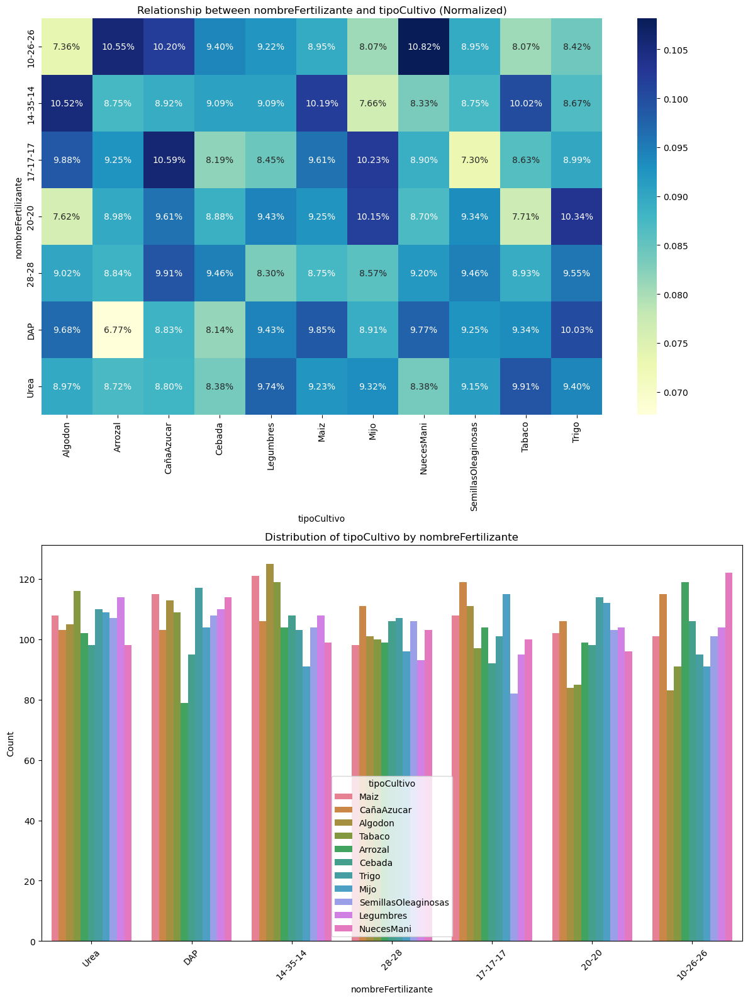


Contingency table for nombreFertilizante and tipoCultivo:
tipoCultivo         Algodon  Arrozal  CañaAzucar  Cebada  Legumbres  Maiz  \
nombreFertilizante                                                          
10-26-26                 83      119         115     106        104   101   
14-35-14                125      104         106     108        108   121   
17-17-17                111      104         119      92         95   108   
20-20                    84       99         106      98        104   102   
28-28                   101       99         111     106         93    98   
DAP                     113       79         103      95        110   115   
Urea                    105      102         103      98        114   108   

tipoCultivo         Mijo  NuecesMani  SemillasOleaginosas  Tabaco  Trigo  
nombreFertilizante                                                        
10-26-26              91         122                  101      91     95  
14-35-14              

In [13]:
analyze_categorical_relationships(df_crude, 'tipoCultivo')

---
**ESTUDIO DE RELACION ENTRE VARIABLES CATEGORICAS CON LA VARIABLE TARGET**

- Los porcentajes de datos entre variables se mantienen constantes de acuerdo al tipo de cultivos, esto nos indica que no hay una variable categorica que permita distinguir un cultivo de otro.
---

## TRATAMIENTO DE VARIABLES ATIPICAS Y CATEGORICAS

---
*TOMA DE DECISION:*
- La variable potasio se puede considerar que presenta outliers por eso optamos por eliminar los valores atipicos a partir del bigote mas largo, ya que esto nos eliminaria un menor porcentaje de los datos, y estariamos eliminando un buen numero de outliers.
---

In [14]:
# Analizar cuántos valores de Potasio son mayores que 17.5
potasio_outliers = df_crude['potasio'] > 17.5
conteo_potasio_outliers = potasio_outliers.sum()

print(f"Número de registros con Potasio > 17.5: {conteo_potasio_outliers}")
# Calcular el porcentaje de valores de Potasio mayores que 17.5
porcentaje_potasio_outliers = (conteo_potasio_outliers / len(df_crude)) * 100
print(f"Porcentaje de registros con Potasio > 17.5: {porcentaje_potasio_outliers:.2f}%")

Número de registros con Potasio > 17.5: 292
Porcentaje de registros con Potasio > 17.5: 3.65%


In [15]:
X

,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,26.00,52.00,38.00,Arenoso,37,0,0,Urea
1,29.00,52.00,45.00,Franco,12,0,36,DAP
2,34.00,65.00,62.00,Negro,7,9,30,14-35-14
3,32.00,62.00,34.00,Rojo,22,0,20,28-28
4,28.00,54.00,46.00,Arcilloso,35,0,0,Urea
...,...,...,...,...,...,...,...,...
7995,35.30,59.61,44.25,Franco,10,14,10,Urea
7996,39.39,71.67,49.34,Negro,35,0,0,10-26-26
7997,35.79,67.64,45.04,Rojo,41,0,0,Urea
7998,37.78,73.38,36.03,Negro,10,3,30,DAP


In [16]:
X = X[~potasio_outliers]

# Verificar el nuevo tamaño de X
print(f"Nuevo número de filas en X después de eliminar Potasio > 17.5: {X.shape[0]}")

Nuevo número de filas en X después de eliminar Potasio > 17.5: 7708


In [17]:
X

,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,26.00,52.00,38.00,Arenoso,37,0,0,Urea
1,29.00,52.00,45.00,Franco,12,0,36,DAP
2,34.00,65.00,62.00,Negro,7,9,30,14-35-14
3,32.00,62.00,34.00,Rojo,22,0,20,28-28
4,28.00,54.00,46.00,Arcilloso,35,0,0,Urea
...,...,...,...,...,...,...,...,...
7995,35.30,59.61,44.25,Franco,10,14,10,Urea
7996,39.39,71.67,49.34,Negro,35,0,0,10-26-26
7997,35.79,67.64,45.04,Rojo,41,0,0,Urea
7998,37.78,73.38,36.03,Negro,10,3,30,DAP


In [18]:
len(X.columns)

8

In [19]:
# Aplicar Label Encoding a las variables categóricas en X
def apply_label_encoding(X):
    """
    Aplica Label Encoding a las variables categóricas en el dataframe
    
    Parameters:
    -----------
    X : pandas DataFrame
        El dataframe con las variables a codificar
        
    Returns:
    --------
    pandas DataFrame
        Dataframe con las variables categóricas codificadas
    """
    
    # Importar LabelEncoder de sklearn
    from sklearn.preprocessing import LabelEncoder
    
    # Identificar columnas categóricas
    categorical_cols = X.select_dtypes(include=['object', 'category']).columns.tolist()
    
    if len(categorical_cols) == 0:
        print("No se encontraron variables categóricas para codificar.")
        return X
    
    print(f"Aplicando Label Encoding a {len(categorical_cols)} variables categóricas:")
    print(categorical_cols)
    
    # Crear una copia para no modificar el original
    X_encoded = X.copy()
    
    # Aplicar label encoding a cada columna categórica
    encoders = {}
    for col in categorical_cols:
        le = LabelEncoder()
        X_encoded[col] = le.fit_transform(X_encoded[col])
        encoders[col] = le
        
        # Mostrar mapeo de categorías a valores numéricos
        mapping = dict(zip(le.classes_, le.transform(le.classes_)))
        print(f"\nMapeo para {col}:")
        for category, value in mapping.items():
            print(f"  {category} -> {value}")
    
    # Mostrar información sobre el resultado
    print(f"\nDimensiones originales: {X.shape}")
    print(f"Dimensiones después de Label Encoding: {X_encoded.shape}")
    print("Nota: Label Encoding no cambia el número de columnas, solo transforma los valores.")
    
    return X_encoded, encoders

# Aplicar Label Encoding a X
X_encoded, encoders = apply_label_encoding(X)

# Verificar el resultado
print("\nPrimeras filas del dataframe codificado:")
X_encoded.head()

Aplicando Label Encoding a 2 variables categóricas:
['tipoSuelo', 'nombreFertilizante']

Mapeo para tipoSuelo:
  Arcilloso -> 0
  Arenoso -> 1
  Franco -> 2
  Negro -> 3
  Rojo -> 4

Mapeo para nombreFertilizante:
  10-26-26 -> 0
  14-35-14 -> 1
  17-17-17 -> 2
  20-20 -> 3
  28-28 -> 4
  DAP -> 5
  Urea -> 6

Dimensiones originales: (7708, 8)
Dimensiones después de Label Encoding: (7708, 8)
Nota: Label Encoding no cambia el número de columnas, solo transforma los valores.

Primeras filas del dataframe codificado:


,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,26.0,52.0,38.0,1,37,0,0,6
1,29.0,52.0,45.0,2,12,0,36,5
2,34.0,65.0,62.0,3,7,9,30,1
3,32.0,62.0,34.0,4,22,0,20,4
4,28.0,54.0,46.0,0,35,0,0,6


In [20]:
len(X_encoded.columns)

8

In [21]:
# Identificar columnas numéricas y categóricas (one-hot encoded)
numerical_cols = []
categorical_cols = []

for col in X_encoded.columns:
    # Si la columna solo tiene valores 0 y 1, es probablemente one-hot encoded
    if set(X_encoded[col].unique()).issubset({0, 1}):
        categorical_cols.append(col)
    else:
        numerical_cols.append(col)

print(f"Columnas numéricas: {len(numerical_cols)}")
print(f"Columnas categóricas (one-hot encoded): {len(categorical_cols)}")

# Crear un objeto StandardScaler
scaler = StandardScaler()

# Crear una copia de X_encoded para no modificar el original
X_scaled = X_encoded.copy()

# Aplicar el escalado solo a las columnas numéricas
if numerical_cols:
    X_scaled[numerical_cols] = scaler.fit_transform(X_encoded[numerical_cols])

# Verificar que el escalado se haya aplicado correctamente
print("\nEstadísticas descriptivas de columnas numéricas después del escalado:")
if numerical_cols:
    # Corregido: acceder a las estadísticas correctamente
    num_stats = X_scaled[numerical_cols].describe()
    print(num_stats)
    # Verificar que la media sea cercana a 0 y la desviación estándar cercana a 1
    print("\nMedia de las columnas numéricas escaladas:")
    print(num_stats.loc['mean'])
    print("\nDesviación estándar de las columnas numéricas escaladas:")
    print(num_stats.loc['std'])

print("\nEstadísticas descriptivas de columnas categóricas (no escaladas):")
if categorical_cols:
    cat_stats = X_scaled[categorical_cols].describe()
    print(cat_stats)

# Verificar las primeras filas del dataset escalado
print("\nPrimeras filas del dataset escalado:")
X_scaled.head()

Columnas numéricas: 8
Columnas categóricas (one-hot encoded): 0

Estadísticas descriptivas de columnas numéricas después del escalado:
        temperatura       humedad   aguaEnSuelo     tipoSuelo     nitrogeno  \
count  7.708000e+03  7.708000e+03  7.708000e+03  7.708000e+03  7.708000e+03   
mean   2.876094e-16  5.549387e-16 -1.714595e-16  1.175327e-16  1.401174e-16   
std    1.000065e+00  1.000065e+00  1.000065e+00  1.000065e+00  1.000065e+00   
min   -2.314429e+00 -2.352649e+00 -1.871226e+00 -1.407276e+00 -1.589445e+00   
25%   -7.313823e-01 -7.246815e-01 -7.662155e-01 -7.025410e-01 -7.456876e-01   
50%   -2.382520e-02 -1.376667e-02 -1.111025e-01  2.194298e-03 -3.238089e-01   
75%    6.926884e-01  7.164449e-01  7.442936e-01  7.069296e-01  6.043243e-01   
max    2.157063e+00  2.545649e+00  2.075239e+00  1.411665e+00  2.291839e+00   

            potasio       fosforo  nombreFertilizante  
count  7.708000e+03  7.708000e+03        7.708000e+03  
mean   1.244464e-17  5.945771e-17       -

,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,-0.977684,-0.884875,-0.450498,-0.702541,1.532457,-0.717877,-1.380169,1.485255
1,-0.305952,-0.884875,0.102007,0.002194,-0.576936,-0.717877,1.293714,0.987825
2,0.813600,0.707869,1.443804,0.706930,-0.998815,1.231340,0.848067,-1.001894
3,0.365779,0.340312,-0.766216,1.411665,0.266821,-0.717877,0.105322,0.490395
4,-0.529863,-0.639837,0.180936,-1.407276,1.363706,-0.717877,-1.380169,1.485255


---
# EJERCICIO 2
Realizar PCA y determinar el número de componentes principales considerando alguno de 
los 3 criterios datos en la práctica. Graficar la varianza acumulada y las componentes de 
PCA en un gráfico 2 o 3D con sus respectivas clases.

---

In [22]:
# Identificar columnas numéricas y categóricas (one-hot encoded)
numerical_cols = []
categorical_cols = []

for col in X_encoded.columns:
    # Si la columna solo tiene valores 0 y 1, es probablemente one-hot encoded
    if set(X_encoded[col].unique()).issubset({0, 1}):
        categorical_cols.append(col)
    else:
        numerical_cols.append(col)

print(f"Columnas numéricas: {len(numerical_cols)}")
print(f"Columnas categóricas (one-hot encoded): {len(categorical_cols)}")

# Importar los escaladores
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

# 1. Standard Scaler con variables categóricas
std_scaler_with_cat = StandardScaler()
X_std_with_cat = pd.DataFrame(
    std_scaler_with_cat.fit_transform(X_encoded),
    columns=X_encoded.columns,
    index=X_encoded.index
)
print("\n1. Standard Scaler con variables categóricas - Primeras filas:")
print(X_std_with_cat.head())

# 2. Standard Scaler sin variables categóricas
X_std_without_cat = X_encoded.copy()
std_scaler_without_cat = StandardScaler()
X_std_without_cat[numerical_cols] = std_scaler_without_cat.fit_transform(X_encoded[numerical_cols])
print("\n2. Standard Scaler sin variables categóricas - Primeras filas:")
print(X_std_without_cat.head())

# 3. MinMax Scaler con variables categóricas
minmax_scaler_with_cat = MinMaxScaler()
X_minmax_with_cat = pd.DataFrame(
    minmax_scaler_with_cat.fit_transform(X_encoded),
    columns=X_encoded.columns,
    index=X_encoded.index
)
print("\n3. MinMax Scaler con variables categóricas - Primeras filas:")
print(X_minmax_with_cat.head())

# 4. MinMax Scaler sin variables categóricas
X_minmax_without_cat = X_encoded.copy()
minmax_scaler_without_cat = MinMaxScaler()
X_minmax_without_cat[numerical_cols] = minmax_scaler_without_cat.fit_transform(X_encoded[numerical_cols])
print("\n4. MinMax Scaler sin variables categóricas - Primeras filas:")
print(X_minmax_without_cat.head())

# 5. Robust Scaler con variables categóricas
robust_scaler_with_cat = RobustScaler()
X_robust_with_cat = pd.DataFrame(
    robust_scaler_with_cat.fit_transform(X_encoded),
    columns=X_encoded.columns,
    index=X_encoded.index
)
print("\n5. Robust Scaler con variables categóricas - Primeras filas:")
print(X_robust_with_cat.head())

# 6. Robust Scaler sin variables categóricas
X_robust_without_cat = X_encoded.copy()
robust_scaler_without_cat = RobustScaler()
X_robust_without_cat[numerical_cols] = robust_scaler_without_cat.fit_transform(X_encoded[numerical_cols])
print("\n6. Robust Scaler sin variables categóricas - Primeras filas:")
print(X_robust_without_cat.head())

# Guardar los DataFrames escalados en un diccionario para fácil acceso
scaled_data = {
    'standard_with_cat': X_std_with_cat,
    'standard_without_cat': X_std_without_cat,
    'minmax_with_cat': X_minmax_with_cat,
    'minmax_without_cat': X_minmax_without_cat,
    'robust_with_cat': X_robust_with_cat,
    'robust_without_cat': X_robust_without_cat
}

# Verificar estadísticas básicas para cada escalado
for name, data in scaled_data.items():
    print(f"\nEstadísticas para {name}:")
    if 'without_cat' in name:
        # Para escalados sin categorías, mostrar estadísticas solo de columnas numéricas
        print(data[numerical_cols].describe().loc[['mean', 'std', 'min', '25%', '50%', '75%', 'max']].T.head())
    else:
        # Para escalados con categorías, mostrar estadísticas de todas las columnas
        print(data.describe().loc[['mean', 'std', 'min', '25%', '50%', '75%', 'max']].T.head())

Columnas numéricas: 8
Columnas categóricas (one-hot encoded): 0

1. Standard Scaler con variables categóricas - Primeras filas:
   temperatura   humedad  aguaEnSuelo  tipoSuelo  nitrogeno   potasio  \
0    -0.977684 -0.884875    -0.450498  -0.702541   1.532457 -0.717877   
1    -0.305952 -0.884875     0.102007   0.002194  -0.576936 -0.717877   
2     0.813600  0.707869     1.443804   0.706930  -0.998815  1.231340   
3     0.365779  0.340312    -0.766216   1.411665   0.266821 -0.717877   
4    -0.529863 -0.639837     0.180936  -1.407276   1.363706 -0.717877   

    fosforo  nombreFertilizante  
0 -1.380169            1.485255  
1  1.293714            0.987825  
2  0.848067           -1.001894  
3  0.105322            0.490395  
4 -1.380169            1.485255  

2. Standard Scaler sin variables categóricas - Primeras filas:
   temperatura   humedad  aguaEnSuelo  tipoSuelo  nitrogeno   potasio  \
0    -0.977684 -0.884875    -0.450498  -0.702541   1.532457 -0.717877   
1    -0.305952 -0.8

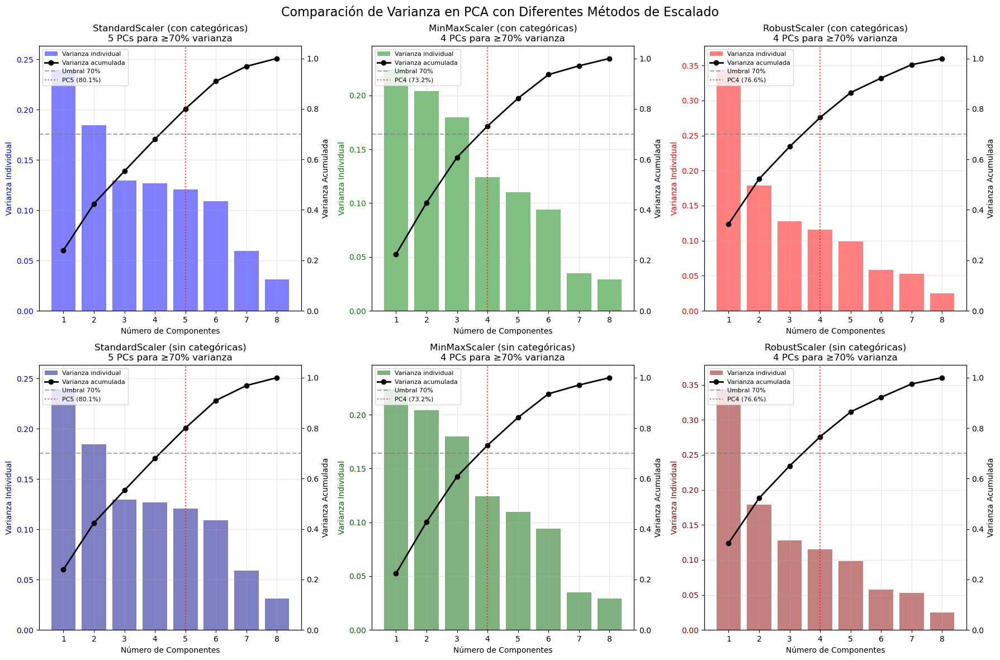

Número de componentes necesarios para explicar al menos el 70% de la varianza:
StandardScaler (con categóricas): 5 componentes (80.06%)
MinMaxScaler (con categóricas): 4 componentes (73.20%)
RobustScaler (con categóricas): 4 componentes (76.57%)
StandardScaler (sin categóricas): 5 componentes (80.06%)
MinMaxScaler (sin categóricas): 4 componentes (73.20%)
RobustScaler (sin categóricas): 4 componentes (76.57%)


In [23]:
# Configuración de la figura para los 6 plots con el orden específico
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Definir el orden específico de los plots
plot_order = [
    # Fila superior: con categoricas
    ('standard_with_cat', 0, 0),
    ('minmax_with_cat', 0, 1),
    ('robust_with_cat', 0, 2),
    # Fila inferior: sin categoricas
    ('standard_without_cat', 1, 0),
    ('minmax_without_cat', 1, 1),
    ('robust_without_cat', 1, 2)
]

# Colores para cada método de escalado
colors = {
    'standard_with_cat': 'blue',
    'standard_without_cat': 'darkblue',
    'minmax_with_cat': 'green',
    'minmax_without_cat': 'darkgreen',
    'robust_with_cat': 'red',
    'robust_without_cat': 'darkred'
}

# Títulos descriptivos para cada método
titles = {
    'standard_with_cat': 'StandardScaler (con categóricas)',
    'standard_without_cat': 'StandardScaler (sin categóricas)',
    'minmax_with_cat': 'MinMaxScaler (con categóricas)',
    'minmax_without_cat': 'MinMaxScaler (sin categóricas)',
    'robust_with_cat': 'RobustScaler (con categóricas)',
    'robust_without_cat': 'RobustScaler (sin categóricas)'
}

# Diccionario para almacenar resultados de PCA
pca_results = {}

# Realizar PCA para cada dataframe escalado
for name, row, col in plot_order:
    data = scaled_data[name]
    
    # Crear y ajustar PCA
    pca = PCA()
    pca_result = pca.fit_transform(data)
    
    # Guardar resultados
    pca_results[name] = {
        'pca': pca,
        'result': pca_result,
        'explained_variance': pca.explained_variance_ratio_,
        'cumulative_variance': np.cumsum(pca.explained_variance_ratio_)
    }
    
    # Calcular componentes necesarios para 70% de varianza
    explained_variance = pca_results[name]['explained_variance']
    cumulative_variance = pca_results[name]['cumulative_variance']
    n_components_70 = np.argmax(cumulative_variance >= 0.7) + 1
    
    # Obtener el eje correspondiente
    ax = axes[row, col]
    
    # Graficar barras de varianza individual
    ax.bar(
        range(1, len(explained_variance) + 1),
        explained_variance,
        alpha=0.5,
        color=colors[name],
        label='Varianza individual'
    )
    
    # Graficar línea de varianza acumulada
    ax2 = ax.twinx()
    ax2.plot(
        range(1, len(cumulative_variance) + 1), 
        cumulative_variance, 
        'o-', 
        color='black',
        linewidth=2,
        label='Varianza acumulada'
    )
    ax2.axhline(y=0.7, color='gray', linestyle='--', alpha=0.7, label='Umbral 70%')
    ax2.axvline(x=n_components_70, color='red', linestyle=':', alpha=0.7, 
               label=f'PC{n_components_70} ({cumulative_variance[n_components_70-1]:.1%})')
    
# Configurar gráfico
    ax.set_title(f"{titles[name]}\n{n_components_70} PCs para ≥70% varianza", fontsize=12)
    ax.set_xlabel('Número de Componentes')
    ax.set_ylabel('Varianza Individual', color=colors[name])
    ax.tick_params(axis='y', labelcolor=colors[name])
    ax.set_ylim([0, max(explained_variance) * 1.1])
    
    # Configurar eje X para mostrar solo números enteros
    ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    ax2.set_ylabel('Varianza Acumulada', color='black')
    ax2.tick_params(axis='y', labelcolor='black')
    ax2.set_ylim([0, 1.05])
    
    # Añadir leyenda
    lines1, labels1 = ax.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax.legend(lines1 + lines2, labels1 + labels2, loc='upper left', fontsize=8)
    
    # Añadir grid
    ax.grid(True, alpha=0.3)

plt.suptitle('Comparación de Varianza en PCA con Diferentes Métodos de Escalado', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

# Imprimir resumen de componentes necesarios para alcanzar el 70% de varianza
print("Número de componentes necesarios para explicar al menos el 70% de la varianza:")
for name, _, _ in plot_order:
    cumulative_variance = pca_results[name]['cumulative_variance']
    n_components_70 = np.argmax(cumulative_variance >= 0.7) + 1
    print(f"{titles[name]}: {n_components_70} componentes ({cumulative_variance[n_components_70-1]:.2%})")

c:\Users\gfrat\anaconda3\Lib\site-packages\matplotlib\collections.py:1109: UserWarning: Collection without array used. Make sure to specify the values to be colormapped via the `c` argument.
  warnings.warn("Collection without array used. Make sure to "


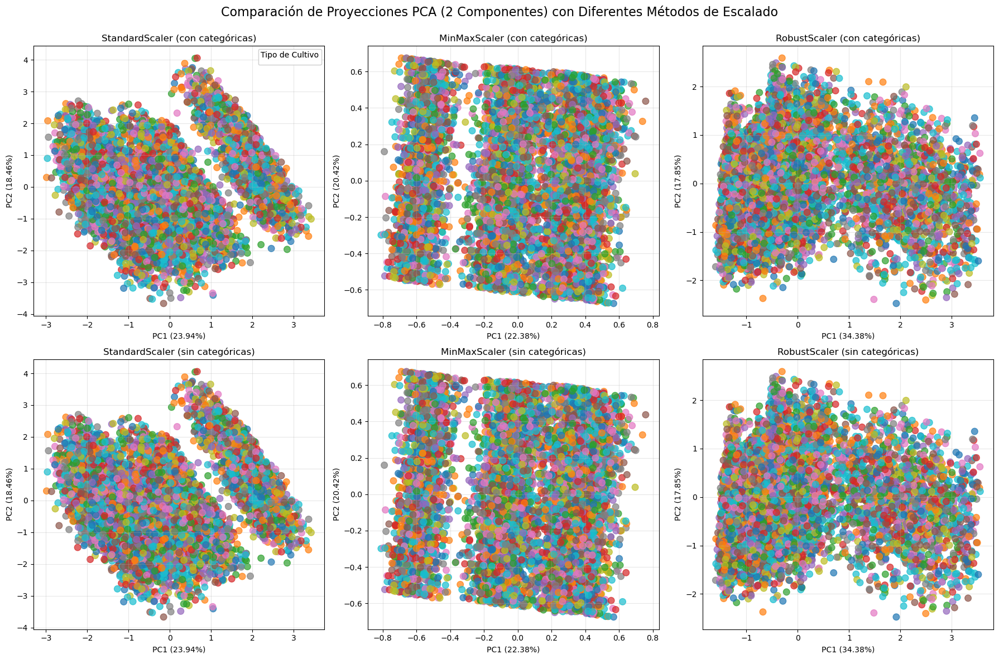

Varianza explicada por las primeras 2 componentes principales:
StandardScaler (con categóricas): 42.41%
MinMaxScaler (con categóricas): 42.79%
RobustScaler (con categóricas): 52.23%
StandardScaler (sin categóricas): 42.41%
MinMaxScaler (sin categóricas): 42.79%
RobustScaler (sin categóricas): 52.23%


In [24]:
# Crear un DataFrame con los primeros 2 componentes principales para cada método
pca_2d_data = {}
for name, result in pca_results.items():
    pca_2d_data[name] = pd.DataFrame(
        data=result['result'][:, :2],
        columns=['PC1', 'PC2'],
        index=scaled_data[name].index
    )
    pca_2d_data[name]['tipoCultivo'] = df_crude['tipoCultivo']

# Visualizar los primeros 2 componentes principales para cada método
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Usar el mismo orden de plots que antes
for name, row, col in plot_order:
    ax = axes[row, col]
    data = pca_2d_data[name]
    
    # Crear un scatter plot con colores por tipo de cultivo
    scatter = ax.scatter(
        data['PC1'], 
        data['PC2'], 
        c=[plt.cm.tab10(j) for j in pd.factorize(data['tipoCultivo'])[0]],
        alpha=0.7,
        s=70
    )
    
    # Añadir título y etiquetas
    ax.set_title(titles[name], fontsize=12)
    ax.set_xlabel(f"PC1 ({pca_results[name]['explained_variance'][0]:.2%})")
    ax.set_ylabel(f"PC2 ({pca_results[name]['explained_variance'][1]:.2%})")
    ax.grid(True, alpha=0.3)
    
    # Añadir leyenda solo al primer gráfico
    if row == 0 and col == 0:
        # Crear leyenda para tipos de cultivo
        handles, labels = scatter.legend_elements()
        cultivos_unicos = data['tipoCultivo'].unique()
        legend = ax.legend(handles, cultivos_unicos, 
                          title="Tipo de Cultivo", 
                          loc="best",
                          fontsize=8)
        ax.add_artist(legend)

plt.suptitle('Comparación de Proyecciones PCA (2 Componentes) con Diferentes Métodos de Escalado', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

# Calcular y mostrar la varianza explicada por las primeras 2 componentes para cada método
print("Varianza explicada por las primeras 2 componentes principales:")
for name, _, _ in plot_order:
    explained_variance = pca_results[name]['explained_variance']
    total_variance_2pc = explained_variance[0] + explained_variance[1]
    print(f"{titles[name]}: {total_variance_2pc:.2%}")

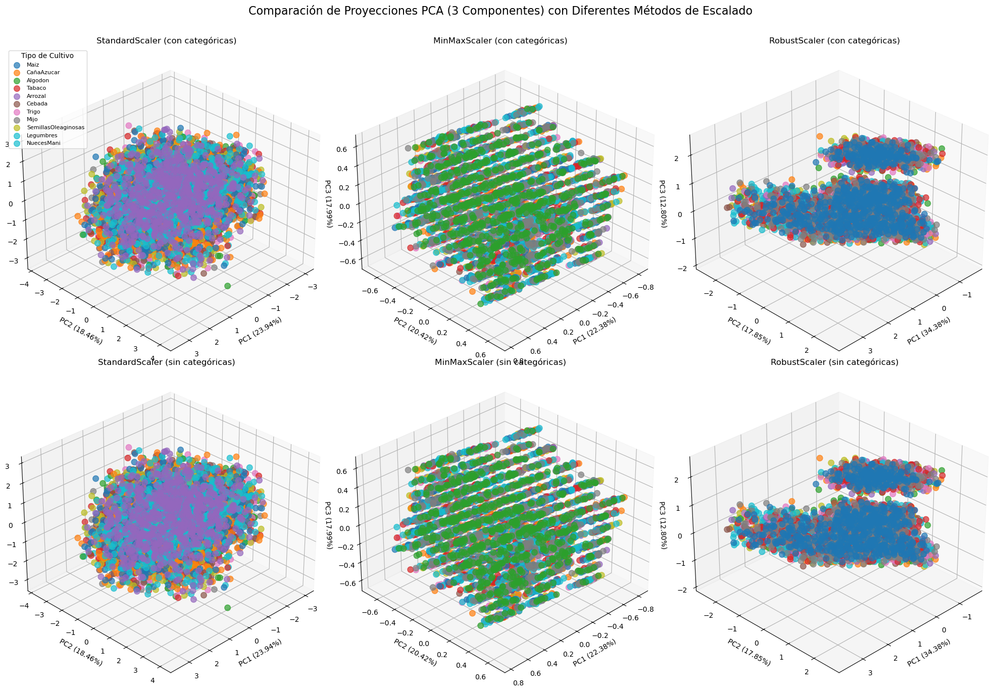

Varianza explicada por las primeras 3 componentes principales:
StandardScaler (con categóricas): 55.34%
MinMaxScaler (con categóricas): 60.78%
RobustScaler (con categóricas): 65.03%
StandardScaler (sin categóricas): 55.34%
MinMaxScaler (sin categóricas): 60.78%
RobustScaler (sin categóricas): 65.03%


In [25]:
# Crear un DataFrame con los primeros 3 componentes principales para cada método
pca_3d_data = {}
for name, result in pca_results.items():
    pca_3d_data[name] = pd.DataFrame(
        data=result['result'][:, :3],
        columns=['PC1', 'PC2', 'PC3'],
        index=scaled_data[name].index
    )
    pca_3d_data[name]['tipoCultivo'] = df_crude['tipoCultivo']

# Visualizar los primeros 3 componentes principales para cada método en 3D
fig = plt.figure(figsize=(20, 14))

# Usar el mismo orden de plots que antes
for i, (name, row, col) in enumerate(plot_order):
    # Calcular la posición del subplot (2 filas, 3 columnas)
    position = i + 1
    
    # Crear subplot 3D
    ax = fig.add_subplot(2, 3, position, projection='3d')
    data = pca_3d_data[name]
    
    # Obtener colores únicos para cada tipo de cultivo
    cultivos_unicos = data['tipoCultivo'].unique()
    colors = plt.cm.tab10(np.linspace(0, 1, len(cultivos_unicos)))
    color_map = dict(zip(cultivos_unicos, colors))
    
    # Crear un scatter plot 3D con colores por tipo de cultivo
    for cultivo, color in color_map.items():
        subset = data[data['tipoCultivo'] == cultivo]
        ax.scatter(
            subset['PC1'], 
            subset['PC2'], 
            subset['PC3'],
            color=color,
            alpha=0.7,
            s=70,
            label=cultivo
        )
    
    # Añadir título y etiquetas
    ax.set_title(titles[name], fontsize=12)
    ax.set_xlabel(f"PC1 ({pca_results[name]['explained_variance'][0]:.2%})")
    ax.set_ylabel(f"PC2 ({pca_results[name]['explained_variance'][1]:.2%})")
    ax.set_zlabel(f"PC3 ({pca_results[name]['explained_variance'][2]:.2%})")
    
    # Añadir leyenda solo al primer gráfico
    if i == 0:
        ax.legend(title="Tipo de Cultivo", loc="best", fontsize=8)
    
    # Mejorar visualización
    ax.grid(True, alpha=0.3)
    ax.view_init(elev=30, azim=45)  # Ajustar ángulo de visualización

plt.suptitle('Comparación de Proyecciones PCA (3 Componentes) con Diferentes Métodos de Escalado', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

# Calcular y mostrar la varianza explicada por las primeras 3 componentes para cada método
print("Varianza explicada por las primeras 3 componentes principales:")
for name, _, _ in plot_order:
    explained_variance = pca_results[name]['explained_variance']
    total_variance_3pc = explained_variance[0] + explained_variance[1] + explained_variance[2]
    print(f"{titles[name]}: {total_variance_3pc:.2%}")

In [26]:
# Crear visualizaciones 3D interactivas con Plotly para cada método de escalado
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

# Crear un DataFrame con los primeros 3 componentes principales para cada método
pca_3d_data = {}
for name, result in pca_results.items():
    pca_3d_data[name] = pd.DataFrame(
        data=result['result'][:, :3],
        columns=['PC1', 'PC2', 'PC3'],
        index=scaled_data[name].index
    )
    pca_3d_data[name]['tipoCultivo'] = df_crude['tipoCultivo']

# Crear figuras interactivas separadas para cada método de escalado
for name, row, col in plot_order:
    data = pca_3d_data[name]
    
    # Crear una nueva figura
    fig = go.Figure()
    
    # Obtener colores únicos para cada tipo de cultivo
    cultivos_unicos = data['tipoCultivo'].unique()
    
    # Crear un scatter plot 3D con colores por tipo de cultivo
    for i, cultivo in enumerate(cultivos_unicos):
        subset = data[data['tipoCultivo'] == cultivo]
        
        fig.add_trace(go.Scatter3d(
            x=subset['PC1'],
            y=subset['PC2'],
            z=subset['PC3'],
            mode='markers',
            marker=dict(
                size=5,
                opacity=0.7,
                color=i  # Asignar un color diferente a cada cultivo
            ),
            name=cultivo
        ))
    
    # Configurar el diseño de la figura
    fig.update_layout(
        title=f"{titles[name]}<br>Varianza explicada: PC1={pca_results[name]['explained_variance'][0]:.2%}, "
              f"PC2={pca_results[name]['explained_variance'][1]:.2%}, "
              f"PC3={pca_results[name]['explained_variance'][2]:.2%}",
        scene=dict(
            xaxis_title=f"PC1 ({pca_results[name]['explained_variance'][0]:.2%})",
            yaxis_title=f"PC2 ({pca_results[name]['explained_variance'][1]:.2%})",
            zaxis_title=f"PC3 ({pca_results[name]['explained_variance'][2]:.2%})"
        ),
        legend_title="Tipo de Cultivo",
        height=700,
        width=900
    )
    
    # Mostrar la figura
    fig.show()

# Calcular y mostrar la varianza explicada por las primeras 3 componentes para cada método
print("Varianza explicada por las primeras 3 componentes principales:")
for name, _, _ in plot_order:
    explained_variance = pca_results[name]['explained_variance']
    total_variance_3pc = explained_variance[0] + explained_variance[1] + explained_variance[2]
    print(f"{titles[name]}: {total_variance_3pc:.2%}")

Varianza explicada por las primeras 3 componentes principales:
StandardScaler (con categóricas): 55.34%
MinMaxScaler (con categóricas): 60.78%
RobustScaler (con categóricas): 65.03%
StandardScaler (sin categóricas): 55.34%
MinMaxScaler (sin categóricas): 60.78%
RobustScaler (sin categóricas): 65.03%


standard_with_cat 0 0
minmax_with_cat 0 1
robust_with_cat 0 2
standard_without_cat 1 0
minmax_without_cat 1 1
robust_without_cat 1 2


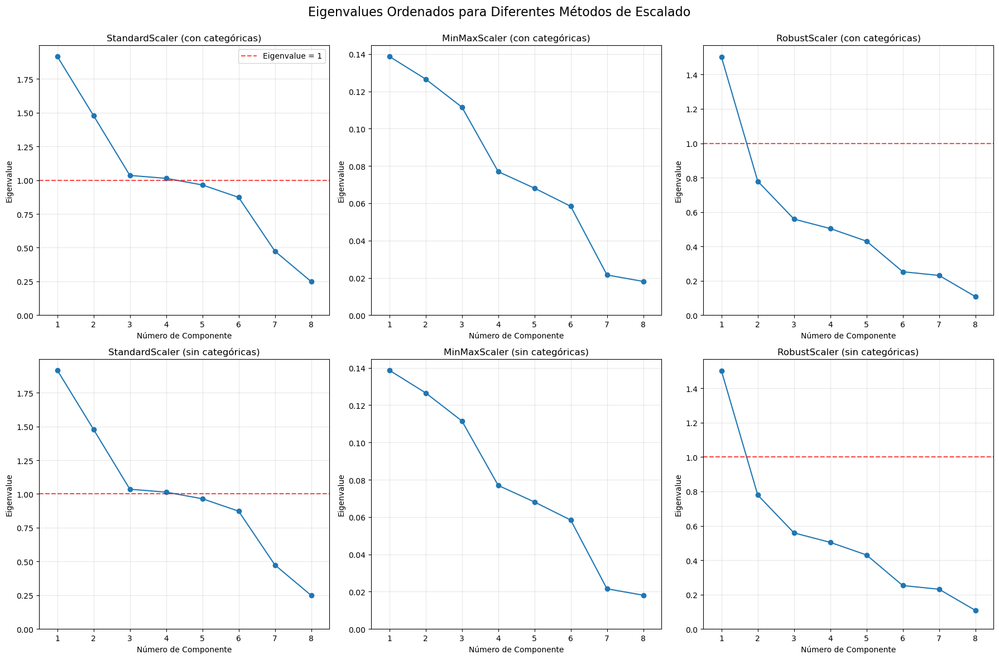

Tabla de Eigenvalues para los Diferentes Métodos de Escalado:


,StandardScaler (con categóricas),MinMaxScaler (con categóricas),RobustScaler (con categóricas),StandardScaler (sin categóricas),MinMaxScaler (sin categóricas),RobustScaler (sin categóricas)
PC1,1.9158,0.1387,1.5007,1.9158,0.1387,1.5007
PC2,1.4771,0.1266,0.7792,1.4771,0.1266,0.7792
PC3,1.0350,0.1115,0.5589,1.0350,0.1115,0.5589
PC4,1.0133,0.0770,0.5038,1.0133,0.0770,0.5038
PC5,0.9644,0.0681,0.4305,0.9644,0.0681,0.4305
PC6,0.8724,0.0584,0.2526,0.8724,0.0584,0.2526
PC7,0.4741,0.0215,0.2312,0.4741,0.0215,0.2312
PC8,0.2489,0.0181,0.1084,0.2489,0.0181,0.1084



Tabla de Porcentaje de Varianza Explicada para los Diferentes Métodos de Escalado:


,StandardScaler (con categóricas),MinMaxScaler (con categóricas),RobustScaler (con categóricas),StandardScaler (sin categóricas),MinMaxScaler (sin categóricas),RobustScaler (sin categóricas)
PC1,23.94%,22.38%,34.38%,23.94%,22.38%,34.38%
PC2,18.46%,20.42%,17.85%,18.46%,20.42%,17.85%
PC3,12.94%,17.99%,12.80%,12.94%,17.99%,12.80%
PC4,12.66%,12.42%,11.54%,12.66%,12.42%,11.54%
PC5,12.05%,10.98%,9.86%,12.05%,10.98%,9.86%
PC6,10.90%,9.42%,5.79%,10.90%,9.42%,5.79%
PC7,5.93%,3.48%,5.30%,5.93%,3.48%,5.30%
PC8,3.11%,2.92%,2.48%,3.11%,2.92%,2.48%


In [27]:
# Visualizar los eigenvalues (valores propios) ordenados para cada método de escalado
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Crear figura con subfiguras para mostrar los eigenvalues ordenados
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Diccionario para almacenar los eigenvalues para la tabla
eigenvalues_dict = {}

# Graficar los eigenvalues para cada método de escalado en su propia subfigura
for name, row, col in plot_order:
    print(name, row, col)
    # Obtener los eigenvalues (varianza explicada * varianza total)
    eigenvalues = pca_results[name]['pca'].explained_variance_
    
    # Ordenar de mayor a menor (ya deberían estar ordenados, pero por seguridad)
    eigenvalues_sorted = np.sort(eigenvalues)[::-1]
    
    # Almacenar para la tabla
    eigenvalues_dict[titles[name]] = eigenvalues_sorted
    
    # Obtener el eje correspondiente
    ax = axes[row, col]
    
    # Graficar en la subfigura correspondiente
    ax.plot(range(1, len(eigenvalues_sorted) + 1), eigenvalues_sorted, 'o-') #, color=colors[name], alpha=0.7, linewidth=2)
    
    # Configurar cada subfigura
    ax.set_xlabel('Número de Componente')
    ax.set_ylabel('Eigenvalue')
    ax.set_title(titles[name], fontsize=12)
    ax.grid(True, alpha=0.3)
    #ax.set_yscale('log')
    ax.set_ylim(bottom=0)  # Escala logarítmica para mejor visualización
    
    # Añadir una línea horizontal en el eigenvalue = 1 (criterio de Kaiser)
    ax.axhline(y=1.0, color='red', linestyle='--', alpha=0.7, label='Eigenvalue = 1')
    
    # Mostrar solo los primeros 20 componentes para mejor visualización
    max_components_to_show = min(20, len(eigenvalues_sorted))
    ax.set_xlim(0.5, max_components_to_show + 0.5)
    
    # Añadir leyenda solo al primer gráfico
    if row == 0 and col == 0:
        ax.legend(loc='best')

plt.suptitle('Eigenvalues Ordenados para Diferentes Métodos de Escalado', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

# Crear una tabla con los eigenvalues para cada método de escalado

# Determinar el número máximo de componentes entre todos los métodos
max_components = max([len(eigenvalues) for eigenvalues in eigenvalues_dict.values()])

# Crear un DataFrame para la tabla
eigenvalues_df = pd.DataFrame(index=[f'PC{i+1}' for i in range(max_components)])

# Llenar el DataFrame con los eigenvalues
for method_name, eigenvalues in eigenvalues_dict.items():
    # Tomar todos los eigenvalues disponibles
    eigenvalues_to_show = eigenvalues
    
    # Crear una lista del tamaño correcto
    padded_values = list(eigenvalues_to_show)
    
    # Rellenar el resto con NaN
    while len(padded_values) < max_components:
        padded_values.append(np.nan)
    
    # Añadir al DataFrame
    eigenvalues_df[method_name] = padded_values

# Mostrar la tabla de eigenvalues
print("Tabla de Eigenvalues para los Diferentes Métodos de Escalado:")
display(eigenvalues_df.style.format("{:.4f}"))

# Crear una tabla con el porcentaje de varianza explicada
variance_explained_df = pd.DataFrame(index=[f'PC{i+1}' for i in range(max_components)])

# Llenar el DataFrame con los porcentajes de varianza explicada
for name, _, _ in plot_order:
    # Obtener la varianza explicada
    explained_variance = pca_results[name]['explained_variance']
    
    # Crear una lista del tamaño correcto
    padded_values = list(explained_variance)
    
    # Rellenar el resto con NaN
    while len(padded_values) < max_components:
        padded_values.append(np.nan)
    
    # Añadir al DataFrame
    variance_explained_df[titles[name]] = padded_values

# Mostrar la tabla de porcentajes de varianza explicada
print("\nTabla de Porcentaje de Varianza Explicada para los Diferentes Métodos de Escalado:")
display(variance_explained_df.style.format("{:.2%}"))

---
**PCA ANALISIS:**

- Realizamos el PCA sobre el dataframe, despues de realizar 3 escalados distintos (a su vez dividido en escalado con las categoricas y sin las categoricas)
- Encontramos que el mejor escalado fue el que se realizo sin las categoricas, ya que nos dio un mejor resultado de la varianza explicada.
- Luego de realizar el PCA, realizamos un grafico de la varianza explicada por cada componente principal, para verificar que el PCA fue correcto.
- El escalado del dataframe con standard scaler, cambia si se escalan o no las variables categoricas. El resultado de no escalar las variables categoricas, es el que mejor resultado dio, utilizando el criterio de la varianza explicada con un 70%.
- El escalado de min y max con ningun criterio es util para este dataframe, e incluso se puede ver como junta los puntos en el grafico 3D lo que implica que no separa bien.
- El escalado robusto (siendo identico para con categoricas o sin categoricas), fue muy satisfactorio para las primeras componentes luego las siguientes componenentes dejan de ser significativas.
- Con el criterio de la varianza explicada es mejor usar standar scaler sin las categoricas.
- Si quisieramos utilizar la regla de Kaiser, con RobustScaler nos quedariamos con 1 sola componente, mientras que con StandardScaler nos quedariamos con 2 o 3 (es muy cercana a 1) componentes. Esto nos indica que RobustScaler seria mejor para describir el sistema reduciendo a una sola componente, sin embargo el StandardScaler produce mejores resultados cuando utilizamos por ejemplo 3 componentes. 

**Es por esto que consideramos que el mejor escalado es el de StandardScaler sin las categoricas, ya que nos da los mejores resultados con todos los criterios.**

---

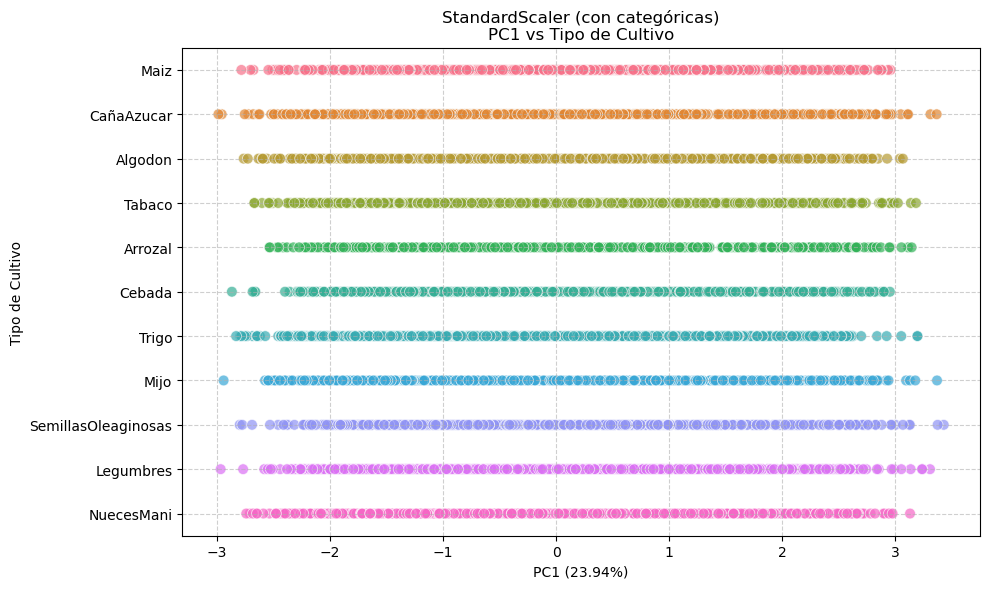

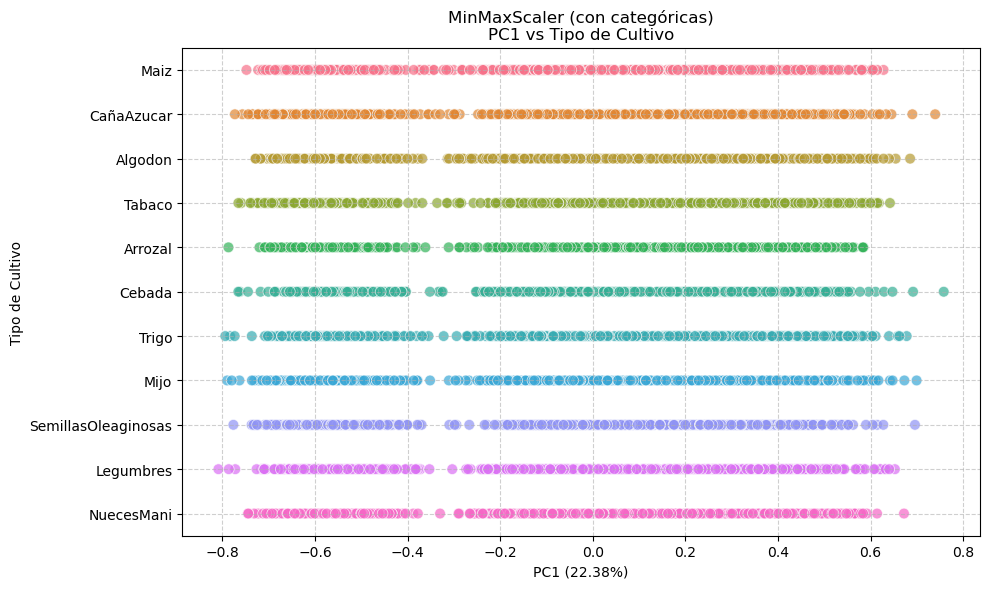

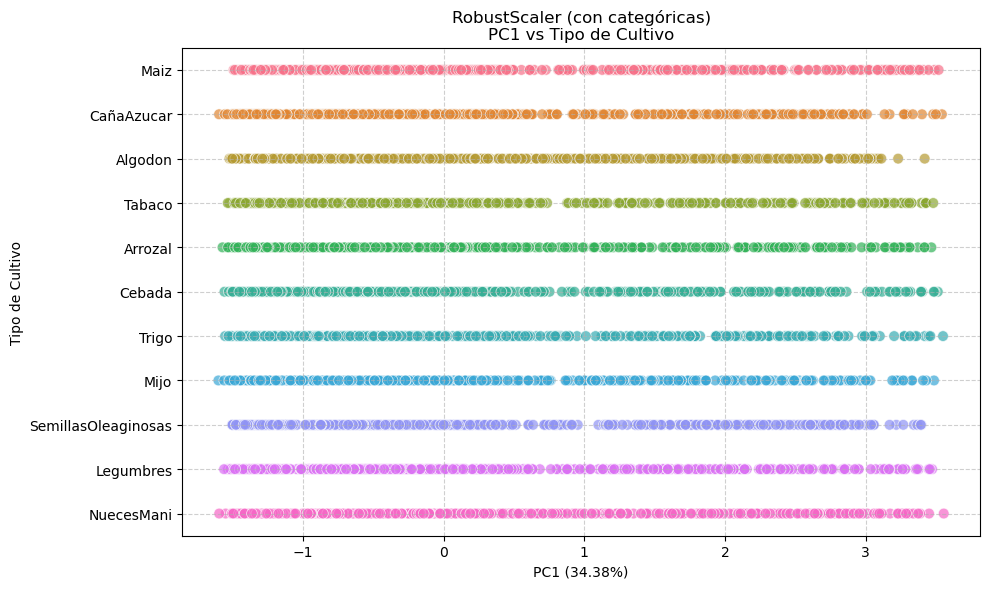

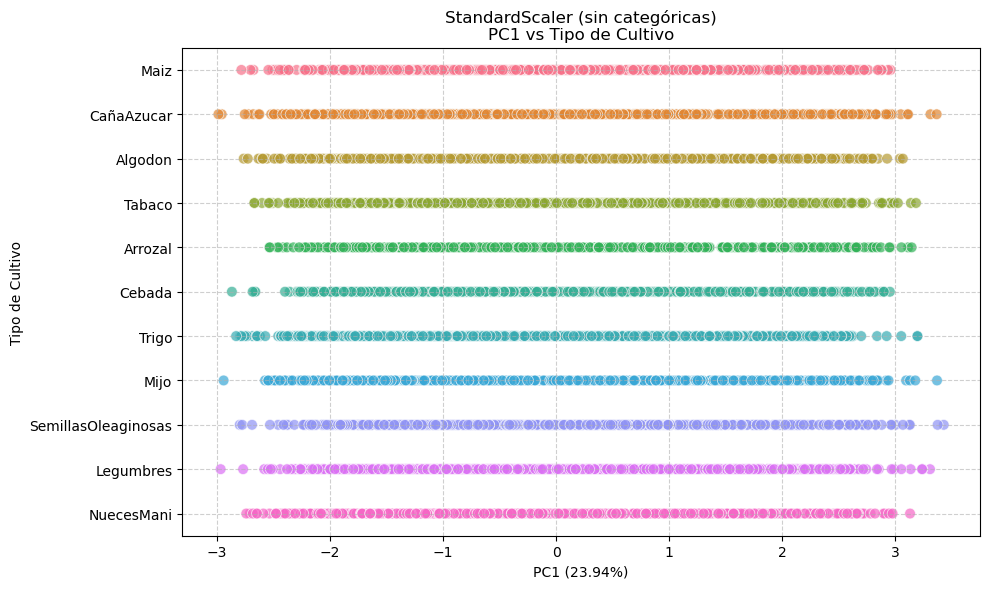

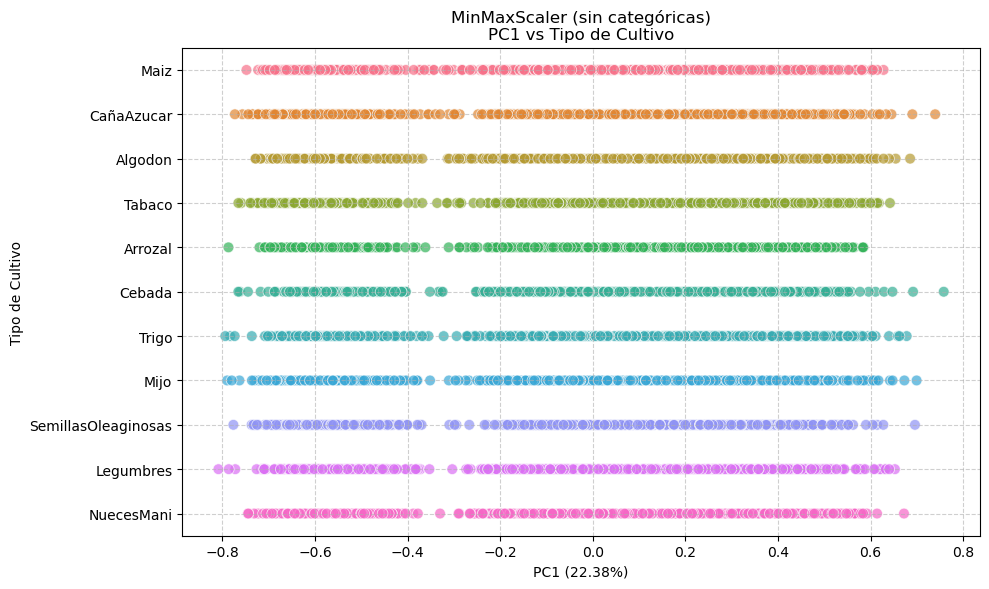

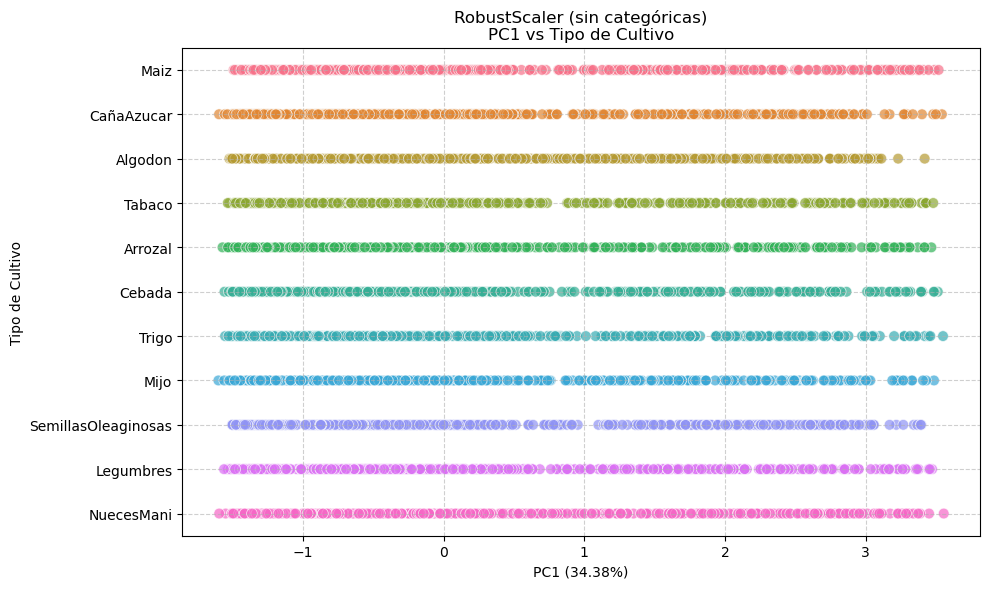

In [28]:
# Crear gráficos 2D con PC1 en el eje X y tipoCultivo en el eje Y
for name, row, col in plot_order:
    data = pca_3d_data[name]  # Get the data for the current scaling method
    
    # Crear una nueva figura para cada método
    plt.figure(figsize=(10, 6))
    
    # Usar seaborn scatterplot para visualización 2D con tipoCultivo en el eje Y
    sns.scatterplot(
        x='PC1',
        y='tipoCultivo',
        hue='tipoCultivo',
        data=data,
        alpha=0.7,
        s=60,  # Larger marker size for better visibility
        legend=False  # No need for legend as y-axis already shows categories
    )
    
    # Configurar el diseño de la figura
    plt.title(f"{titles[name]}\nPC1 vs Tipo de Cultivo")
    plt.xlabel(f"PC1 ({pca_results[name]['explained_variance'][0]:.2%})")
    plt.ylabel("Tipo de Cultivo")
    plt.grid(True, linestyle='--', alpha=0.6)
    
    # Mostrar la figura
    plt.tight_layout()
    plt.show()

---
Si bien la primer componente de PCA con RobustScaler es mejor (de acuerdo al % de varianza) que la de StandardScaler, este metodo no es mejor cuando utilizamos mas de 3 componentes, y vemos que usar usa sola componente no permite separar el sistema en grupos. 


*Por eso la decision final es utilizar StandardScaler sin escalado de categoricas*
---

In [29]:
X_scaled = scaled_data["standard_without_cat"]

---
# EJERCICIO 3
Aplicar Isomap y analizar los resultados obtenidos variando el número de vecinos y 
componentes. Realizar un gráfico en 2D de utilizando dos componentes.

---

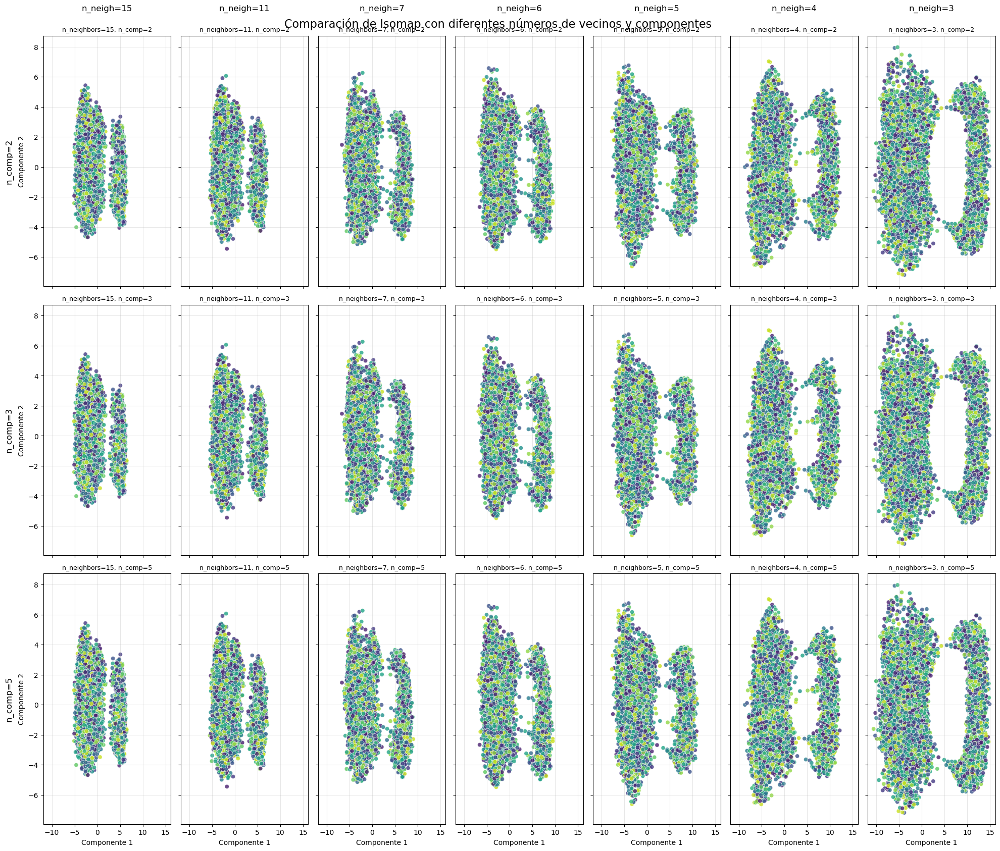


Análisis detallado para la mejor combinación: n_neighbors=3, n_components=2

Estadísticas de las componentes por tipo de cultivo:
                    Componente 1                                           \
                           count      mean       std        min       25%   
tipoCultivo                                                                 
Algodon                    698.0 -0.296313  6.366544 -10.239017 -4.452952   
Arrozal                    678.0  0.105583  6.771794  -9.998485 -4.774097   
CañaAzucar                 738.0  0.140151  6.767286  -9.172900 -4.730303   
Cebada                     674.0 -0.248494  6.552523  -9.202361 -4.886421   
Legumbres                  700.0 -0.089340  6.518537 -10.589806 -4.634407   
Maiz                       728.0  0.129611  6.854507 -10.208458 -5.075528   
Mijo                       700.0  0.422053  6.763059 -10.035853 -4.556464   
NuecesMani                 702.0  0.012808  6.848929  -9.111335 -5.051608   
SemillasOleaginosas   

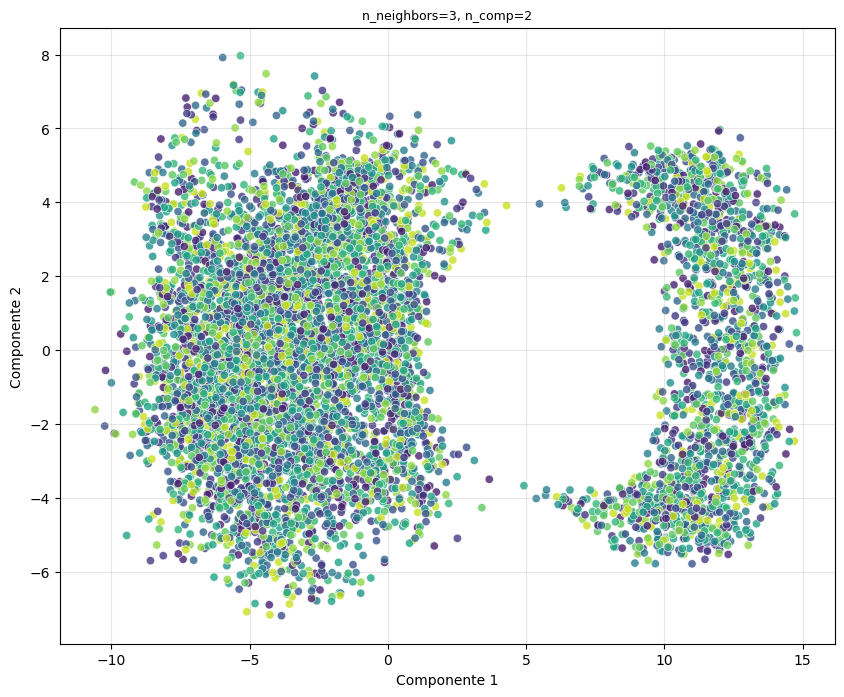

In [30]:
def apply_isomap(X, n_neighbors, n_components, target=None, ax=None, show_plot=True):
    """
    Aplica Isomap y visualiza los resultados
    
    Parámetros:
    -----------
    X : DataFrame o array
        Datos de entrada escalados
    n_neighbors : int
        Número de vecinos a considerar
    n_components : int
        Número de componentes a extraer
    target : Series o array, opcional
        Variable objetivo para colorear los puntos
    ax : matplotlib axis, opcional
        Eje donde graficar (para subplots)
    show_plot : bool, opcional
        Si es True, muestra el plot individual
    """
    # Crear y ajustar el modelo Isomap
    isomap = Isomap(n_neighbors=n_neighbors, n_components=max(2, n_components))
    isomap_result = isomap.fit_transform(X)
    
    # Crear DataFrame con los resultados
    isomap_df = pd.DataFrame(
        data=isomap_result,
        columns=[f'Componente {i+1}' for i in range(max(2, n_components))],
        index=X.index
    )
    
    # Si queremos visualizar los resultados
    if show_plot and n_components >= 1:
        # Si no se proporciona un eje, crear una nueva figura
        if ax is None:
            plt.figure(figsize=(10, 8))
            ax = plt.gca()
        
        if target is not None:
            # Usar seaborn para graficar con colores según la variable objetivo
            if n_components == 1:
                # Para 1 componente, crear un gráfico 1D
                sns.scatterplot(
                    x='Componente 1', 
                    y=np.zeros(len(isomap_df)),  # Todos los puntos en y=0
                    data=isomap_df, 
                    hue=target,
                    palette='viridis', 
                    alpha=0.8,
                    ax=ax
                )
                ax.set_yticks([])  # Quitar ticks del eje y
                ax.set_ylabel('')  # Quitar etiqueta del eje y
            else:
                # Para 2 o más componentes, mostrar las primeras 2 componentes
                sns.scatterplot(
                    x='Componente 1', 
                    y='Componente 2', 
                    data=isomap_df, 
                    hue=target,
                    palette='viridis', 
                    alpha=0.8,
                    legend=False,  # No mostrar leyenda en cada subplot
                    ax=ax
                )
        else:
            # Graficar sin colores específicos
            if n_components == 1:
                ax.scatter(isomap_df['Componente 1'], np.zeros(len(isomap_df)), alpha=0.8)
                ax.set_yticks([])
                ax.set_ylabel('')
            else:
                ax.scatter(isomap_df['Componente 1'], isomap_df['Componente 2'], alpha=0.8)
        
        ax.set_title(f'n_neighbors={n_neighbors}, n_comp={n_components}', fontsize=9)
        ax.set_xlabel('Componente 1')
        if n_components > 1:
            ax.set_ylabel('Componente 2')
        ax.grid(True, alpha=0.3)
        
        # Si es un plot individual, mostrar
        if ax is None:
            plt.tight_layout()
            plt.show()
    
    return isomap, isomap_df

# Definir los valores a probar
neighbors_to_try = [15,11,7,6,5,4,3]
components_to_try = [2, 3, 5]

# Crear una figura grande con subplots para todas las combinaciones
fig, axes = plt.subplots(len(components_to_try), len(neighbors_to_try), 
                         figsize=(20, 18), 
                         sharex=True, sharey='row')

# Título general
fig.suptitle('Comparación de Isomap con diferentes números de vecinos y componentes', 
             fontsize=16, y=0.92)

# Etiquetas para las filas (componentes)
for i, n_comp in enumerate(components_to_try):
    axes[i, 0].text(-0.3, 0.5, f'n_comp={n_comp}', 
                    rotation=90, verticalalignment='center', 
                    fontsize=12, transform=axes[i, 0].transAxes)

# Etiquetas para las columnas (vecinos)
for j, n_neigh in enumerate(neighbors_to_try):
    axes[0, j].text(0.5, 1.1, f'n_neigh={n_neigh}', 
                   horizontalalignment='center', 
                   fontsize=12, transform=axes[0, j].transAxes)

# Aplicar Isomap para cada combinación
for i, n_components in enumerate(components_to_try):
    for j, n_neighbors in enumerate(neighbors_to_try):
        try:
            # Aplicar Isomap y graficar en el subplot correspondiente
            _, _ = apply_isomap(X_scaled, 
                               n_neighbors=n_neighbors, 
                               n_components=n_components, 
                               target=df_crude['tipoCultivo'], 
                               ax=axes[i, j], 
                               show_plot=True)
        except Exception as e:
            # En caso de error, mostrar mensaje en el subplot
            axes[i, j].text(0.5, 0.5, f"Error: {str(e)[:50]}...", 
                           horizontalalignment='center',
                           verticalalignment='center',
                           transform=axes[i, j].transAxes,
                           color='red')
            axes[i, j].set_title(f'n_neighbors={n_neighbors}, n_comp={n_components}', fontsize=9)

# Añadir una leyenda común para todos los subplots
handles, labels = axes[0, 0].get_legend_handles_labels()
if handles:
    fig.legend(handles, labels, loc='upper right', title='Tipo de Cultivo', bbox_to_anchor=(0.99, 0.91))

# Ajustar el layout
plt.tight_layout()
plt.subplots_adjust(top=0.9, left=0.05)
plt.show()

# Mostrar un análisis más detallado para la mejor combinación encontrada
# (Esto se puede ajustar después de ver la matriz de gráficos)
best_n_neighbors = 3  # Ajustar según los resultados observados
best_n_components = 2  # Ajustar según los resultados observados

print(f"\nAnálisis detallado para la mejor combinación: n_neighbors={best_n_neighbors}, n_components={best_n_components}")
isomap, isomap_df = apply_isomap(X_scaled, 
                                n_neighbors=best_n_neighbors, 
                                n_components=best_n_components, 
                                target=df_crude['tipoCultivo'])

# Añadir la columna de tipo de cultivo al DataFrame para análisis adicionales
isomap_df['tipoCultivo'] = df_crude['tipoCultivo']

# Mostrar estadísticas por tipo de cultivo
print("\nEstadísticas de las componentes por tipo de cultivo:")
print(isomap_df.groupby('tipoCultivo')[['Componente 1', 'Componente 2']].describe())

---
# EJERCICIO 4
Aplicar t-SNE y analizar los resultados obtenidos variando el número de iteraciones, 
componentes y perplejidad. Realizar un gráfico en 2D de utilizando dos componentes.

---

In [31]:
def apply_tsne(X, n_components, perplexity, n_iter, target=None, random_state=42):
    """
    Aplica t-SNE y visualiza los resultados
    
    Parámetros:
    -----------
    X : DataFrame o array
        Datos de entrada escalados
    n_components : int
        Número de componentes a extraer
    perplexity : float
        Perplejidad para t-SNE (balance entre estructura local y global)
    n_iter : int
        Número de iteraciones
    target : Series o array, opcional
        Variable objetivo para colorear los puntos
    random_state : int
        Semilla para reproducibilidad
    """
    # Medir tiempo de ejecución
    start_time = time.time()
    
    # Crear y ajustar el modelo t-SNE
    tsne = TSNE(
        n_components=n_components,
        perplexity=perplexity,
        max_iter=n_iter,
        random_state=random_state,
        verbose=1
    )
    tsne_result = tsne.fit_transform(X)
    
    # Calcular tiempo de ejecución
    execution_time = time.time() - start_time
    
    # Crear DataFrame con los resultados
    tsne_df = pd.DataFrame(
        data=tsne_result,
        columns=[f'Componente {i+1}' for i in range(n_components)],
        index=X.index
    )
    
    # Si solo queremos visualizar 2 componentes
    if n_components >= 2:
        plt.figure(figsize=(10, 8))
        
        if target is not None:
            # Usar seaborn para graficar con colores según la variable objetivo
            sns.scatterplot(
                x='Componente 1', 
                y='Componente 2', 
                data=tsne_df, 
                hue=target,
                palette='viridis', 
                alpha=0.8
            )
            plt.legend(title='Tipo de Cultivo', bbox_to_anchor=(1.05, 1), loc='upper left')
        else:
            # Graficar sin colores específicos
            plt.scatter(tsne_df['Componente 1'], tsne_df['Componente 2'], alpha=0.8)
        
        plt.title(f't-SNE (perplexity={perplexity}, n_iter={n_iter})')
        plt.xlabel('Componente 1')
        plt.ylabel('Componente 2')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    print(f"Tiempo de ejecución: {execution_time:.2f} segundos")
    return tsne, tsne_df

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and

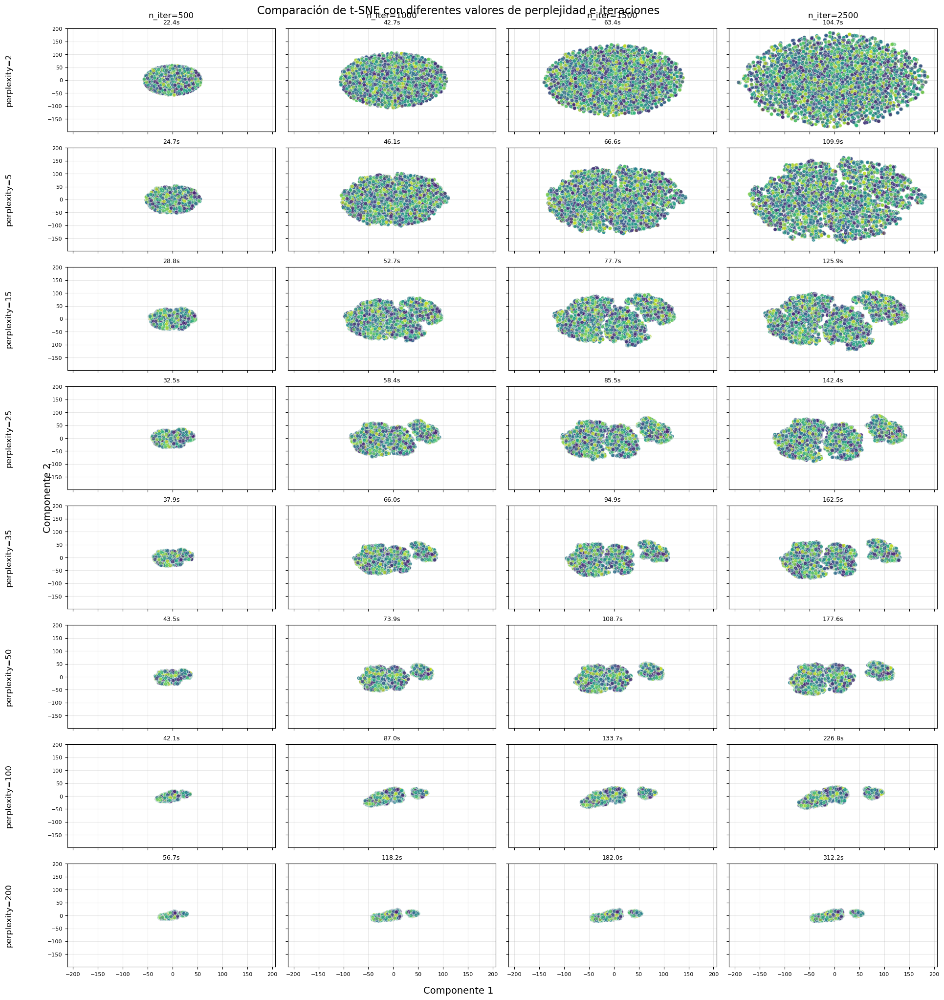

In [32]:
# Definir los valores a probar
iterations_to_try = [500, 1000, 1500, 2500]
perplexities_to_try = [2, 5, 15, 25, 35, 50, 100, 200]

# Crear una figura grande con subplots
fig, axes = plt.subplots(len(perplexities_to_try), len(iterations_to_try), 
                         figsize=(20, 24), sharex=True, sharey=True)

# Título general
fig.suptitle('Comparación de t-SNE con diferentes valores de perplejidad e iteraciones', 
             fontsize=16, y=0.92)

# Etiquetas para las filas (perplejidad)
for i, perplexity in enumerate(perplexities_to_try):
    axes[i, 0].text(-0.3, 0.5, f'perplexity={perplexity}', 
                    rotation=90, verticalalignment='center', 
                    fontsize=12, transform=axes[i, 0].transAxes)

# Etiquetas para las columnas (iteraciones)
for j, n_iter in enumerate(iterations_to_try):
    axes[0, j].text(0.5, 1.1, f'n_iter={n_iter}', 
                   horizontalalignment='center', 
                   fontsize=12, transform=axes[0, j].transAxes)

# Aplicar t-SNE para cada combinación de parámetros
for i, perplexity in enumerate(perplexities_to_try):
    for j, n_iter in enumerate(iterations_to_try):
        ax = axes[i, j]
        
        try:
            # Medir tiempo de ejecución
            start_time = time.time()
            
            # Crear y ajustar el modelo t-SNE con menos verbosidad
            tsne = TSNE(
                n_components=2,
                perplexity=perplexity,
                n_iter=n_iter,
                random_state=42,
                verbose=0  # Reducir verbosidad para no saturar la salida
            )
            tsne_result = tsne.fit_transform(X_scaled)
            
            # Calcular tiempo de ejecución
            execution_time = time.time() - start_time
            
            # Crear DataFrame con los resultados
            tsne_df = pd.DataFrame(
                data=tsne_result,
                columns=['Componente 1', 'Componente 2'],
                index=X_scaled.index
            )
            
            # Graficar en el subplot correspondiente
            sns.scatterplot(
                x='Componente 1', 
                y='Componente 2', 
                data=tsne_df, 
                hue=df_crude['tipoCultivo'],
                palette='viridis', 
                alpha=0.7,
                s=30,  # Tamaño de punto más pequeño para la matriz
                legend=False,  # No mostrar leyenda en cada subplot
                ax=ax
            )
            
            # Configurar el subplot
            ax.set_title(f"{execution_time:.1f}s", fontsize=9)
            ax.set_xlabel('')
            ax.set_ylabel('')
            ax.grid(True, alpha=0.3)
            ax.tick_params(labelsize=8)
            
        except Exception as e:
            # En caso de error, mostrar mensaje en el subplot
            ax.text(0.5, 0.5, f"Error: {str(e)[:50]}...", 
                   horizontalalignment='center',
                   verticalalignment='center',
                   transform=ax.transAxes,
                   color='red')
            ax.set_title(f"perp={perplexity}, iter={n_iter}", fontsize=9)

# Añadir una leyenda común para todos los subplots
handles, labels = axes[0, 0].get_legend_handles_labels()
if handles:
    fig.legend(handles, labels, loc='upper right', title='Tipo de Cultivo', 
               bbox_to_anchor=(0.99, 0.91))

# Añadir etiquetas de ejes comunes
fig.text(0.5, 0.08, 'Componente 1', ha='center', va='center', fontsize=14)
fig.text(0.08, 0.5, 'Componente 2', ha='center', va='center', rotation='vertical', fontsize=14)

# Ajustar el layout
plt.tight_layout()
plt.subplots_adjust(top=0.9, left=0.1, bottom=0.1)
plt.show()


Análisis detallado para la mejor combinación encontrada:
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7708 samples in 0.021s...
[t-SNE] Computed neighbors for 7708 samples in 0.917s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7708
[t-SNE] Computed conditional probabilities for sample 2000 / 7708
[t-SNE] Computed conditional probabilities for sample 3000 / 7708
[t-SNE] Computed conditional probabilities for sample 4000 / 7708
[t-SNE] Computed conditional probabilities for sample 5000 / 7708
[t-SNE] Computed conditional probabilities for sample 6000 / 7708
[t-SNE] Computed conditional probabilities for sample 7000 / 7708
[t-SNE] Computed conditional probabilities for sample 7708 / 7708
[t-SNE] Mean sigma: 0.716501
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.533325
[t-SNE] KL divergence after 2500 iterations: 1.799869


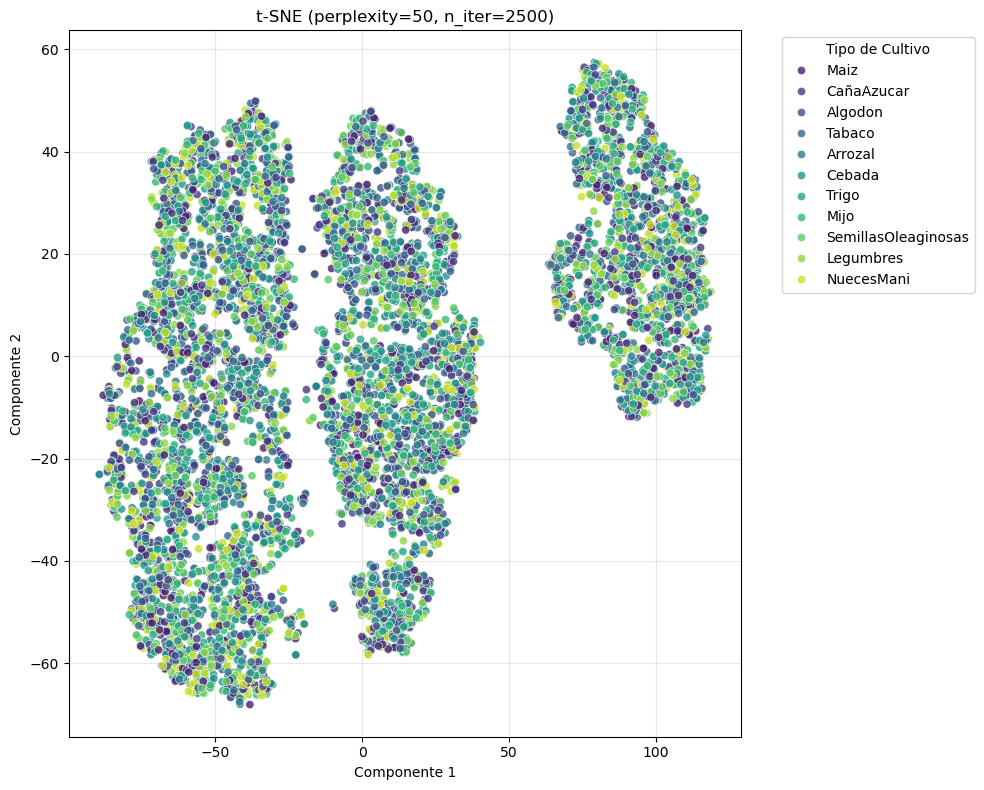

Tiempo de ejecución: 174.81 segundos


In [33]:
# Mostrar un análisis detallado para la mejor combinación encontrada
# (Esto se puede ajustar después de ver la matriz de gráficos)
print("\nAnálisis detallado para la mejor combinación encontrada:")
best_perplexity = 50  # Ajustar según los resultados observados
best_n_iter = 2500    # Ajustar según los resultados observados

# Aplicar t-SNE con los mejores parámetros y mostrar un gráfico más grande
_, best_tsne_df = apply_tsne(
    X_scaled, 
    n_components=2, 
    perplexity=best_perplexity, 
    n_iter=best_n_iter, 
    target=df_crude['tipoCultivo']
)

---
# PRE EJERCICIO 5
Ahora, realizar un subconjunto de los datos considerando solamente estos tipos de
cultivos: Maíz, Cebada, Trigo

---


### Pregunta: Conviene obtener el subconjunto y escalar, o simplemente hacer un subconjunto de lo ya escalado?

Dimensiones del dataset original escalado: (7708, 8)
Dimensiones del subset escalado: (2118, 8)

Distribución de cultivos en el subset:
tipoCultivo
Maiz      728
Trigo     716
Cebada    674
Name: count, dtype: int64


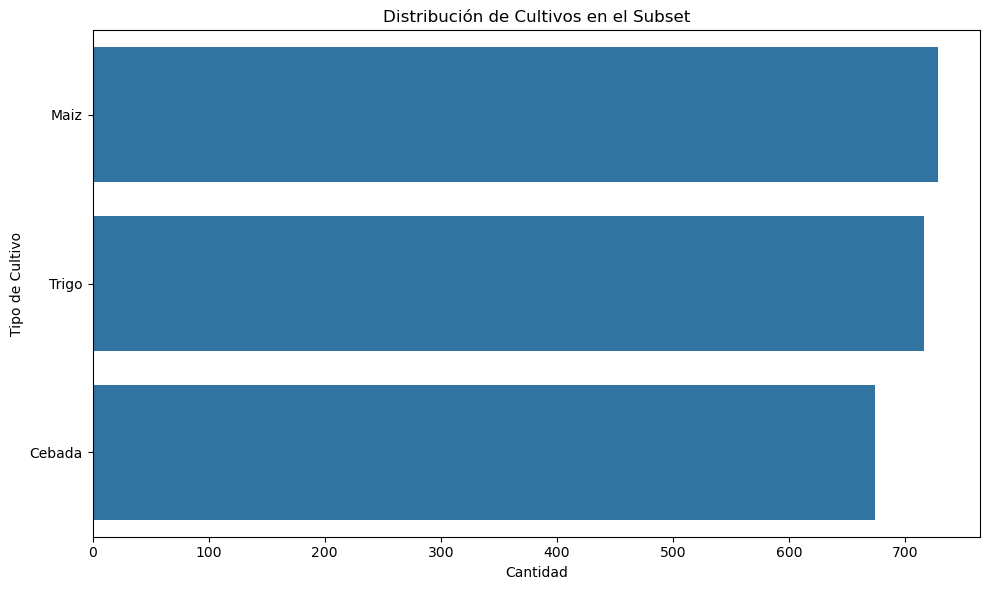


Primeras filas del subset escalado:


,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,-0.977684,-0.884875,-0.450498,-0.702541,1.532457,-0.717877,-1.380169,1.485255
5,-0.977684,-0.884875,-0.687286,-0.702541,-0.576936,1.447920,-0.414600,-0.504464
7,0.589690,0.585350,0.496653,0.002194,1.869960,-0.717877,-1.380169,1.485255
11,0.141869,0.340312,0.338794,-0.702541,-0.408185,2.530818,-0.488874,-0.504464
17,-1.201594,-1.129912,-0.371569,-0.702541,0.182446,-0.717877,0.031047,0.490395


In [34]:
# Crear un subconjunto de datos con solo Maíz, Cebada y Trigo
selected_crops = ['Maiz', 'Cebada', 'Trigo']

# Obtener los índices actuales en X_scaled
current_indices = X_scaled.index

# Filtrar el dataframe original pero solo considerando los índices que existen en X_scaled
# Esto maneja el caso donde algunas filas fueron eliminadas previamente (ej: Potasio > 17.5)
valid_indices = df_crude.loc[current_indices]
selected_indices = valid_indices[valid_indices['tipoCultivo'].isin(selected_crops)].index

# Obtener el subconjunto de datos ya escalados usando los índices
X_subset_scaled = X_scaled.loc[selected_indices]

# Obtener las etiquetas correspondientes
y_subset = df_crude.loc[selected_indices, 'tipoCultivo']

# Verificar el resultado
print(f"Dimensiones del dataset original escalado: {X_scaled.shape}")
print(f"Dimensiones del subset escalado: {X_subset_scaled.shape}")

# Verificar la distribución de cultivos en el subset
crop_counts = y_subset.value_counts()
print("\nDistribución de cultivos en el subset:")
print(crop_counts)

# Visualizar la distribución
plt.figure(figsize=(10, 6))
sns.countplot(y=y_subset, order=crop_counts.index)
plt.title('Distribución de Cultivos en el Subset')
plt.xlabel('Cantidad')
plt.ylabel('Tipo de Cultivo')
plt.tight_layout()
plt.show()

print("\nPrimeras filas del subset escalado:")
X_subset_scaled.head()

In [35]:
X_subset_scaled

,temperatura,humedad,aguaEnSuelo,tipoSuelo,nitrogeno,potasio,fosforo,nombreFertilizante
0,-0.977684,-0.884875,-0.450498,-0.702541,1.532457,-0.717877,-1.380169,1.485255
5,-0.977684,-0.884875,-0.687286,-0.702541,-0.576936,1.447920,-0.414600,-0.504464
7,0.589690,0.585350,0.496653,0.002194,1.869960,-0.717877,-1.380169,1.485255
11,0.141869,0.340312,0.338794,-0.702541,-0.408185,2.530818,-0.488874,-0.504464
17,-1.201594,-1.129912,-0.371569,-0.702541,0.182446,-0.717877,0.031047,0.490395
...,...,...,...,...,...,...,...,...
7983,-0.641818,-1.583231,-0.411034,-0.702541,-0.323809,-0.068138,-0.563149,-1.001894
7985,1.523396,-0.392349,1.485637,-1.407276,-0.576936,-0.717877,1.145165,-1.001894
7986,-1.414309,-1.553827,-0.086634,0.706930,0.098070,-0.717877,-0.043227,1.485255
7996,2.020478,1.525068,0.444560,0.706930,1.363706,-0.717877,-1.380169,-1.499323


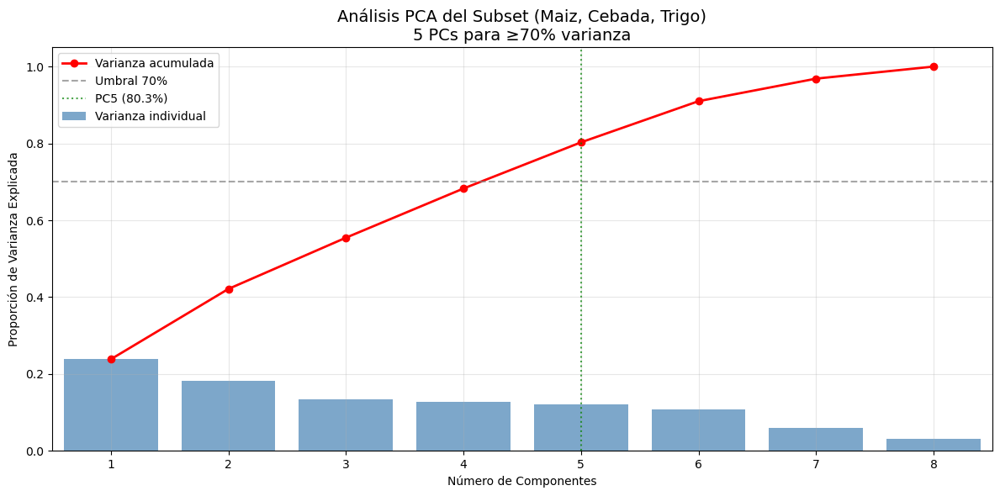

Número de componentes necesarios para explicar al menos el 70% de la varianza: 5

Varianza explicada por las primeras componentes principales:


,Componente,Varianza Individual (%),Varianza Acumulada (%)
0,PC1,23.83%,23.83%
1,PC2,18.30%,42.13%
2,PC3,13.34%,55.46%
3,PC4,12.80%,68.26%
4,PC5,12.02%,80.28%
5,PC6,10.72%,91.00%
6,PC7,5.87%,96.86%
7,PC8,3.14%,100.00%



Primeras filas del dataset transformado con PCA:


,PC1,PC2,PC3,PC4,PC5,tipoCultivo
0,2.596152,-0.424577,0.515350,-0.160565,1.409943,Maiz
5,-0.050244,-1.734553,-1.081144,-0.172389,-0.132336,Cebada
7,1.850841,1.641454,0.966766,0.800871,1.025834,Trigo
11,-1.070782,-0.421100,-1.353059,1.092940,-0.119186,Maiz
17,1.093135,-1.251493,-0.026112,-0.683965,0.861937,Cebada


In [36]:
# Realizar PCA sobre el subset de datos
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

# Crear y ajustar PCA
pca_subset = PCA()
pca_result_subset = pca_subset.fit_transform(X_subset_scaled)

# Obtener la varianza explicada
explained_variance = pca_subset.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Determinar cuántas componentes son necesarias para explicar al menos el 70% de la varianza
n_components_70 = np.argmax(cumulative_variance >= 0.7) + 1

# Visualizar la varianza explicada
plt.figure(figsize=(12, 6))

# Gráfico de barras para la varianza individual
plt.bar(
    range(1, len(explained_variance) + 1),
    explained_variance,
    alpha=0.7,
    color='steelblue',
    label='Varianza individual'
)

# Gráfico de línea para la varianza acumulada
plt.plot(
    range(1, len(cumulative_variance) + 1),
    cumulative_variance,
    'o-',
    color='red',
    linewidth=2,
    label='Varianza acumulada'
)

# Añadir línea horizontal en el 70% de varianza
plt.axhline(y=0.7, color='gray', linestyle='--', alpha=0.7, label='Umbral 70%')

# Añadir línea vertical en el número de componentes para 70%
plt.axvline(x=n_components_70, color='green', linestyle=':', alpha=0.7, 
           label=f'PC{n_components_70} ({cumulative_variance[n_components_70-1]:.1%})')

# Configurar el gráfico
plt.title(f'Análisis PCA del Subset (Maiz, Cebada, Trigo)\n{n_components_70} PCs para ≥70% varianza', fontsize=14)
plt.xlabel('Número de Componentes')
plt.ylabel('Proporción de Varianza Explicada')
plt.grid(True, alpha=0.3)
plt.legend(loc='best')
plt.xticks(range(1, len(explained_variance) + 1))
plt.xlim(0.5, min(20, len(explained_variance)) + 0.5)  # Mostrar solo hasta 20 componentes para mejor visualización
plt.ylim(0, 1.05)

plt.tight_layout()
plt.show()

# Mostrar tabla con la varianza explicada por cada componente
variance_df = pd.DataFrame({
    'Componente': [f'PC{i+1}' for i in range(len(explained_variance))],
    'Varianza Individual (%)': explained_variance * 100,
    'Varianza Acumulada (%)': cumulative_variance * 100
})

print(f"Número de componentes necesarios para explicar al menos el 70% de la varianza: {n_components_70}")
print("\nVarianza explicada por las primeras componentes principales:")
display(variance_df.head(10).style.format({
    'Varianza Individual (%)': '{:.2f}%',
    'Varianza Acumulada (%)': '{:.2f}%'
}))

# Guardar las primeras n_components_70 componentes principales
X_subset_pca = pd.DataFrame(
    data=pca_result_subset[:, :n_components_70],
    columns=[f'PC{i+1}' for i in range(n_components_70)],
    index=X_subset_scaled.index
)

# Añadir la variable objetivo para análisis posteriores
X_subset_pca['tipoCultivo'] = y_subset

# Mostrar las primeras filas del dataset transformado
print("\nPrimeras filas del dataset transformado con PCA:")
display(X_subset_pca.head())

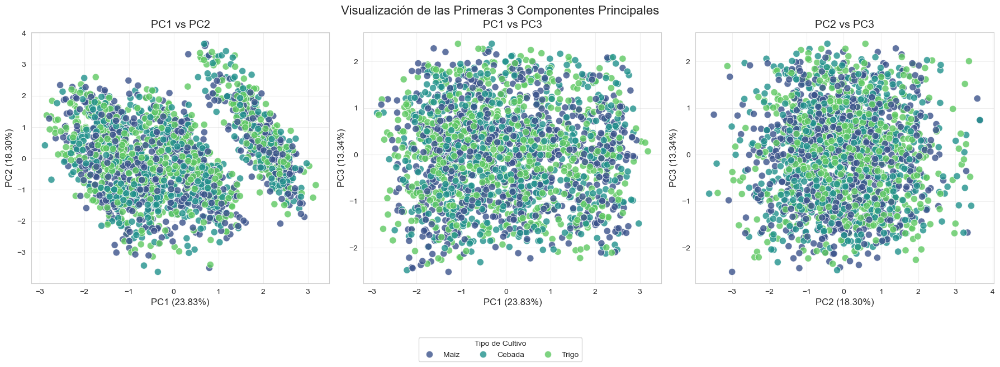

In [37]:
# Crear gráficos de dispersión para las primeras 3 componentes principales
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar el estilo de seaborn
sns.set_style("whitegrid")

# Crear una figura con 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# PC1 vs PC2
sns.scatterplot(
    x='PC1', 
    y='PC2', 
    hue='tipoCultivo',
    data=X_subset_pca,
    palette='viridis',
    s=80,
    alpha=0.8,
    ax=axes[0]
)
axes[0].set_title('PC1 vs PC2', fontsize=14)
axes[0].set_xlabel(f'PC1 ({explained_variance[0]:.2%})', fontsize=12)
axes[0].set_ylabel(f'PC2 ({explained_variance[1]:.2%})', fontsize=12)
axes[0].grid(True, alpha=0.3)

# PC1 vs PC3
sns.scatterplot(
    x='PC1', 
    y='PC3', 
    hue='tipoCultivo',
    data=X_subset_pca,
    palette='viridis',
    s=80,
    alpha=0.8,
    ax=axes[1]
)
axes[1].set_title('PC1 vs PC3', fontsize=14)
axes[1].set_xlabel(f'PC1 ({explained_variance[0]:.2%})', fontsize=12)
axes[1].set_ylabel(f'PC3 ({explained_variance[2]:.2%})', fontsize=12)
axes[1].grid(True, alpha=0.3)

# PC2 vs PC3
sns.scatterplot(
    x='PC2', 
    y='PC3', 
    hue='tipoCultivo',
    data=X_subset_pca,
    palette='viridis',
    s=80,
    alpha=0.8,
    ax=axes[2]
)
axes[2].set_title('PC2 vs PC3', fontsize=14)
axes[2].set_xlabel(f'PC2 ({explained_variance[1]:.2%})', fontsize=12)
axes[2].set_ylabel(f'PC3 ({explained_variance[2]:.2%})', fontsize=12)
axes[2].grid(True, alpha=0.3)

# Ajustar la leyenda para que aparezca solo una vez
handles, labels = axes[2].get_legend_handles_labels()
for ax in axes:
    ax.get_legend().remove()
fig.legend(handles, labels, title='Tipo de Cultivo', loc='upper center', bbox_to_anchor=(0.5, 0), ncol=3)

# Ajustar el layout
plt.suptitle('Visualización de las Primeras 3 Componentes Principales', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.15)
plt.show()

In [38]:
# Crear el gráfico 3D interactivo
fig = px.scatter_3d(
    X_subset_pca, 
    x='PC1', 
    y='PC2', 
    z='PC3',
    color='tipoCultivo',
    labels={
        'PC1': f'PC1 ({explained_variance[0]:.2%})',
        'PC2': f'PC2 ({explained_variance[1]:.2%})',
        'PC3': f'PC3 ({explained_variance[2]:.2%})'
    },
    title='Visualización 3D de las Primeras 3 Componentes Principales',
    opacity=0.8,
    color_discrete_sequence=px.colors.qualitative.Vivid  # Changed from Viridis to Vivid
)

# Personalizar el gráfico
fig.update_layout(
    scene=dict(
        xaxis_title=f'PC1 ({explained_variance[0]:.2%})',
        yaxis_title=f'PC2 ({explained_variance[1]:.2%})',
        zaxis_title=f'PC3 ({explained_variance[2]:.2%})'
    ),
    legend_title_text='Tipo de Cultivo',
    width=900,
    height=700,
    margin=dict(l=0, r=0, b=0, t=40)
)

# Mostrar el gráfico interactivo
fig.show()

NameError: name 'px' is not defined

In [39]:
X_kmeans = X_subset_pca.drop('tipoCultivo', axis=1)

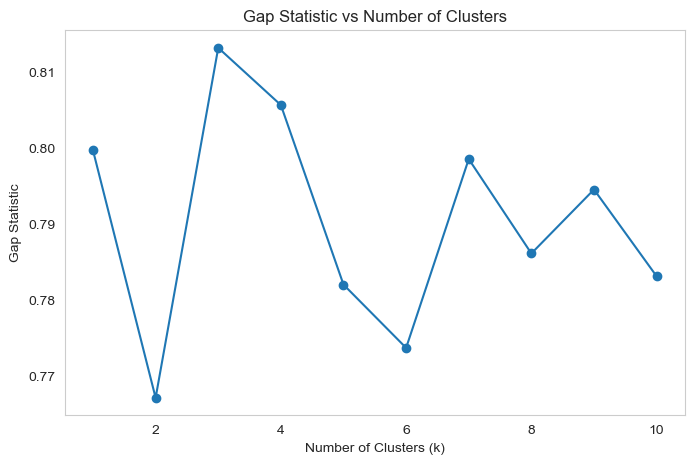

Optimal number of clusters: 2


In [40]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

def compute_gap_statistic(X, k_max, n_replicates=10):
    """
    Compute the Gap Statistic for a range of cluster numbers.

    Parameters:
    X: array-like, shape (n_samples, n_features)
        The input data.
    k_max: int
        The maximum number of clusters to evaluate.
    n_replicates: int
        The number of bootstrap samples.

    Returns:
    gap_values: list
        The calculated gap values for each k.
    """
    # Generate reference data from a uniform distribution
    def generate_reference_data(X):
        return np.random.uniform(low=X.min(axis=0), high=X.max(axis=0), size=X.shape)

    gap_values = []
    
    for k in range(1, k_max + 1):
        # Fit KMeans to the original data
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(X)
        original_inertia = kmeans.inertia_

        # Compute the average inertia for the reference datasets
        reference_inertia = []
        for _ in range(n_replicates):
            random_data = generate_reference_data(X)
            kmeans.fit(random_data)
            reference_inertia.append(kmeans.inertia_)

        # Calculate the Gap statistic
        gap = np.log(np.mean(reference_inertia)) - np.log(original_inertia)
        gap_values.append(gap)

    return gap_values

# Example usage
X = X_kmeans
k_max = 10
gap_values = compute_gap_statistic(X, k_max)

# Plotting the Gap Statistic
plt.figure(figsize=(8, 5))
plt.plot(range(1, k_max + 1), gap_values, marker='o')
plt.title('Gap Statistic vs Number of Clusters')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Gap Statistic')
plt.grid()
plt.show()

# Find the optimal number of clusters (k) based on the Gap Statistic
optimal_k = np.argmax(np.diff(gap_values)) + 1  # Adding 1 as index starts from 0
print(f"Optimal number of clusters: {optimal_k}")

# Perform K-means with the optimal number of clusters
kmeans_optimal = KMeans(n_clusters=optimal_k)
clusters = kmeans_optimal.fit_predict(X_kmeans)




In [41]:
X_kmeans

,PC1,PC2,PC3,PC4,PC5
0,2.596152,-0.424577,0.515350,-0.160565,1.409943
5,-0.050244,-1.734553,-1.081144,-0.172389,-0.132336
7,1.850841,1.641454,0.966766,0.800871,1.025834
11,-1.070782,-0.421100,-1.353059,1.092940,-0.119186
17,1.093135,-1.251493,-0.026112,-0.683965,0.861937
...,...,...,...,...,...
7983,0.849306,-1.414519,-1.165092,-0.407174,-0.314188
7985,-1.100391,0.801458,-1.519521,0.246466,0.578064
7986,1.181757,-1.743667,1.604343,-0.098027,0.702214
7996,0.874154,3.042963,-0.463143,0.733645,-1.633184


In [42]:
# Añadir las etiquetas de cluster al dataframe
X_kmeans['Cluster'] = clusters

# Visualizar los clusters en 3D
import plotly.express as px

fig = px.scatter_3d(
    X_kmeans, 
    x='PC1', 
    y='PC2', 
    z='PC3',
    color='Cluster',
    labels={
        'PC1': f'PC1 ({explained_variance[0]:.2%})',
        'PC2': f'PC2 ({explained_variance[1]:.2%})',
        'PC3': f'PC3 ({explained_variance[2]:.2%})'
    },
    title=f'Visualización 3D de Clusters (K-means, k={optimal_k})',
    opacity=0.8
)

fig.update_layout(
    scene=dict(
        xaxis_title=f'PC1 ({explained_variance[0]:.2%})',
        yaxis_title=f'PC2 ({explained_variance[1]:.2%})',
        zaxis_title=f'PC3 ({explained_variance[2]:.2%})'
    ),
    width=900,
    height=700,
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

Para n_clusters = 2:
  Inercia: 10562.44
  Índice de silueta: 0.197
  Índice de Calinski-Harabasz: 574.58
  Índice de Davies-Bouldin: 1.843

Para n_clusters = 3:
  Inercia: 9032.94
  Índice de silueta: 0.181
  Índice de Calinski-Harabasz: 514.85
  Índice de Davies-Bouldin: 1.809

Para n_clusters = 4:
  Inercia: 8093.18
  Índice de silueta: 0.177
  Índice de Calinski-Harabasz: 464.73
  Índice de Davies-Bouldin: 1.652

Para n_clusters = 5:
  Inercia: 7504.72
  Índice de silueta: 0.170
  Índice de Calinski-Harabasz: 417.12
  Índice de Davies-Bouldin: 1.635

Para n_clusters = 6:
  Inercia: 6927.61
  Índice de silueta: 0.170
  Índice de Calinski-Harabasz: 396.52
  Índice de Davies-Bouldin: 1.672

Para n_clusters = 7:
  Inercia: 6503.90
  Índice de silueta: 0.168
  Índice de Calinski-Harabasz: 374.70
  Índice de Davies-Bouldin: 1.637

Para n_clusters = 8:
  Inercia: 6169.96
  Índice de silueta: 0.170
  Índice de Calinski-Harabasz: 354.71
  Índice de Davies-Bouldin: 1.568

Para n_clusters = 9

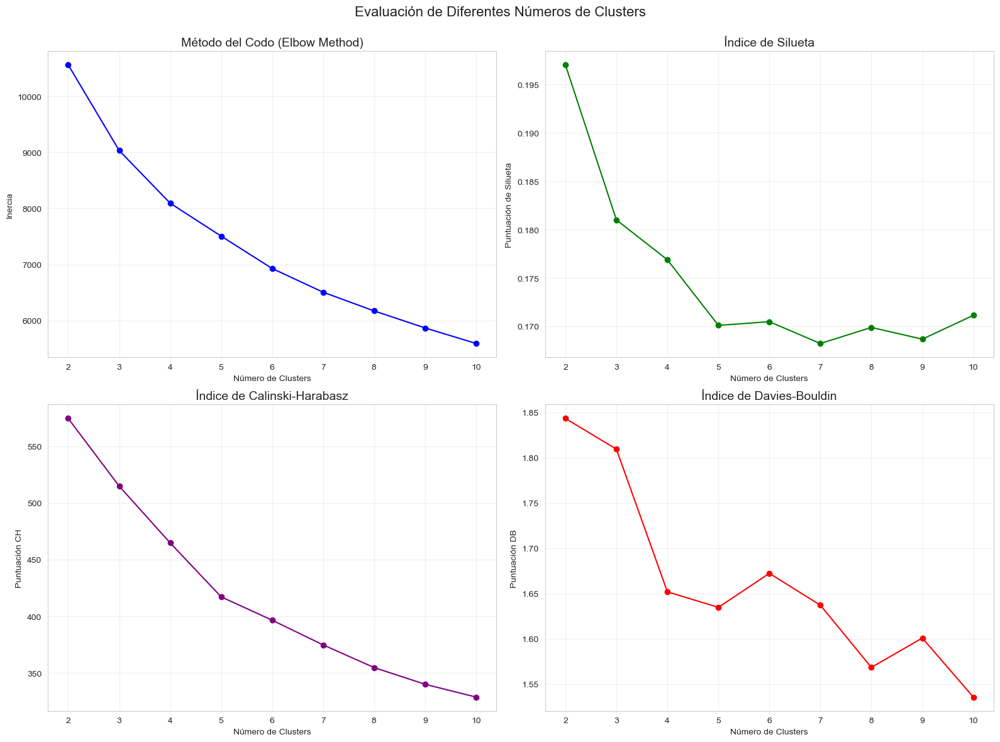


Distribución de tipos de cultivo por cluster (%):


tipoCultivo,Cebada,Maiz,Trigo
Cluster,,,
0,34.8%,32.5%,32.7%
1,30.4%,36.4%,33.2%
2,29.8%,34.8%,35.4%


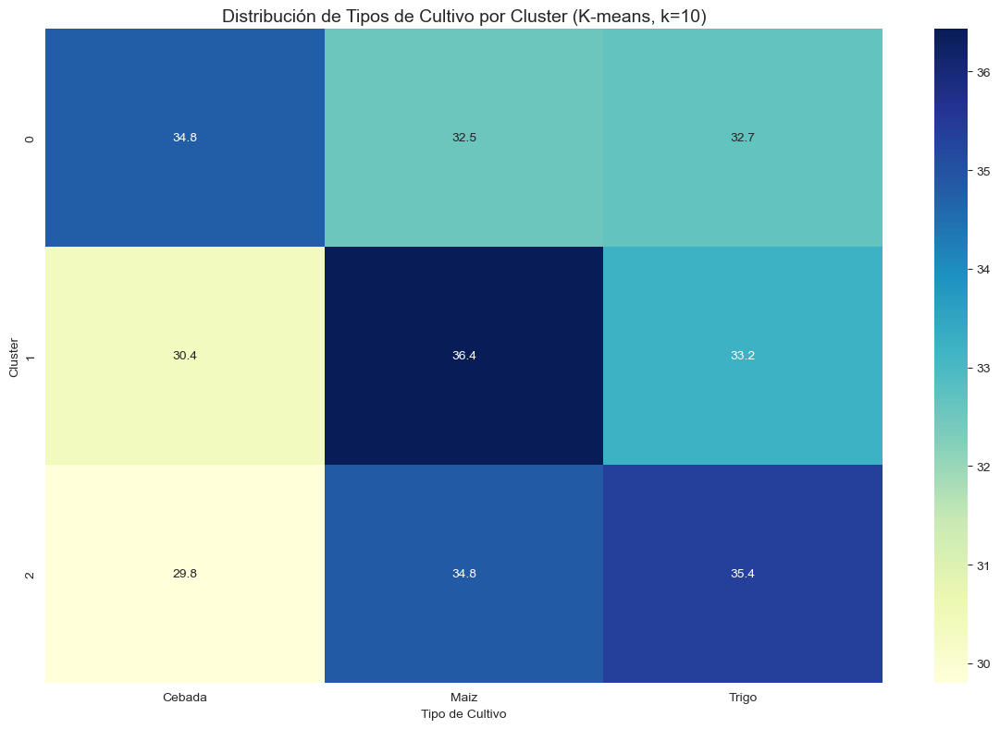

In [43]:
# Aplicar K-means al dataset transformado con PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import pandas as pd
# Removing the gap_statistic import since we're using our own implementation

# Preparar los datos para clustering (sin la columna de etiquetas)
X_for_clustering = X_subset_pca.drop('tipoCultivo', axis=1)

# Definir el rango de clusters a probar
range_n_clusters = range(2, 11)

# Listas para almacenar métricas
inertias = []
silhouette_scores = []
calinski_scores = []
davies_bouldin_scores = []

# Calcular métricas para diferentes números de clusters
for n_clusters in range_n_clusters:
    # Aplicar K-means
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    cluster_labels = kmeans.fit_predict(X_for_clustering)
    
    # Calcular inercia (suma de distancias al cuadrado)
    inertias.append(kmeans.inertia_)
    
    # Calcular índice de silueta
    silhouette_avg = silhouette_score(X_for_clustering, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    
    # Calcular índice de Calinski-Harabasz
    calinski = calinski_harabasz_score(X_for_clustering, cluster_labels)
    calinski_scores.append(calinski)
    
    # Calcular índice de Davies-Bouldin
    davies_bouldin = davies_bouldin_score(X_for_clustering, cluster_labels)
    davies_bouldin_scores.append(davies_bouldin)
    
    print(f"Para n_clusters = {n_clusters}:")
    print(f"  Inercia: {kmeans.inertia_:.2f}")
    print(f"  Índice de silueta: {silhouette_avg:.3f}")
    print(f"  Índice de Calinski-Harabasz: {calinski:.2f}")
    print(f"  Índice de Davies-Bouldin: {davies_bouldin:.3f}")
    print()

# Crear una figura con 4 subplots para visualizar las métricas
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Gráfico de codo (Elbow method)
axes[0, 0].plot(range_n_clusters, inertias, 'o-', color='blue')
axes[0, 0].set_title('Método del Codo (Elbow Method)', fontsize=14)
axes[0, 0].set_xlabel('Número de Clusters')
axes[0, 0].set_ylabel('Inercia')
axes[0, 0].grid(True, alpha=0.3)

# Gráfico de índice de silueta
axes[0, 1].plot(range_n_clusters, silhouette_scores, 'o-', color='green')
axes[0, 1].set_title('Índice de Silueta', fontsize=14)
axes[0, 1].set_xlabel('Número de Clusters')
axes[0, 1].set_ylabel('Puntuación de Silueta')
axes[0, 1].grid(True, alpha=0.3)

# Gráfico de índice de Calinski-Harabasz
axes[1, 0].plot(range_n_clusters, calinski_scores, 'o-', color='purple')
axes[1, 0].set_title('Índice de Calinski-Harabasz', fontsize=14)
axes[1, 0].set_xlabel('Número de Clusters')
axes[1, 0].set_ylabel('Puntuación CH')
axes[1, 0].grid(True, alpha=0.3)

# Gráfico de índice de Davies-Bouldin
axes[1, 1].plot(range_n_clusters, davies_bouldin_scores, 'o-', color='red')
axes[1, 1].set_title('Índice de Davies-Bouldin', fontsize=14)
axes[1, 1].set_xlabel('Número de Clusters')
axes[1, 1].set_ylabel('Puntuación DB')
axes[1, 1].grid(True, alpha=0.3)

plt.suptitle('Evaluación de Diferentes Números de Clusters', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

# Aplicar K-means con el número óptimo de clusters
optimal_kmeans = KMeans(n_clusters=3)
optimal_clusters = optimal_kmeans.fit_predict(X_for_clustering)

# Añadir las etiquetas de cluster al dataframe
X_subset_pca['Cluster'] = optimal_clusters

# Visualizar los clusters en 3D
import plotly.express as px

fig = px.scatter_3d(
    X_subset_pca, 
    x='PC1', 
    y='PC2', 
    z='PC3',
    color='Cluster',
    symbol='tipoCultivo',
    labels={
        'PC1': f'PC1 ({explained_variance[0]:.2%})',
        'PC2': f'PC2 ({explained_variance[1]:.2%})',
        'PC3': f'PC3 ({explained_variance[2]:.2%})'
    },
    title=f'Visualización 3D de Clusters (K-means, k={n_clusters})',
    opacity=0.8
)

fig.update_layout(
    scene=dict(
        xaxis_title=f'PC1 ({explained_variance[0]:.2%})',
        yaxis_title=f'PC2 ({explained_variance[1]:.2%})',
        zaxis_title=f'PC3 ({explained_variance[2]:.2%})'
    ),
    width=900,
    height=700,
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

# Analizar la relación entre clusters y tipos de cultivo
cluster_crop_table = pd.crosstab(
    X_subset_pca['Cluster'], 
    X_subset_pca['tipoCultivo'],
    normalize='index'
) * 100

print("\nDistribución de tipos de cultivo por cluster (%):")
display(cluster_crop_table.style.format("{:.1f}%"))

# Visualizar la distribución de clusters por tipo de cultivo
plt.figure(figsize=(12, 8))
sns.heatmap(cluster_crop_table, annot=True, cmap='YlGnBu', fmt='.1f')
plt.title(f'Distribución de Tipos de Cultivo por Cluster (K-means, k={n_clusters})', fontsize=14)
plt.ylabel('Cluster')
plt.xlabel('Tipo de Cultivo')
plt.tight_layout()
plt.show()

Evaluando diferentes números de clusters con K-means...


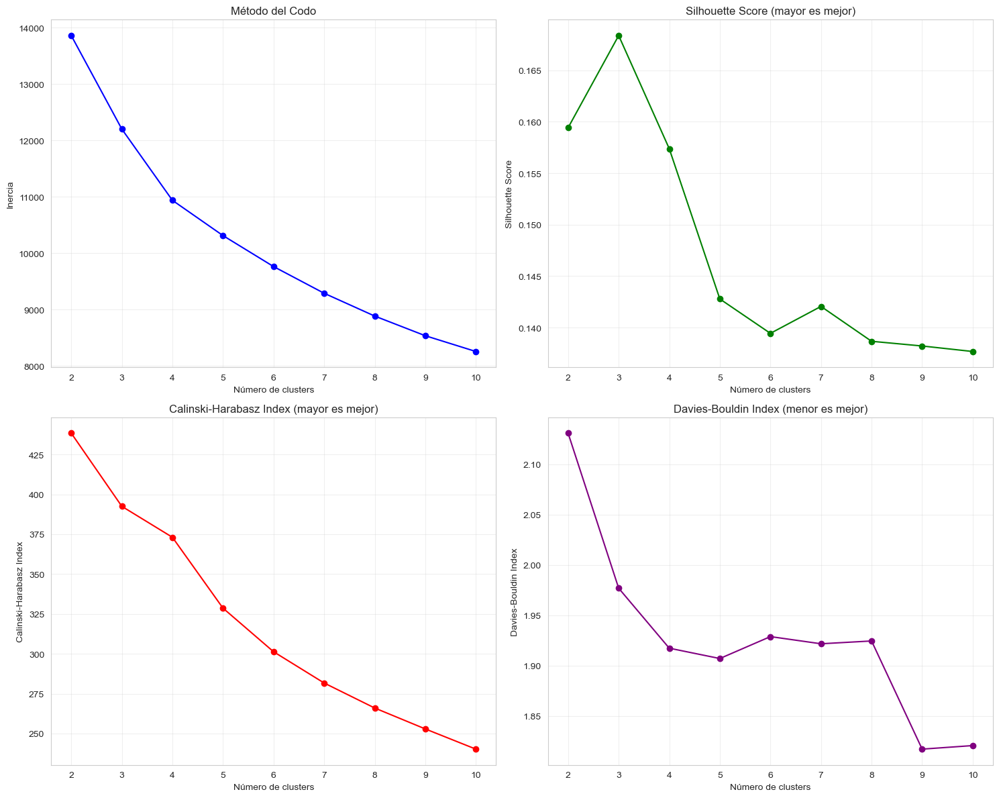

Número óptimo de clusters según Silhouette Score: 3
Número óptimo de clusters según Calinski-Harabasz: 2
Número óptimo de clusters según Davies-Bouldin: 9
Número óptimo de clusters según método del Codo: 3

Número óptimo de clusters (consenso): 3

Visualizando clusters en 3D...


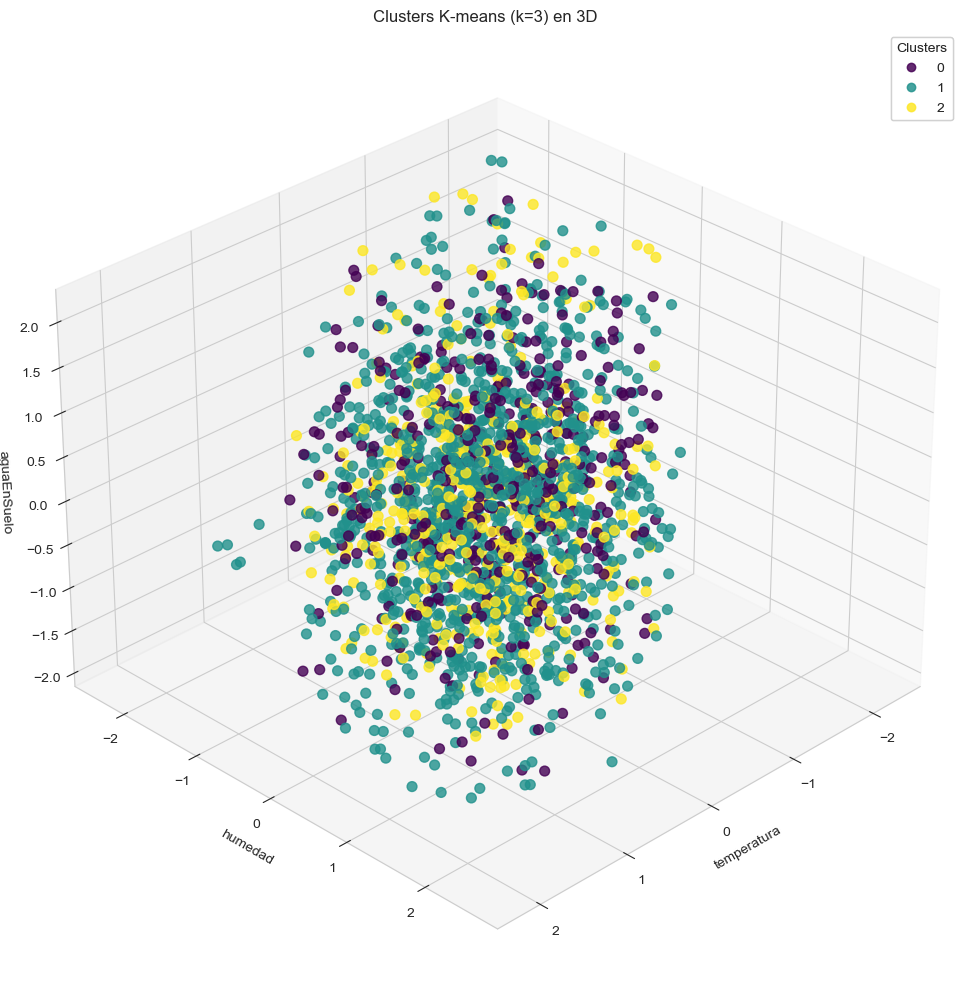


Tabla de contingencia (Clusters vs Tipos de Cultivo):
Tipo de Cultivo  Cebada  Maiz  Trigo
Cluster                             
0                   140   171    141
1                   389   377    416
2                   145   180    159


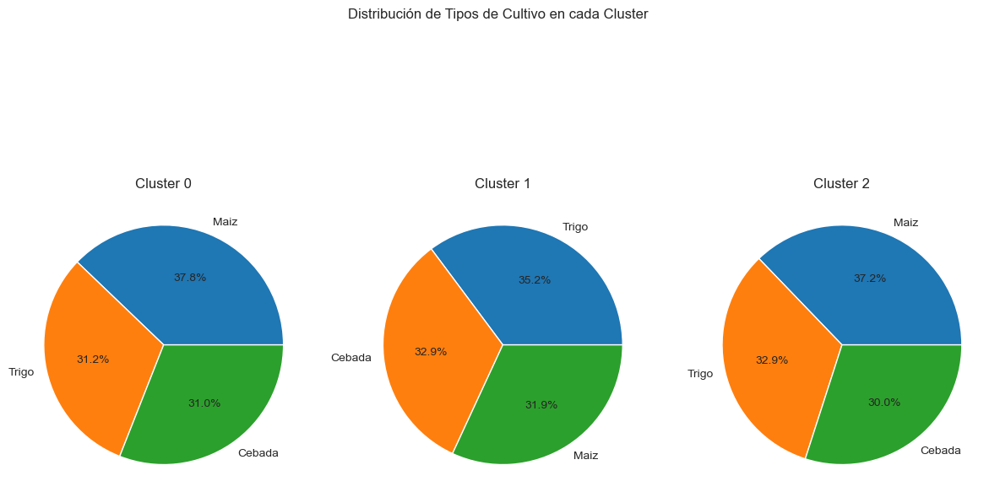

c:\Users\gfrat\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



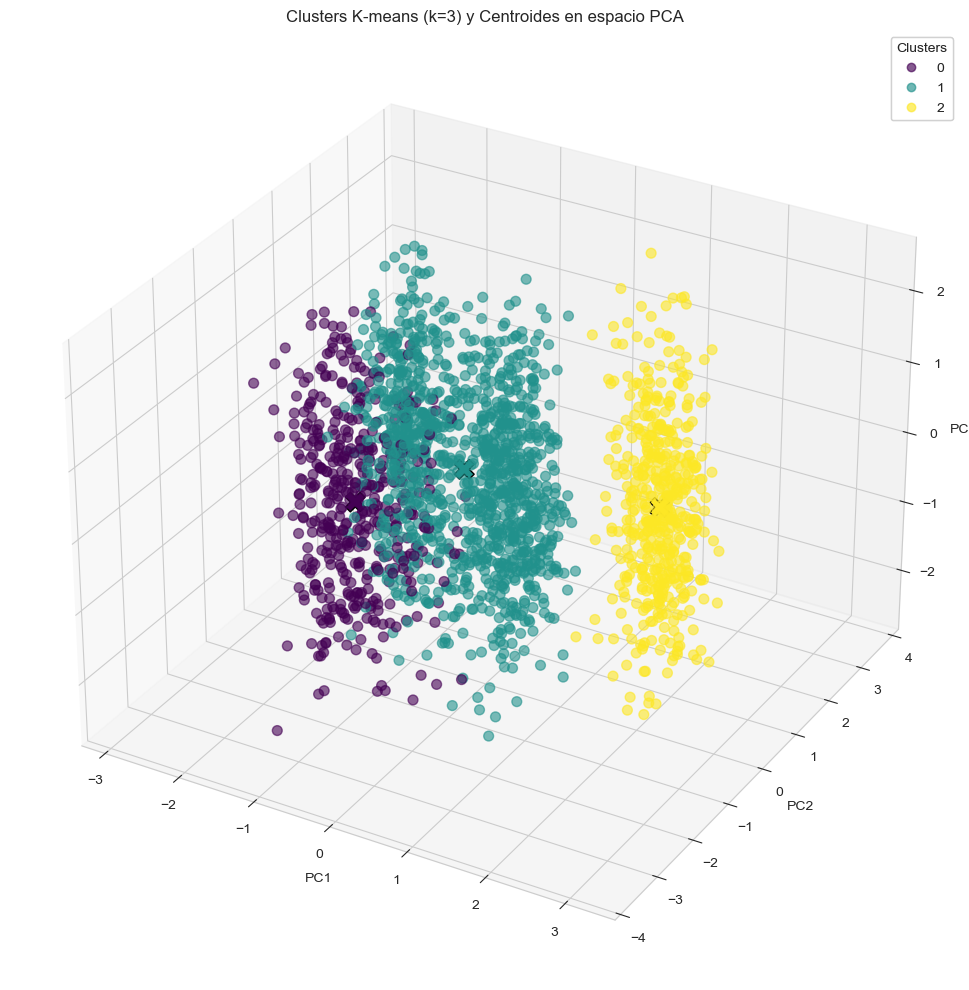

In [44]:
# Aplicar K-means y analizar resultados sin usar gap-stat
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Función para evaluar diferentes números de clusters
def evaluate_kmeans(X, max_clusters=10):
    """
    Evalúa el rendimiento de K-means con diferentes números de clusters
    
    Parámetros:
    -----------
    X : array o DataFrame
        Datos de entrada
    max_clusters : int
        Número máximo de clusters a evaluar
    """
    # Métricas para evaluar
    silhouette_scores = []
    ch_scores = []
    db_scores = []
    inertias = []
    
    # Evaluar diferentes números de clusters
    range_clusters = range(2, max_clusters + 1)
    for n_clusters in range_clusters:
        # Entrenar K-means
        kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(X)
        
        # Calcular métricas
        silhouette_scores.append(silhouette_score(X, cluster_labels))
        ch_scores.append(calinski_harabasz_score(X, cluster_labels))
        db_scores.append(davies_bouldin_score(X, cluster_labels))
        inertias.append(kmeans.inertia_)
    
    # Visualizar resultados
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # Gráfico de codo (Elbow method)
    axes[0, 0].plot(range_clusters, inertias, 'o-', color='blue')
    axes[0, 0].set_xlabel('Número de clusters')
    axes[0, 0].set_ylabel('Inercia')
    axes[0, 0].set_title('Método del Codo')
    axes[0, 0].grid(True, alpha=0.3)
    
    # Silhouette score
    axes[0, 1].plot(range_clusters, silhouette_scores, 'o-', color='green')
    axes[0, 1].set_xlabel('Número de clusters')
    axes[0, 1].set_ylabel('Silhouette Score')
    axes[0, 1].set_title('Silhouette Score (mayor es mejor)')
    axes[0, 1].grid(True, alpha=0.3)
    
    # Calinski-Harabasz Index
    axes[1, 0].plot(range_clusters, ch_scores, 'o-', color='red')
    axes[1, 0].set_xlabel('Número de clusters')
    axes[1, 0].set_ylabel('Calinski-Harabasz Index')
    axes[1, 0].set_title('Calinski-Harabasz Index (mayor es mejor)')
    axes[1, 0].grid(True, alpha=0.3)
    
    # Davies-Bouldin Index
    axes[1, 1].plot(range_clusters, db_scores, 'o-', color='purple')
    axes[1, 1].set_xlabel('Número de clusters')
    axes[1, 1].set_ylabel('Davies-Bouldin Index')
    axes[1, 1].set_title('Davies-Bouldin Index (menor es mejor)')
    axes[1, 1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Determinar el número óptimo de clusters basado en las métricas
    optimal_k_silhouette = np.argmax(silhouette_scores) + 2  # +2 porque empezamos desde 2 clusters
    optimal_k_ch = np.argmax(ch_scores) + 2
    optimal_k_db = np.argmin(db_scores) + 2
    
    # Método del codo (aproximación)
    # Calcular la segunda derivada de la inercia para encontrar el "codo"
    inertia_diff = np.diff(inertias)
    inertia_diff2 = np.diff(inertia_diff)
    optimal_k_elbow = np.argmax(np.abs(inertia_diff2)) + 2  # +2 por el rango y la doble diferenciación
    
    print(f"Número óptimo de clusters según Silhouette Score: {optimal_k_silhouette}")
    print(f"Número óptimo de clusters según Calinski-Harabasz: {optimal_k_ch}")
    print(f"Número óptimo de clusters según Davies-Bouldin: {optimal_k_db}")
    print(f"Número óptimo de clusters según método del Codo: {optimal_k_elbow}")
    
    return {
        'silhouette': silhouette_scores,
        'calinski_harabasz': ch_scores,
        'davies_bouldin': db_scores,
        'inertia': inertias,
        'optimal_k_silhouette': optimal_k_silhouette,
        'optimal_k_ch': optimal_k_ch,
        'optimal_k_db': optimal_k_db,
        'optimal_k_elbow': optimal_k_elbow
    }

# Visualizar clusters en 3D
def visualize_clusters_3d(X, labels, title="Clusters K-means en 3D"):
    """
    Visualiza los clusters en un gráfico 3D
    
    Parámetros:
    -----------
    X : array o DataFrame
        Datos de entrada (debe tener al menos 3 columnas)
    labels : array
        Etiquetas de cluster asignadas por K-means
    title : str
        Título del gráfico
    """
    # Asegurar que tenemos al menos 3 dimensiones
    if X.shape[1] < 3:
        # Si no hay suficientes dimensiones, aplicar PCA para visualización
        pca = PCA(n_components=3)
        X_3d = pca.fit_transform(X)
        x_label = "PC1"
        y_label = "PC2"
        z_label = "PC3"
    else:
        # Usar las primeras 3 columnas
        X_3d = X.iloc[:, :3].values if hasattr(X, 'iloc') else X[:, :3]
        x_label = X.columns[0] if hasattr(X, 'columns') else "Atributo 1"
        y_label = X.columns[1] if hasattr(X, 'columns') else "Atributo 2"
        z_label = X.columns[2] if hasattr(X, 'columns') else "Atributo 3"
    
    # Crear figura 3D
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Graficar puntos coloreados por cluster
    scatter = ax.scatter(
        X_3d[:, 0], X_3d[:, 1], X_3d[:, 2],
        c=labels,
        cmap='viridis',
        s=50,
        alpha=0.8
    )
    
    # Añadir leyenda
    legend1 = ax.legend(*scatter.legend_elements(),
                        title="Clusters")
    ax.add_artist(legend1)
    
    # Etiquetas y título
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    ax.set_zlabel(z_label)
    ax.set_title(title)
    
    # Mejorar visualización
    ax.grid(True, alpha=0.3)
    ax.view_init(elev=30, azim=45)
    
    plt.tight_layout()
    plt.show()
    
    return fig

# Aplicar K-means al dataset escalado
print("Evaluando diferentes números de clusters con K-means...")
metrics = evaluate_kmeans(X_subset_scaled, max_clusters=10)

# Determinar el número óptimo de clusters basado en las métricas
# Podemos usar el promedio de las recomendaciones o elegir una métrica específica
optimal_k_values = [
    metrics['optimal_k_silhouette'],
    metrics['optimal_k_ch'],
    metrics['optimal_k_db'],
    metrics['optimal_k_elbow']
]
optimal_k = int(np.median(optimal_k_values))  # Usar la mediana como consenso
print(f"\nNúmero óptimo de clusters (consenso): {optimal_k}")

# Aplicar K-means con el número óptimo de clusters
kmeans_optimal = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
cluster_labels = kmeans_optimal.fit_predict(X_subset_scaled)

# Visualizar los clusters en 3D
print("\nVisualizando clusters en 3D...")
visualize_clusters_3d(X_subset_scaled, cluster_labels, 
                     title=f"Clusters K-means (k={optimal_k}) en 3D")

# Comparar clusters con las clases reales
comparison_df = pd.DataFrame({
    'Cluster': cluster_labels,
    'Tipo de Cultivo': y_subset
})

# Tabla de contingencia
contingency_table = pd.crosstab(comparison_df['Cluster'], comparison_df['Tipo de Cultivo'])
print("\nTabla de contingencia (Clusters vs Tipos de Cultivo):")
print(contingency_table)

# Visualizar la distribución de clases en cada cluster
plt.figure(figsize=(12, 8))
for i in range(optimal_k):
    plt.subplot(1, optimal_k, i+1)
    cluster_data = comparison_df[comparison_df['Cluster'] == i]['Tipo de Cultivo'].value_counts(normalize=True)
    plt.pie(cluster_data, labels=cluster_data.index, autopct='%1.1f%%')
    plt.title(f'Cluster {i}')

plt.suptitle('Distribución de Tipos de Cultivo en cada Cluster')
plt.tight_layout()
plt.show()

# Visualizar los centroides de los clusters
centroids = kmeans_optimal.cluster_centers_

# Aplicar PCA para visualizar en 3D
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_subset_scaled)
centroids_pca = pca.transform(centroids)

# Graficar datos y centroides en espacio PCA
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Graficar puntos
scatter = ax.scatter(
    X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
    c=cluster_labels,
    cmap='viridis',
    s=50,
    alpha=0.6,
    label='Datos'
)

# Graficar centroides
ax.scatter(
    centroids_pca[:, 0], centroids_pca[:, 1], centroids_pca[:, 2],
    c=range(optimal_k),
    cmap='viridis',
    s=200,
    alpha=1,
    marker='X',
    edgecolors='k',
    label='Centroides'
)

# Etiquetas y título
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title(f'Clusters K-means (k={optimal_k}) y Centroides en espacio PCA')

# Leyenda
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
ax.add_artist(legend1)

plt.tight_layout()
plt.show()

Aplicando clustering jerárquico...


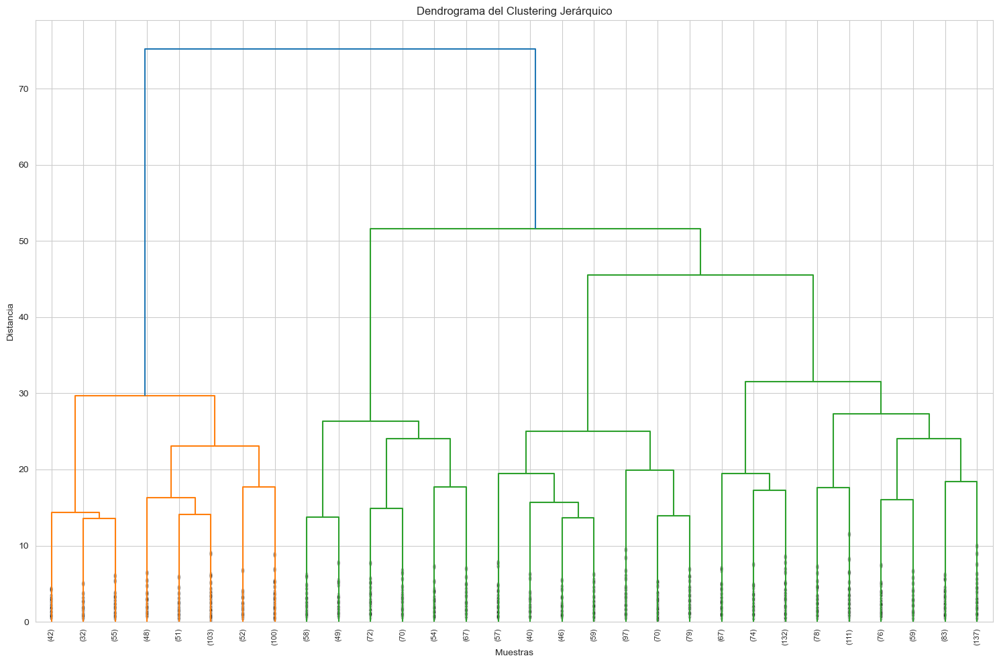

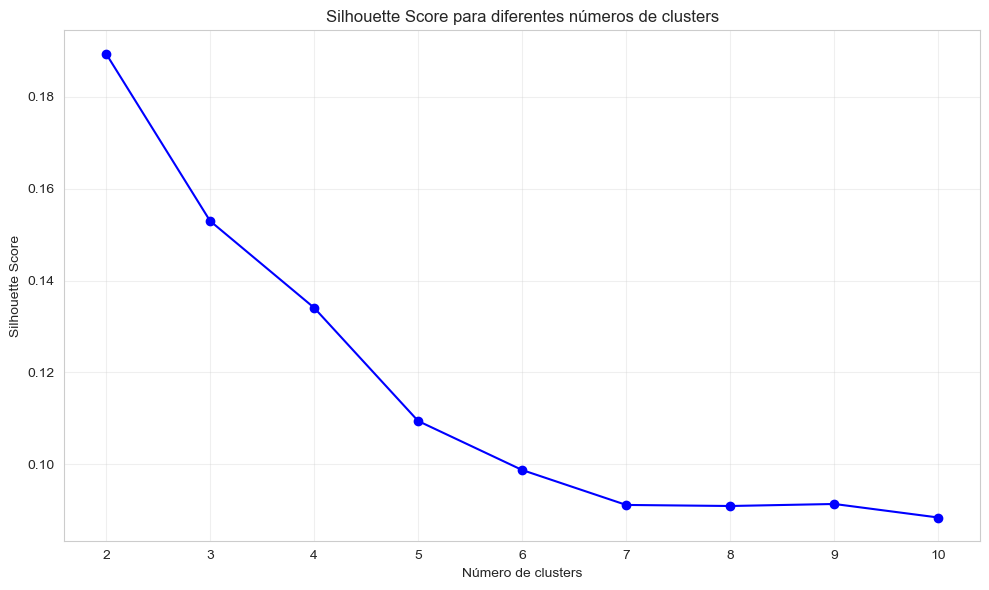

Número óptimo de clusters según Silhouette Score: 2

Visualizando clusters jerárquicos en 3D...


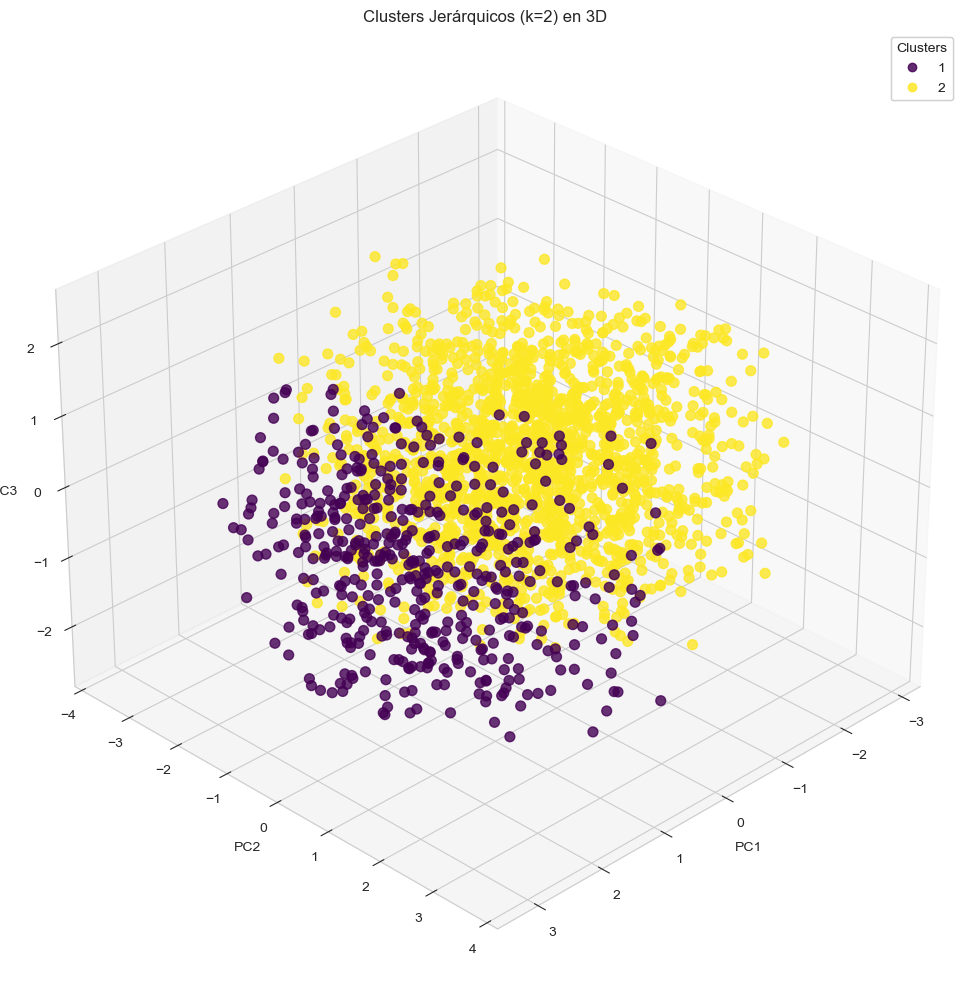


Tabla de contingencia (Clusters vs Tipos de Cultivo):
Tipo de Cultivo  Cebada  Maiz  Trigo
Cluster                             
1                   144   180    159
2                   530   548    557


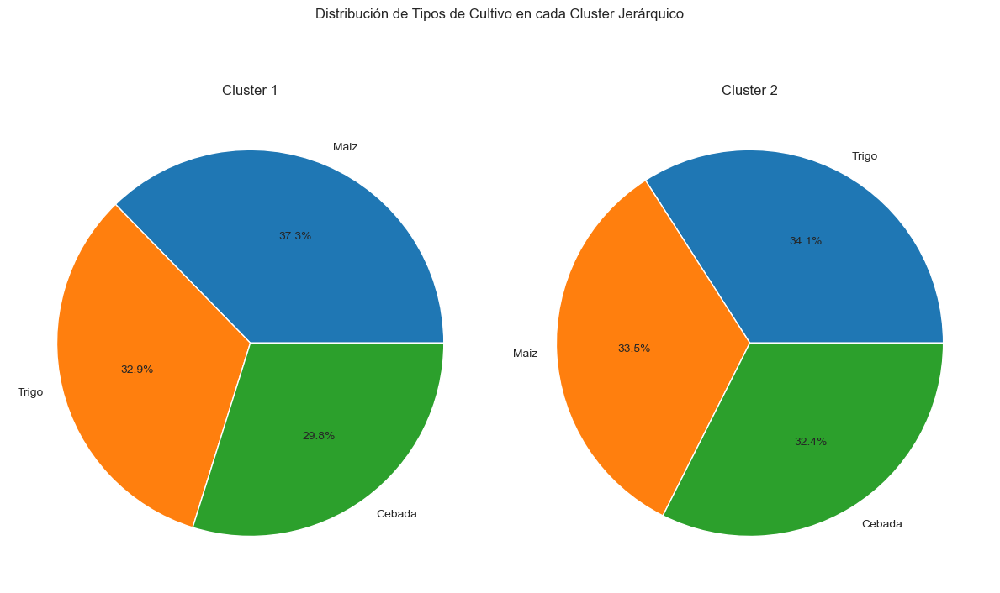


Comparación de métodos de clustering:
Silhouette Score - Clustering Jerárquico: 0.1894
Silhouette Score - K-means: 0.1684


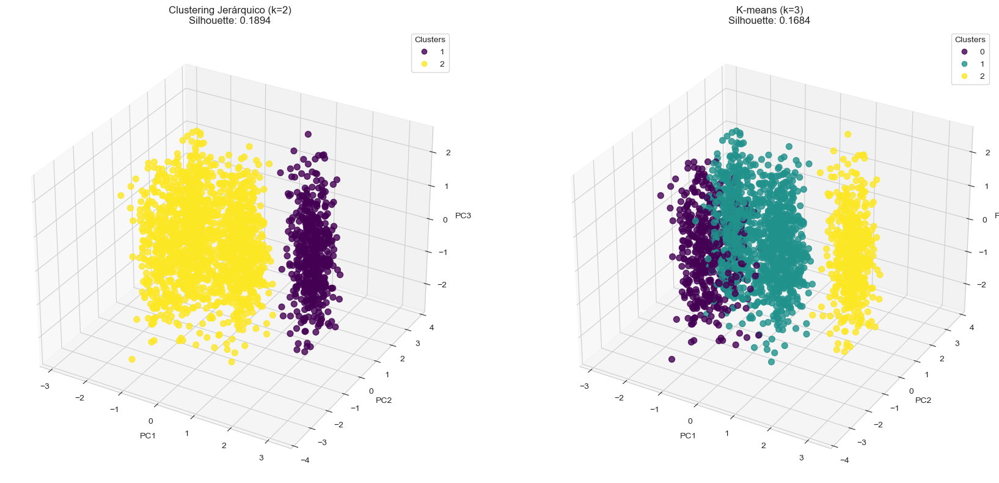

In [45]:
# Aplicar clustering jerárquico
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

# Función para visualizar el dendrograma
def plot_dendrogram(Z, max_d=None, figsize=(12, 8)):
    """
    Visualiza el dendrograma del clustering jerárquico
    
    Parámetros:
    -----------
    Z : array
        Matriz de linkage
    max_d : float, opcional
        Distancia máxima para la línea horizontal
    figsize : tuple, opcional
        Tamaño de la figura
    """
    plt.figure(figsize=figsize)
    plt.title('Dendrograma del Clustering Jerárquico')
    plt.xlabel('Muestras')
    plt.ylabel('Distancia')
    
    # Dibujar el dendrograma
    dendrogram(
        Z,
        leaf_rotation=90.,  # Rotar las etiquetas de las hojas
        leaf_font_size=8.,  # Tamaño de fuente para las etiquetas
        truncate_mode='lastp',  # Mostrar solo los últimos p clusters
        p=30,  # Mostrar solo los últimos 30 clusters
        show_contracted=True,  # Mostrar nodos contraídos como elipses
    )
    
    if max_d:
        plt.axhline(y=max_d, c='k', linestyle='--', label=f'Distancia de corte: {max_d:.2f}')
        plt.legend()
    
    plt.tight_layout()
    plt.show()

# Función para evaluar diferentes números de clusters con silhouette score
def evaluate_hierarchical_clusters(X, Z, max_clusters=10):
    """
    Evalúa diferentes números de clusters para clustering jerárquico
    
    Parámetros:
    -----------
    X : array o DataFrame
        Datos de entrada
    Z : array
        Matriz de linkage
    max_clusters : int
        Número máximo de clusters a evaluar
    """
    silhouette_scores = []
    
    # Evaluar diferentes números de clusters
    range_clusters = range(2, max_clusters + 1)
    for n_clusters in range_clusters:
        # Obtener las etiquetas de cluster
        labels = fcluster(Z, n_clusters, criterion='maxclust')
        
        # Calcular el silhouette score
        silhouette_avg = silhouette_score(X, labels)
        silhouette_scores.append(silhouette_avg)
    
    # Visualizar los resultados
    plt.figure(figsize=(10, 6))
    plt.plot(range_clusters, silhouette_scores, 'o-', color='blue')
    plt.xlabel('Número de clusters')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score para diferentes números de clusters')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Determinar el número óptimo de clusters
    optimal_k = np.argmax(silhouette_scores) + 2  # +2 porque empezamos desde 2 clusters
    print(f"Número óptimo de clusters según Silhouette Score: {optimal_k}")
    
    return {
        'silhouette': silhouette_scores,
        'optimal_k': optimal_k
    }

# Función para visualizar clusters en 3D
def visualize_hierarchical_clusters_3d(X, labels, title="Clusters Jerárquicos en 3D"):
    """
    Visualiza los clusters jerárquicos en un gráfico 3D
    
    Parámetros:
    -----------
    X : array o DataFrame
        Datos de entrada (debe tener al menos 3 columnas)
    labels : array
        Etiquetas de cluster
    title : str
        Título del gráfico
    """
    # Aplicar PCA para visualización en 3D
    from sklearn.decomposition import PCA
    pca = PCA(n_components=3)
    X_3d = pca.fit_transform(X)
    
    # Crear figura 3D
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Graficar puntos coloreados por cluster
    scatter = ax.scatter(
        X_3d[:, 0], X_3d[:, 1], X_3d[:, 2],
        c=labels,
        cmap='viridis',
        s=50,
        alpha=0.8
    )
    
    # Añadir leyenda
    legend1 = ax.legend(*scatter.legend_elements(),
                        title="Clusters")
    ax.add_artist(legend1)
    
    # Etiquetas y título
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    ax.set_title(title)
    
    # Mejorar visualización
    ax.grid(True, alpha=0.3)
    ax.view_init(elev=30, azim=45)
    
    plt.tight_layout()
    plt.show()
    
    return fig

# Aplicar clustering jerárquico al dataset escalado
print("Aplicando clustering jerárquico...")

# Calcular la matriz de linkage (usando el método 'ward')
Z = linkage(X_subset_scaled, method='ward')

# Visualizar el dendrograma
plot_dendrogram(Z, figsize=(15, 10))

# Evaluar diferentes números de clusters
metrics = evaluate_hierarchical_clusters(X_subset_scaled, Z, max_clusters=10)

# Obtener el número óptimo de clusters
optimal_k = metrics['optimal_k']

# Obtener las etiquetas de cluster con el número óptimo
hierarchical_labels = fcluster(Z, optimal_k, criterion='maxclust')

# Visualizar los clusters en 3D
print("\nVisualizando clusters jerárquicos en 3D...")
visualize_hierarchical_clusters_3d(X_subset_scaled, hierarchical_labels, 
                                 title=f"Clusters Jerárquicos (k={optimal_k}) en 3D")

# Comparar clusters con las clases reales
comparison_df = pd.DataFrame({
    'Cluster': hierarchical_labels,
    'Tipo de Cultivo': y_subset
})

# Tabla de contingencia
contingency_table = pd.crosstab(comparison_df['Cluster'], comparison_df['Tipo de Cultivo'])
print("\nTabla de contingencia (Clusters vs Tipos de Cultivo):")
print(contingency_table)

# Visualizar la distribución de clases en cada cluster
plt.figure(figsize=(12, 8))
for i in range(1, optimal_k + 1):  # Nota: los clusters jerárquicos empiezan desde 1, no desde 0
    plt.subplot(1, optimal_k, i)
    cluster_data = comparison_df[comparison_df['Cluster'] == i]['Tipo de Cultivo'].value_counts(normalize=True)
    plt.pie(cluster_data, labels=cluster_data.index, autopct='%1.1f%%')
    plt.title(f'Cluster {i}')

plt.suptitle('Distribución de Tipos de Cultivo en cada Cluster Jerárquico')
plt.tight_layout()
plt.show()

# Comparar clustering jerárquico con K-means
from sklearn.cluster import KMeans

# Aplicar K-means con el mismo número de clusters
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
kmeans_labels = kmeans.fit_predict(X_subset_scaled)

# Calcular el silhouette score para ambos métodos
silhouette_hierarchical = silhouette_score(X_subset_scaled, hierarchical_labels)
silhouette_kmeans = silhouette_score(X_subset_scaled, kmeans_labels)

print(f"\nComparación de métodos de clustering:")
print(f"Silhouette Score - Clustering Jerárquico: {silhouette_hierarchical:.4f}")
print(f"Silhouette Score - K-means: {silhouette_kmeans:.4f}")

# Visualizar ambos resultados en un gráfico 3D comparativo
fig = plt.figure(figsize=(18, 8))

# Clustering Jerárquico
ax1 = fig.add_subplot(121, projection='3d')
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_subset_scaled)

scatter1 = ax1.scatter(
    X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
    c=hierarchical_labels,
    cmap='viridis',
    s=50,
    alpha=0.8
)
ax1.set_title(f'Clustering Jerárquico (k={optimal_k})\nSilhouette: {silhouette_hierarchical:.4f}')
ax1.set_xlabel('PC1')
ax1.set_ylabel('PC2')
ax1.set_zlabel('PC3')
ax1.legend(*scatter1.legend_elements(), title="Clusters")

# K-means
ax2 = fig.add_subplot(122, projection='3d')
scatter2 = ax2.scatter(
    X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
    c=kmeans_labels,
    cmap='viridis',
    s=50,
    alpha=0.8
)
ax2.set_title(f'K-means (k=3)\nSilhouette: {silhouette_kmeans:.4f}')
ax2.set_xlabel('PC1')
ax2.set_ylabel('PC2')
ax2.set_zlabel('PC3')
ax2.legend(*scatter2.legend_elements(), title="Clusters")

plt.tight_layout()
plt.show()